<hr style="height:2px;border:none"/>
<h1 align='center'> <img src="http://www.exalumnos.usm.cl/wp-content/uploads/2015/06/Isotipo-Negro.gif" title="Title text" width="20%" height="20%" />

INF-395 / 477 / 577 Tarea 1 Redes Neuronales Artificiales - 2020-1 </h1>

<H3 align='center'> Integrantes: Kevin Lagos - Andrés Navarro </H3>
<hr style="height:2px;border:none"/>

**Temas**  
* Manipulaciones en tensorflow, keras, pandas y numpy
* Redes Densas Feed Forward
* Regularización y Dropout
* Exploding & Vanishing Gradient
* Skip Connections
* Learn Rate Decay
* Optimizadores
* Redes Convolucionales
* Image Data Augmentation
* Interpretabilidad CNNs


**Formalidades**  
* Equipos de trabajo de 2 personas (*Ambos estudiantes deben estar preparados para presentar la tarea el día de la entrega*)
* El entregable debe ser un _Jupyter Notebook_ incluyendo los códigos utilizados, los resultados, los gráficos realizados y comentarios. Debe seguir una estructura similar a un informe (se debe introducir los problemas a trabajar, presentar los resultados y discutirlos). Si lo prefiere puede entregar un _Jupyter Notebook_ por pregunta o uno para toda la tarea, con tal de que todos los entregables estén bien identificados y se encuentren en el mismo repositorio de _Github_.
* Se debe preparar una presentación del trabajo realizado y sus hallazgos. El presentador será elegido aleatoriamente y deberá apoyarse en el _Jupyter Notebook_ que entregarán. 
* Formato de entrega: envı́o de link del repositorio en _Github_ ( en caso de ser repositorio privado, invitar como colaborador al usuario de github "Aerlio") al correo electrónico del ayudante (*<tomas.ochoa.14@sansano.usm.cl>*), en copia al profesor (*<cvalle@inf.utfsm.cl>*). Especificar el siguiente asunto: [INF395/477/577-2020 Tarea1]
* Fecha de entrega y presentaciones: 13 de Noviembre. Hora límite de entrega: 23:00. Cualquier _commit_ luego de la hora límite no será evaluado. Se realizará descuento por atrasos en envío del mail. 

<hr style="height:2px;border:none"/>

La tarea se divide en tres partes:

[1.](#primero) Conceptos básicos de redes neuronales  <br>
[2.](#segundo) Reconocimiento de lenguaje de señas <br>
[3.](#tercero) Interpretabilidad de CNNs, transfer learning, y skip connections <br>

La tarea tiene ejemplos de códigos con los cuales pueden guiarse en gran parte, sin embargo solo son guías y pueden ser creativos al momento de resolver la tarea. Soluciones creativas o elegantes serán valoradas. También en algunas ocaciones se hacen elecciones arbitrarias, ustedes pueden realizar otras elecciones con tal de que haya una pequeña justificación de por qué su elección es mejor o equivalente.
Recuerden intercalar su código con comentarios y con celdas _Markdown_ con los comentarios de la pregunta y con cualquier analisis, fórmula o explicación que les parezca relevante para justificar sus procedimientos. 
Noten que en general cuando se les pide elegir algo o proponer algo no se evaluará mucho la elección en si, en cambio la argumentación detrás de la elección será lo más ponderado.

**Es ÁLTAMENTE recomendado realizar esta tarea en _Colab_ de Google (https://colab.research.google.com/notebooks/intro.ipynb#recent=true), con el fin de no depender del rendimiento de su computador personal al momento de entrenar redes neuronales y poder compartir de forma fácil sus avances con su compañer@ de trabajo.** Si bien conlleva sus pros y contras utilizar _Colab_ , existirá una curva de aprendizaje personal que lo ayudará a sacar el mayor provecho a esta herramienta, por ejemplo aprendiendo a guardar los avances realizados, evitando tener que ejecutar todo el código cada vez que se abra _Colab_ . *Tip: Una vez abierto un notebook en _Colab_ ir a **entorno de ejecución**->**Cambiar tipo de entorno de ejecución**, y seleccionár TPU como acelerador por hardware para redes feedforward y GPU para redes convolucionales.*.

# 1. Conceptos básicos de redes neuronales

De las redes neuronales artificiales más simples se encuentran las redes densas o _Feed Forward_, donde todas las neuronas de una capa están conectadas a todas las salidas de la capa anterior y envían su señal de activación a todas las neuronas de la siguiente capa. Estas redes, si bien son las más simples, suelen tener desempeños bastante buenos, y en muchas aplicaciones reales son utilizadas, ya sea por si solas o en combinación con otros modelos. Además, son las redes donde más fácil se pueden observar muchos de los fenómenos que se han descubierto a lo largo de los años de desarrollo de esta área del conocimiento, tanto por ser de las redes vigentes más antiguas y por su estructura relativamente simple. En esta primera parte de la tarea exploraremos las redes densas y algunos de sus hiperparámetros más relevantes como la profundidad, el número de unidades, learning rate, etc...; estudiaremos también algunos métodos de regularización y evidenciaremos el problema del _vanishing gradient y el _exploding gradient_, viendo también algunos optimizadores existentes.


<h1 align='center'> <img src="https://images.fineartamerica.com/images/artworkimages/mediumlarge/1/water-flea-daphnia-magna-ted-kinsman.jpg" width="40%" height="30%" /> </h1>

Para realizar esto usaremos un problema de regresión sencillo y utilizaremos los paquetes tensorflow y keras para explorar los conceptos básicos del mundo de las redes neuronales artificiales. Dado que puede tomar tiempo entrenar redes neuronales, y existe una amplia gama de conceptos a cubrir, utilizaremos un dataset de tamaño limitado con menos de 1000 observaciones, recordar que las redes neuronales tienen una naturaleza _data hungry_ por lo que su desempeño se puede ver limitado por la poca cantidad de observaciones en algunos casos. El dataset en cuestión consiste de 8 atributos (descriptores moleculares) de 546 productos químicos usados para predecir la toxicidad acuática aguda hacia la especie Daphnia Magna, para su descarga y descripción más detallada: https://archive.ics.uci.edu/ml/datasets/QSAR+aquatic+toxicity.

## 1.a Carga de datos y preprocesamiento.

##### I) Partiremos cargando los datos. 

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from google.colab import files
import io
uploaded = files.upload()
header_list = ["TPSA","SAacc","H-050","MLOPG","RDCHI","GATS1p","nN","C-050","LC50-response"]
df2 = pd.read_csv(io.BytesIO(uploaded['qsar_aquatic_toxicity.csv']),names=header_list,sep=";")

Saving qsar_aquatic_toxicity.csv to qsar_aquatic_toxicity.csv


##### II) **Comente y visualice** las distribuciones de cada atributo del dataset utilizando herramientas estadísticas básicas, boxplots e histogramas.

In [ ]:
df2.describe()

,TPSA,SAacc,H-050,MLOPG,RDCHI,GATS1p,nN,C-050,LC50-response
count,546.000000,546.000000,546.000000,546.000000,546.000000,546.000000,546.000000,546.000000,546.000000
mean,48.472930,58.869018,0.937729,2.313493,2.492299,1.046264,1.003663,0.353480,4.658421
std,46.763983,68.166554,1.618632,1.741797,0.811004,0.403677,1.397240,0.806827,1.665215
min,0.000000,0.000000,0.000000,-6.446000,1.000000,0.281000,0.000000,0.000000,0.122000
25%,15.790000,11.000000,0.000000,1.232500,1.975000,0.737000,0.000000,0.000000,3.601500
50%,40.460000,42.683000,0.000000,2.273500,2.344000,1.020500,1.000000,0.000000,4.516000
75%,70.022500,77.492750,1.000000,3.392750,2.911000,1.266500,2.000000,0.000000,5.607500
max,347.320000,571.952000,18.000000,9.148000,6.439000,2.500000,11.000000,11.000000,10.047000


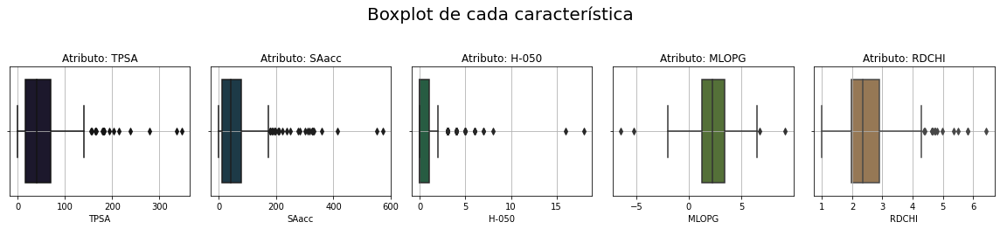

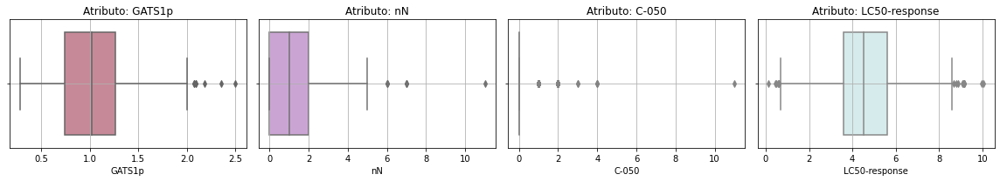

In [ ]:
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize']=[16,3] # <- Controla el tamaño del plot dentro del Notebook
import seaborn as sns  # <- Herramienta complementaria para distintos tipos de plots
cols=sns.color_palette("cubehelix", 9) # <-Paleta de colores a utilizar 9 es el número de colores que componen la paleta
plt.suptitle('Boxplot de cada característica',size=20,y=1.2)
k,K=1,1
for i in df2.columns[:]:
  if K<=5: plt.subplot(1,5,k)
  else: plt.subplot(1,4,k)
  plt.title('Atributo: '+str(i))
  sns.boxplot(df2[i],color=cols[K-1])
  plt.tight_layout()
  plt.grid()
  if k==5:
      k=1
      K+=1
      plt.show()
  else:
      k+=1
      K+=1

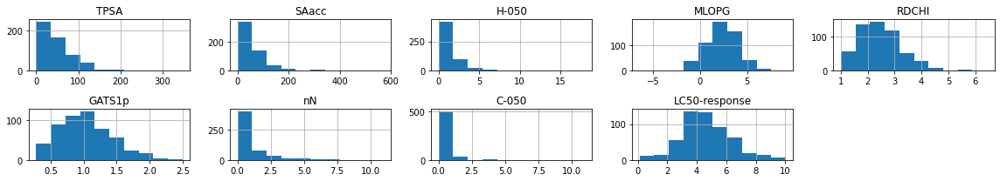

In [ ]:
df2.hist(layout=(2,5))
plt.tight_layout()
plt.show()

# Comentarios al respecto

* TPSA:

  A partir de la información del histograma y el boxplot podemos dar cuenta que la mayoria de los valores se encuentran en valores entre 0 y 70 (aproximadamente), teniendo el 75% de los datos. Además se puede ver que estos se concentran cerca del 0 y disminuyendo progresivamente hacia valores positivos, llegando a obtener datos considerados como outliers en el extremo derecho.

* SAcc:

  Al igual que TPSA, este atributo presenta sus datos concentrados en valores cercanos al cero, que disminuye a medida que se avanza a valores mayores. El 75% de los datos se encuentra en valores menores a 100, siendo el primer cuartil muy pequeño. Además se presenta una gran cantidad de outliers.

* H-050:

  Este atributo presenta un comportamiento similar a los anteriores, solo que con una escala menor, ya que los datos presentan un rango de 0 a 20 aproximadamente. Sin embargo, su distribución es mas marcada, ya que como se puede ver en el boxplot, el primer cuartil y segundo cuartil no parecen tomar distancia del tercero, indicando se que concentran en valores pequeños, además, se puede ver que el 75% de los datos son menores a 1. 

* MLOPG:

  Este atributo presenta una distribución normal, centrada en un valor entre 2 y 3, teniendo un cuartil 2 y 3 bastante concentrado. Este atributo toma valores negativos y concentra la mayoría de sus valores en el rango de -2 a 6 (aproximadamente). Además, es el único atributo que toma valores negativos.


* RDCHI:

  Este atributo presenta una distribución similar a una gamma con parámetros k = 5 y theta = 1, con una media en un valor cercano a 2.5, por lo que posee una mayor dispersión a la derecha, lo que se puede ver en el rango del primer cuartil, frente al cuarto y la presencia de outliers luego de este. Los cuartiles 2 y 3 concentran los valores en un rango de 2 a 3 aproximadamente.



* GATS1p:

  Este atributo presenta una distribución similar a una gamma con parámetros k = 5 y theta = 1, con una media en un valor cercano a 1. Así esta pose una mayor dispersión a la derecha, lo que se puede ver en el rango del cuarto cuartil y la presencia de outliers.

* nN:

  Esta concentra sus valores cerca del cero y disminuyen hacia valores positivos. Esto se puede ver ya el primer cuartil no toma distancia del segundo, lo que implica que muchos valores son prácticamente cero. El 75% de los valores son menores a 2 y se presentan unos cuantos outliers.

* C-050:

  En este atributo casi la totalidad de los valores estan concentrados en cero, teniendo una pequeña cantidad de valores positivos como outliers.

* LC50-response:

  Este atributo presenta una distribución normal centrada en un valor entre 4 y 5. Los cuartiles 2 y 3 visualmente presentan una anchura similar, en cambio, el cuartil 4 posee una anchura mayor al uno. Se presentan outliers a ambos lados del boxplot.

##### III) **Separe** el dataset en conjuntos de entrenamiento, validación y test, para luego estandarizar, considere un 70% de los datos para entrenamiento, un 20% para validación y un 10% para test. Para esto puede utilizar la librería sklearn, en particular las funciones StandarScaler y train_test_split. **Verifique** que el tamaño de los conjuntos se asemeje al indicado. 

**Pregunta:** ¿Cuál es la función de cada uno de estos conjuntos?

Para aclarar conceptos acerca de estos conjuntos: https://towardsdatascience.com/train-validation-and-test-sets-72cb40cba9e7

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
x=df2.drop(columns=['LC50-response'])
y=np.asarray(df2['LC50-response']).reshape(-1,1)
x_tr, x_test, y_tr, y_test  = train_test_split(x, y, test_size=0.1, shuffle=True)
tamanioTotal = len(x_tr) + len(x_test)
x_tr, x_val, y_tr, y_val = train_test_split(x_tr, y_tr, test_size=0.2/0.9, shuffle=True)

print("Tamaño entrenamiento: " + str(round(len(x_tr)*100/tamanioTotal)) + "%")
print("Tamaño test: " + str(round(len(x_test)*100/tamanioTotal)) + "%")
print("Tamaño validación: " + str(round(len(x_val)*100/tamanioTotal)) + "%")

Tamaño entrenamiento: 70%
Tamaño test: 10%
Tamaño validación: 20%


In [ ]:
x_tr_old = np.copy(x_tr)
x_val_old = np.copy(x_val)
x_test_old = np.copy(x_test)
y_tr_old = np.copy(y_tr)
y_val_old = np.copy(y_val)
y_test_old = np.copy(y_test)

scaler_x = StandardScaler()
scaler_x.fit(x_tr)
x_tr = scaler_x.transform(x_tr)
x_val = scaler_x.transform(x_val)
x_test = scaler_x.transform(x_test)
scaler_y = StandardScaler()
scaler_y.fit(y_tr.reshape(-1,1))
y_tr = scaler_y.transform(y_tr)
y_val = scaler_y.transform(y_val)
y_test = scaler_y.transform(y_test)

# Respuesta
* **Conjunto de entrenamiento: ** Es el conjunto con el cual se entrena el modelo de nuestra red neuronal, donde el modelo ve y aprende de esta data.
* **Conjunto de validación: ** Este conjunto se utiliza para obtener una evaluación imparcial del ajuste de un modelo respecto al conjunto de datos de entrenamiento para también afinar los hiperparámetros del modelo.
* **Conjunto de test: ** Este conjunto de datos es utilizado en el momento en que el modelo ya está completamente entrenado, en el cual se calcula el rendimiento de este modelo entrenado frente a datos nuevos.


##### IV) **Visualice** de la forma que estime conveniente para realizar comparaciones, las distribuciones para todas las variables (atributos y target) antes de estandarizar, y después de estandarizar para los conjuntos de entrenamiento, validación y test. **Comente**. 

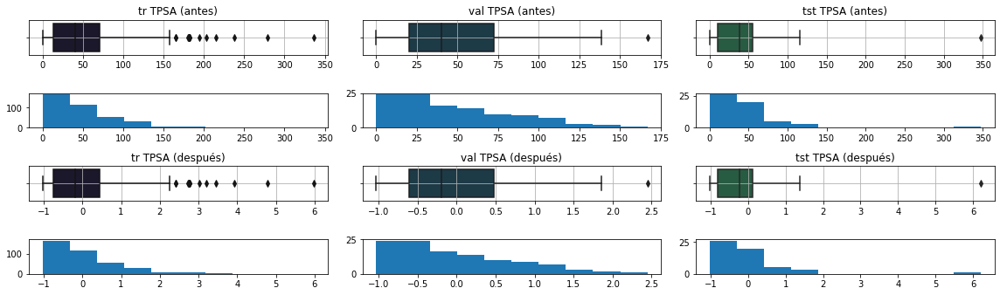

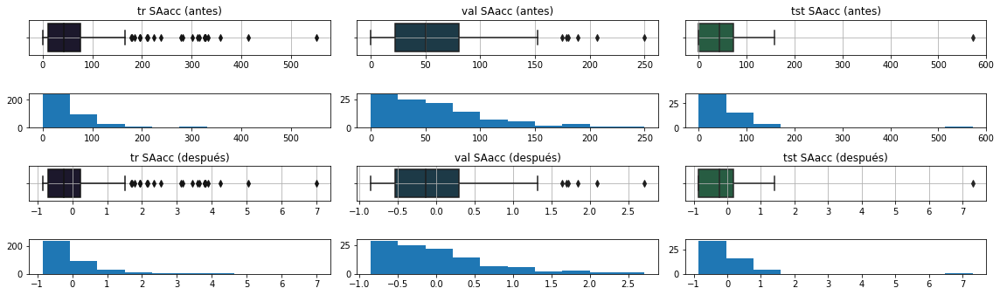

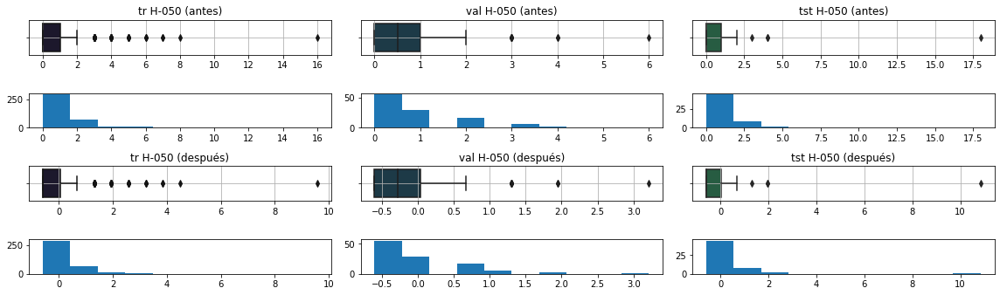

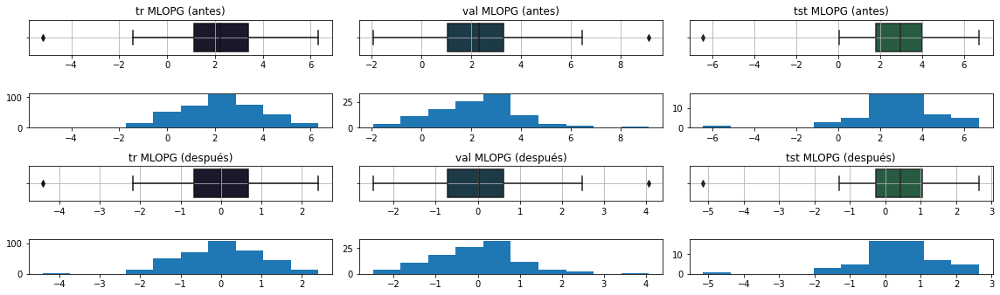

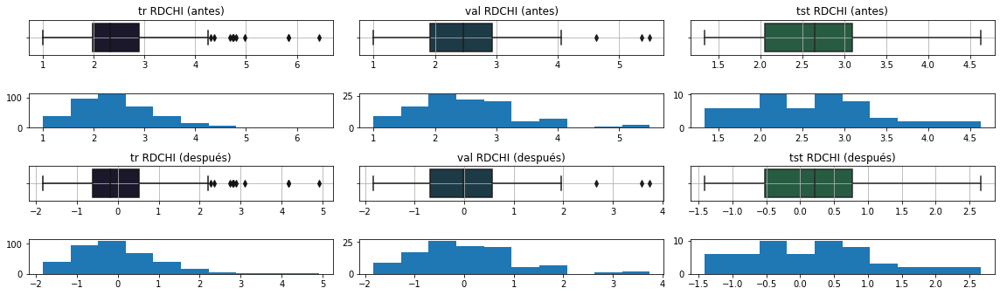

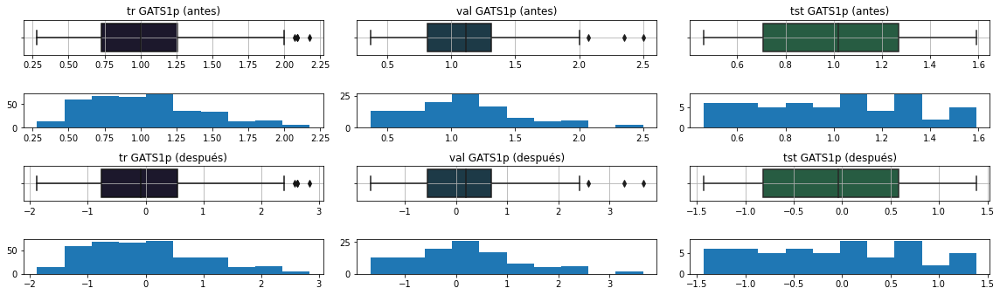

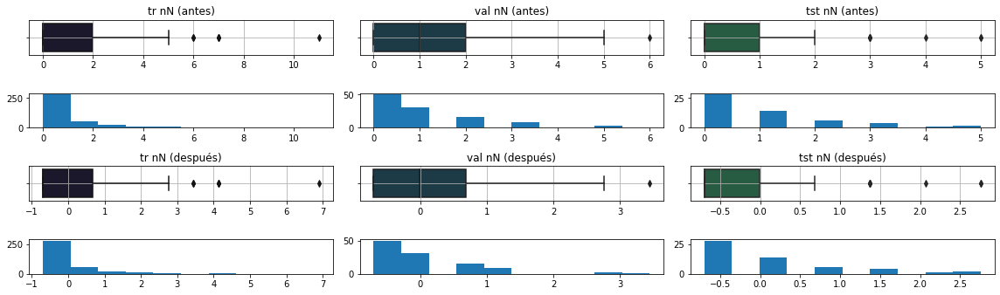

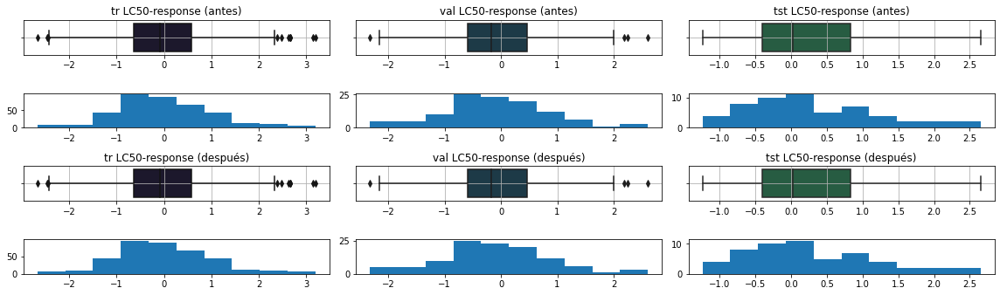

In [ ]:
import warnings; warnings.simplefilter('ignore')

conjuntos = ["tr", "val", "tst"]
for j in range(7): # <- completar
  vars=[x_tr[:,j],x_val[:,j],x_test[:,j]]
  vars_old = [x_tr_old[:,j],x_val_old[:,j],x_test_old[:,j]]
  plt.rcParams["figure.figsize"]=[16,4.8]
  for k in range(3):
    axs = plt.subplot(4,3,k+1)
    axs.set_title(conjuntos[k] +" " +  df2.columns[j] + " (antes)")  
    sns.boxplot(vars_old[k],color=cols[k]) # <- completar puede usar boxplot, histogramas u otra herramienta
    plt.tight_layout()
    plt.grid()
    plt.subplot(4, 3, 4+k)
    plt.hist(vars_old[k])
    axs = plt.subplot(4,3,7+k)
    axs.set_title(conjuntos[k] +" " +  df2.columns[j] + " (después)")  
    sns.boxplot(vars[k],color=cols[k]) # <- completar puede usar boxplot, histogramas u otra herramienta
    plt.tight_layout()
    plt.grid()
    plt.subplot(4, 3, 10+k)
    plt.hist(vars[k])
  plt.show()

vars = [y_tr,y_val,y_test]
vars_old = [y_tr_old,y_val_old,y_test_old]
for k in range(3):
    plt.subplot(4,3,k+1)
    plt.title(conjuntos[k] + " LC50-response (antes)") # <- completar
    sns.boxplot(vars[k],color=cols[k]) # <- completar puede usar boxplot, histogramas u otra herramienta
    plt.tight_layout()
    plt.grid()
    plt.subplot(4, 3, 4+k)
    plt.hist(vars[k])
    plt.subplot(4,3,7+k)
    plt.title(conjuntos[k] + " LC50-response (después)") # <- completar
    sns.boxplot(vars[k],color=cols[k]) # <- completar puede usar boxplot, histogramas u otra herramienta
    plt.tight_layout()
    plt.grid()
    plt.subplot(4, 3, 10+k)
    plt.hist(vars[k])
plt.show()

Para los atributos y el target se aplicó la función StandardScaler(), que estandariza los datos que se nos otorgaron. Para todos los atributos se puede ver que la "forma" que presentan es la misma, tanto en el histograma como en el boxplot, solo que cambió la escala. Esto se puede ver, por ejemplo, en TPSA, dónde en el conjunto de training los valores pasaron de estar en el rango [0, 350] a [-1, 6].



##### V) **Pregunta:** ¿Por qué seleccionar los conjuntos de entrenamiento, validación y test _by hand_ es una mala práctica? ¿Qué beneficios _tramposos_ se pueden obtener de esta mala práctica?.

* Es una mala práctica porque es muy probable que se puedan generar conjuntos de datos sesgados que no serían representativos para generar el modelo.
* Se puede generar un modelo bastante bueno para el conjunto de datos seleccionados a mano, con un perfomance muy bueno que sin embargo no serviría para datos nuevos en general.

##### VI) **Bonus:** Tome decisiones, p.ej realice transformaciones, manipulaciones, etc... de manera fundamentada que ayuden a mejorar la conformación de los conjuntos para el posterior entrenamiento de la red neuronal. Evite malas prácticas.

## 1.b Primera arquitectura

Partiremos cargando los paquetes necesarios. Conozcamos tensorflow y keras:

_TensorFlow_ es una librería de computación matemática, que ejecuta de forma rápida y eficiente gráficos de flujo. Un gráfico de flujo está formado por operaciones matemáticas representadas sobre nudos, y cuya entrada y salida es un vector multidimensional (o tensor) de datos. 

_Keras_ es una abstracción, un API High-level, para la creación de modelos de aprendizaje. Aporta una sintaxis homogénea y un interface sencillo, modular y ampliable para la creación de redes neurales.

Las redes neurales son un tipo particular de gráfico de flujo de datos. Por tanto, TensorFlow y Keras combinan perfectamente.

In [ ]:
import tensorflow as tf
from tensorflow.python.keras import models
from tensorflow.python.keras import layers
from tensorflow.python.keras import activations
from tensorflow.python.keras.engine import input_layer
from keras.optimizers import SGD
from keras.callbacks import History 

##### I) Entrene la siguiente red neuronal de una capa con funciónes de activación sigmoidales, función de pérdida MSE, optimizador SGD, y learning rate=0.01 por 500 epochs. Este entrenamiento toma menos de 20 segundos en _Colab_ con entorno de ejecución TPU

In [ ]:

# Define architecture
input_dense= input_layer.Input(shape=(x_tr.shape[1]))
dense=layers.Dense(50, activation='sigmoid',use_bias=True)(input_dense)
output_dense=layers.Dense(1, activation='sigmoid',use_bias=True)(dense)
model=models.Model(inputs=input_dense, outputs=output_dense)
# Compile model
model.compile(optimizer=SGD(learning_rate=0.01),loss='mean_squared_error')
# Define callbacks (No modificar patience!!!!!!!!! es solo para que la conozcan por el momento)
my_callbacks = [History(), # Returns validation and training loss
    tf.keras.callbacks.EarlyStopping(patience=500,monitor="val_loss", #Stops training when the validation loss doesnt get better in n°patience consecutive epochs
                                     restore_best_weights=True)] 

# Train model
hist_1_b_i = model.fit(x_tr, y_tr, epochs=500, verbose=0, validation_data=(x_val, y_val),callbacks=my_callbacks) 
#verbose=1 shows epoch per epoch evolution, not necessary if you are planning to plot hist

Note cómo se puede evaluar todo el conjunto de test en sólo un paso:

In [ ]:
y_pred=model(x_test) # model.predict(x_test) returns numpy array
test_batch_loss=tf.keras.losses.MSE(y_test, y_pred)

Note cómo se obtiene el error MSE para cada observación en el conjunto de test. Se introdujo a propósito la notación batch para definir la variable python, esta dimensión debe ser siempre la primera dimensión del tensor cuando entrenamos redes neuronales. Un batch es un conjunto de observaciones, dado que estamos tratando con la evaluación del conjunto de test se utilizó un batch de tamaño máximo (igual a la cantidad de observaciones del conjunto de test).

In [ ]:
test_batch_loss

<tf.Tensor: shape=(55,), dtype=float32, numpy=
array([6.35325462e-02, 6.71827793e-01, 5.12348604e+00, 6.99007154e-01,
       4.15915638e-01, 3.86234708e-02, 9.24348924e-03, 8.47555324e-02,
       1.23701155e-01, 5.39644808e-03, 7.19534397e-01, 2.65984082e+00,
       4.04297970e-02, 1.73663652e+00, 4.90839988e-01, 1.04645258e-02,
       2.42777392e-02, 5.86512995e+00, 1.52191079e+00, 6.61008656e-02,
       4.87958848e-01, 4.79603434e+00, 3.06989461e-01, 3.35274130e-01,
       1.25684106e+00, 2.13213861e-02, 3.52040417e-02, 2.33322725e-01,
       1.49491817e-01, 8.17088559e-02, 4.05488878e-01, 1.76277518e-01,
       1.94187358e-01, 2.42720985e+00, 2.74100274e-01, 6.99828267e-02,
       2.95079919e-03, 7.79474318e-01, 9.44629431e-01, 6.56120181e-01,
       9.52331908e-03, 1.64542913e-01, 3.97279253e-03, 1.29584837e+00,
       6.48430387e-06, 2.41002607e+00, 1.85536706e+00, 1.57079636e-03,
       2.76583480e-03, 4.10254151e-02, 8.33577037e-01, 1.80280006e+00,
       2.77581573e-01, 9.02470

Obtenga el error MSE promedio para todo el conjunto de test. **Aprecie** cómo se graficará el proceso de entrenamiento de la red neuronal, tendrá que repetir este proceso para reportar resultados múltiples veces durante el ramo. Utilizar verbose=1 para reportar resultados **NO ES VÁLIDO**, dado que es de difícil lectura y ocupa una cantidad de espacio innecesaria, se recomienda utilizar esta opción para estimar cuánto tiempo se demorará en entrenar la red viendo un par de epochs, luego se puede pausar el entrenamiento y desactivar el verbose para volver a entrenar. Esto no es obligatiorio y condicional de cuánto epochs se están entrenando, sin embargo considere que un entrenamiento por 1000 epochs puede ocupar el equivalente a 10 páginas pdfs, lo que dificultará la navegación por el archivo, pues no siempre es posible plegar el output de una celda (depende de cómo se está visualizando el archivo, p.ej al ver un notebook por github no se podrán plegar los outputs). **Comente** el gráfico generado, **Preguntas:** ¿existe overfitting? **¿Qué conclusiones puede sacar al observar el error del conjunto de test y compararlo respecto al conjunto de entrenamiento y validación?**

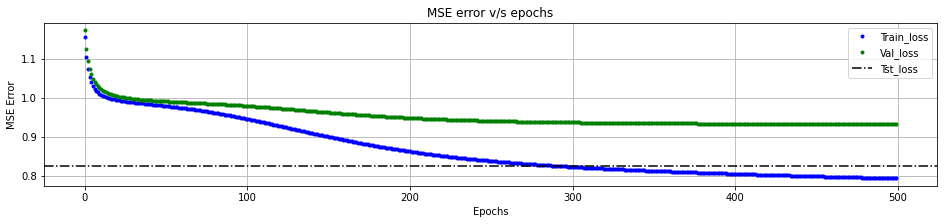

In [ ]:
test_loss_1_b_i=tf.math.reduce_mean(test_batch_loss).numpy() # .numpy() converts tensor to array, tf.convert_to_tensor converts array to tensor
plt.title("MSE error v/s epochs")
plt.plot(hist_1_b_i.history["loss"],"b.",label="Train_loss")
plt.plot(hist_1_b_i.history["val_loss"],"g.",label="Val_loss")
plt.axhline(y=test_loss_1_b_i,color="k",linestyle="-.",label="Tst_loss")
plt.xlabel("Epochs"),plt.ylabel("MSE Error")
plt.legend(),plt.grid()
plt.show()

# Respuesta
* No existe overfitting puesto que se ve que los errores de training y validación disminuyen continuamente por cada epoch, donde la curva de validación en ningún momento aumenta al estar entrenando.
* Respecto al error de test, se puede ver que tiene un rendimiento similar al error del training set, llegando a ser muy similar en torno a las 300 epochs, donde el error de training comienza a disminuir. Frente a esto se debe tener cuidado, ya que esto nos podría indicar que que se está comenzando a memorizar y se esta perdiendo la capacidad de generalización. Sería una buena idea observar  el comportamiento del MSE con más Epoch para comprobar si el error del test set se reduce o si ocurre lo contrario.

##### II) **Entrene** una red neuronal con los mismos hiperparámetros que en la sección anterior pero con función de activación ReLU.

In [ ]:
input_dense= input_layer.Input(shape=(x_tr.shape[1]))

dense=layers.Dense(50, activation='relu',use_bias=True)(input_dense)
output_dense=layers.Dense(1, activation='relu',use_bias=True)(dense)
model=models.Model(inputs=input_dense, outputs=output_dense)
# Compile model
model.compile(optimizer=SGD(learning_rate=0.01),loss='mean_squared_error')
# Define callbacks (No modificar patience!!!!!!!!! es solo para que la conozcan por el momento)
my_callbacks = [History(), # Returns validation and training loss
    tf.keras.callbacks.EarlyStopping(patience=500,monitor="val_loss", #Stops training when the validation loss doesnt get better in n°patience consecutive epochs
                                     restore_best_weights=True)] 


hist_1_b_ii = model.fit(x_tr, y_tr, epochs=500, verbose=0, validation_data=(x_val, y_val),callbacks=my_callbacks) 
test_loss_1_b_ii=tf.math.reduce_mean(tf.keras.losses.MSE(y_test, model(x_test))).numpy()

##### III) **Cree** una función que grafique los resultados, puede basarse en el siguiente código. La función creada la puede ir modificando en los siguientes items para reducir esfuerzos (fijarse en que la visualización sea lo más clara posible). **Visualice y compare** los resultados con los obtenidos en el punto 1.b.I). **Comente**.

In [ ]:
plt.rcParams["figure.figsize"]=[16,3]
def graph_results(hists,tsts,titles, y_min, y_max):
  fig, axes = plt.subplots(1, len(hists), sharey=True) # sharey to keep the same y lims for all subplots. 
                                            # En algunos casos esto puede jugar en contra para una buena visualización -> ver siguiente comentario
  for i,ax in enumerate(axes):
    ax.set_title(titles[i])
    ax.plot(hists[i]["loss"],"b.",label="Train_loss")
    ax.plot(hists[i]["val_loss"],"g.",label="Val_loss")
    ax.axhline(y=tsts[i],color="k",linestyle="-.",label="Tst_loss")
    ax.set_xlabel("Epochs"),ax.set_ylabel("MSE Error")
    ax.set_xlim([-20,520])
    ax.set_ylim([y_min, y_max])  # <- Puede convenir insertar como entrada a la función límite inferiores y superiores para ajuste manual
    if i==len(axes)-1: ax.legend()
    ax.grid()
  plt.tight_layout()
  plt.show()

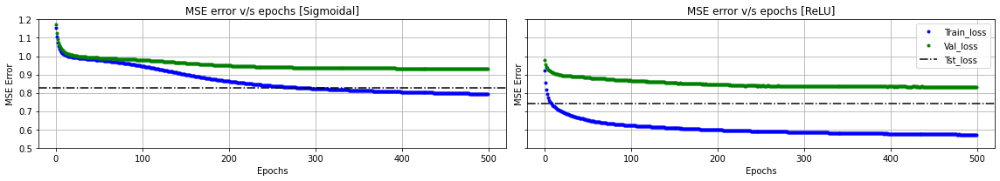

In [ ]:

hists=[hist_1_b_i.history,hist_1_b_ii.history]
tsts=[test_loss_1_b_i,test_loss_1_b_ii]
titles=["MSE error v/s epochs [Sigmoidal]","MSE error v/s epochs [ReLU]"]

graph_results(hists,tsts,titles, 0.5, 1.2) # llamado simple para graficar

En primer lugar, se puede destacar que el MSE error con función de activación ReLU para las primeras epoch inicia con valores menores que los de la función sigmoidal. Sin embargo, respecto al error con el conjunto de testing, se puede ver que en las primeras Epoch este alcanza valores similares al error de training, pero a medida que se realizan mas epoch, solo se consigue diminuir el error del conjunto de entrenamiento y el error de validación parece estancarse nuevamente, aún así, podríamos decir que no existe overfitting en las epoch que logramos entrenar, pero con ReLU se podría esperar que es posible que el error de validación comience a subir, teniendo que comprobarse al entrenar nuevamente con más epoch.

Además se destaca el hecho de que se obtiene un menor error en el conjunto de testeo haciendo uso de la función de activación ReLU.

Finalmente, podemos ver también que el error de validación y de testing disminuyen, siendo el error de training mucho menor utilizando ReLU que la función sigmoidal.

## 1.c Sensibilidad a hiperparámetros

##### I) **Utilice** la siguiente función (o implemente una propia) para **recopilar** el error de entrenamiento, validación y test **según** el número de capas en la red neuronal y el número de neuronas. Considere el mismo número de neuronas para cada capa. Seleccione dos valores para la cantidad de neuronas entre 10 y 100, y varíe la profundidad entre 1 y 3, e.d 6 redes en total. Utilice la f° de activación ReLU, 500 epochs, lr=0.01, y error MSE. **Encuentre los hiperparámetros (n° neuronas y profundidad) que obtienen el menor error de validación**. 

**Pregunta:** ¿Por qué el menor error de validación y no de test?

**Visualice** y **Comente** los resultados.

In [ ]:
def train_network_1_c_i(prof_dense,n_neurons):
  input_dense=input_layer.Input(shape=(x_tr.shape[1]))
  for i in range(prof_dense):
    if i==0:
      dense=layers.Dense(n_neurons, activation='relu',use_bias=True)(input_dense)
    else:
      dense=layers.Dense(n_neurons, activation='relu',use_bias=True)(dense)
  output_dense=layers.Dense(1, activation='relu',use_bias=True)(dense)
  model=models.Model(inputs=input_dense, outputs=output_dense)
  # Compile model
  model.compile(optimizer=SGD(learning_rate=0.01),loss='mean_squared_error')
  # define callbacks (keep patience at 100)
  my_callbacks = [History(), # Returns validation and training loss
    tf.keras.callbacks.EarlyStopping(patience=100,monitor="val_loss", #Stops training when the validation loss doesnt get better in n°patience consecutive epochs
                                     restore_best_weights=True)] # Returns best validation loss
  # Train model
  hist = model.fit(x_tr, y_tr, epochs=500, verbose=0, validation_data=(x_val, y_val),callbacks=my_callbacks)
  test_loss=tf.math.reduce_mean(tf.keras.losses.MSE(y_test, model(x_test))).numpy()
  return(hist,test_loss)

In [ ]:
neuronas=[10 , 100] 
red_list = list()
val_list = list()

for i in range(1,4):
  for j in neuronas:
    h_x, t_x = train_network_1_c_i(i,j)
    red_list.append((h_x, t_x))
    val_list.append(np.min(h_x.history["val_loss"]))

min_val_list = val_list.index(np.min(val_list))


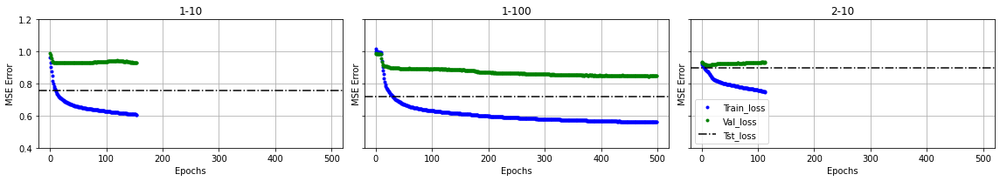

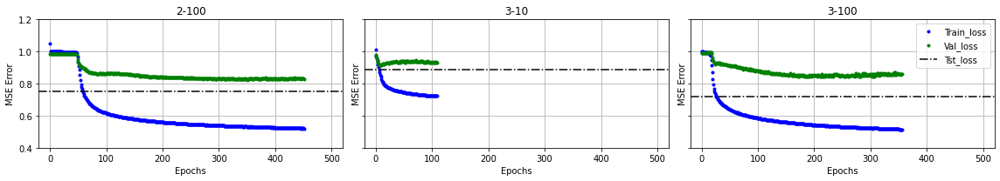

Red con menor error de validación: 4


In [ ]:
graph_results([red_list[0][0].history,red_list[1][0].history,red_list[2][0].history],[red_list[0][1], red_list[1][1], red_list[2][1]],["1-10","1-100", "2-10"], 0.4, 1.2)
graph_results([red_list[3][0].history,red_list[4][0].history,red_list[5][0].history],[red_list[3][1], red_list[4][1], red_list[5][1]],["2-100","3-10", "3-100"], 0.4, 1.2)
print("Red con menor error de validación: " + str(min_val_list+1))

In [ ]:
print(val_list)

[0.9281420111656189, 0.8460688591003418, 0.9140411615371704, 0.8245059847831726, 0.9144169688224792, 0.8418792486190796]


¿Por qué el menor error de validación y no de test?

Esto es debido a que estamos determinando cuales son los mejores hiperparámetros para el modelo, y estos se tunnean según el error de validación.

Respecto a los resultados, las redes 1-10, 2-10 y 3-10 son las que presentan un peor desempeño, ya que el error de validación se mantiene prácticamente estable o empeora, terminando así su entrenamiento de forma temprana.

Las tres redes restantes, 1-100, 2-100 y 3-100 presentan un mejor desempeño que las otras redes, ya que consiguen sobrepasar las 350 epoch (aproximadamente), lo que implica que su error de validación disminuyo por lo menos hasta la epoch 250. Además tanto el error de entrenamiento y validación disminuyen a un ritmo similar, pero el GAP parece mantenerse en la segunda y cuarta red, mientras que en la sexta se presenta la tendencia de que el error de validación comenzará a subir. Finalmente, la red que consigue un menor error de validación es la cuarta, pero todos los errores se encuentran en un rango de [0.82, 0.93], lo que indica que poseen un rendimiento similar.

##### II) **Realice** un experimento similar, ahora variando el learning rate entre [-1e-6 y 1e-1], entrene 6 redes neuronales con distintos learning rate. Para esto **implemente una función** semejante a la utilizada en el punto anterior, use la arquitectura e hiperparámetros dados. **Encuentre el learning rate que obtiene el menor error de validación. Visualizar y comentar**

In [ ]:
#2 capas, 100 neuronas

def train_network_1_c_ii(learning_r):
  input_dense= input_layer.Input(shape=(x_tr.shape[1]))
  dense=layers.Dense(100, activation='relu',use_bias=True)(input_dense)
  dense=layers.Dense(100, activation='relu',use_bias=True)(dense)
  output_dense=layers.Dense(1, activation='relu',use_bias=True)(dense)
  model=models.Model(inputs=input_dense, outputs=output_dense)
  model.compile(optimizer=SGD(learning_rate = learning_r),loss='mean_squared_error')
  my_callbacks = [History(), # Returns validation and training loss
      tf.keras.callbacks.EarlyStopping(patience=200,monitor="val_loss", # Mantener patience en 200
                                      restore_best_weights=True)]
  hist = model.fit(x_tr, y_tr, epochs=500, verbose=0, validation_data=(x_val, y_val),callbacks=my_callbacks)
  test_loss=tf.math.reduce_mean(tf.keras.losses.MSE(y_test, model(x_test))).numpy()
  return(hist, test_loss)

In [ ]:
#Learning rate no puede ser negativo
l_r_list = [1e-6, 1e-5, 1e-4, 1e-3, 1e-2, 1e-1]

red2_list = list()
val2_list = list()

for i in l_r_list:
  h_x, t_x = train_network_1_c_ii(i)
  red2_list.append((h_x, t_x))
  val2_list.append(np.min(h_x.history["val_loss"]))

min_val2_list = val2_list.index(np.min(val2_list))

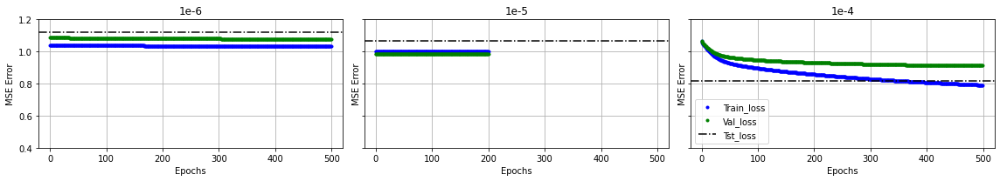

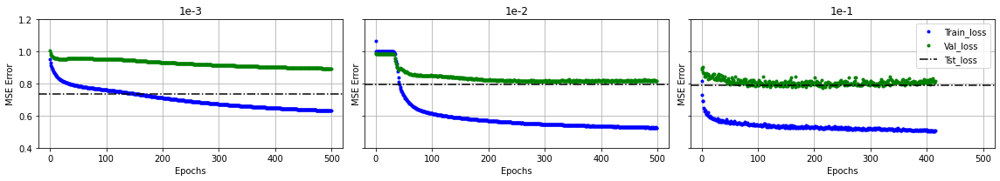

Red con menor error de validación: 6


In [ ]:
graph_results([red2_list[0][0].history,red2_list[1][0].history,red2_list[2][0].history],[red2_list[0][1], red2_list[1][1], red2_list[2][1]],["1e-6","1e-5", "1e-4"], 0.4, 1.2)
graph_results([red2_list[3][0].history,red2_list[4][0].history,red2_list[5][0].history],[red2_list[3][1], red2_list[4][1], red2_list[5][1]],["1e-3","1e-2", "1e-1"], 0.4, 1.2)
print("Red con menor error de validación: " + str(min_val2_list+1))

In [ ]:
print(val2_list)

[1.076229214668274, 0.9866040945053101, 0.912329375743866, 0.8940919637680054, 0.8113530874252319, 0.7732837200164795]


Se puede visualizar que el menor error de validación se presenta con el learning rate igual a 1e-1. Sin embargo, este presenta una mayor oscilacion en estos valores con cada epoch. 

Además, al mostrar los learning rate por pantalla, se puede ver que a medida que este aumenta, el error de validación disminuye. Esto tiene sentido ya que este hiperparámetro controla la velocidad con la que el modelo aprende el problema, necesitando así una menor cantidad de epochs, lo que tambien se puede evidenciar ya que con learning rate igual a 1e-1 se realizaron menos de 500 epoch.

Respecto a los modelos con un learning rate igual a 1e-6 y 1e-5, se presenta una mejora mínima en el caso del primero y mientras que en el segundo no mejora ya que terminó en las 200 epoch.

Por último, en los modelos con learning rate igual a 1e-4, 1e-3 y 1e-2, se puede apreciar que el error de validación va disminuyendo cada vez más rapido de un modelo a otro.


##### III) **Realice** un experimento similar, ahora variando el learning decay, entrene 6 redes neuronales para distintos decay. Para esto **implemente una función** semejante a la utilizada en el punto anterior. **Encuentre el learning decay que obtiene el menor error de validación. Visualizar y comentar**

In [ ]:
lear_decay = np.logspace(-6,0,6)
lear_decay=np.around(lear_decay,decimals=6)


def train_network_1_c_iii(my_decay):
  input_dense= input_layer.Input(shape=(x_tr.shape[1]))
  dense=layers.Dense(100, activation='relu',use_bias=True)(input_dense)
  dense=layers.Dense(100, activation='relu',use_bias=True)(dense)
  output_dense=layers.Dense(1, activation='relu',use_bias=True)(dense)
  model=models.Model(inputs=input_dense, outputs=output_dense)
  model.compile(optimizer=SGD(learning_rate=0.1,decay=my_decay),loss='mean_squared_error')

  my_callbacks = [History(), # Returns validation and training loss
      tf.keras.callbacks.EarlyStopping(patience=200,monitor="val_loss", # Mantener patience en 200
                                      restore_best_weights=True)]
  hist = model.fit(x_tr, y_tr, epochs=500, verbose=0, validation_data=(x_val, y_val),callbacks=my_callbacks)
  test_loss=tf.math.reduce_mean(tf.keras.losses.MSE(y_test, model(x_test))).numpy()
  return(hist, test_loss)

In [ ]:
red3_list = list()
val3_list = list()

for i in lear_decay:
  h_x, t_x = train_network_1_c_iii(i)
  red3_list.append((h_x, t_x))
  val3_list.append(np.min(h_x.history["val_loss"]))

min_val3_list = val3_list.index(np.min(val3_list))

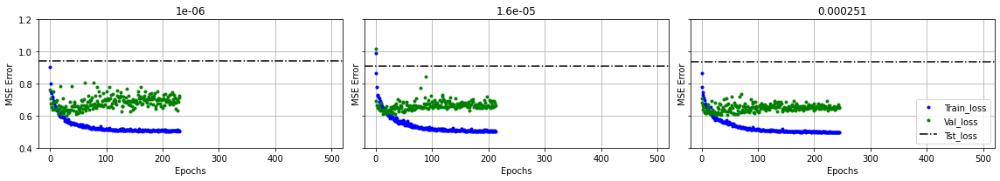

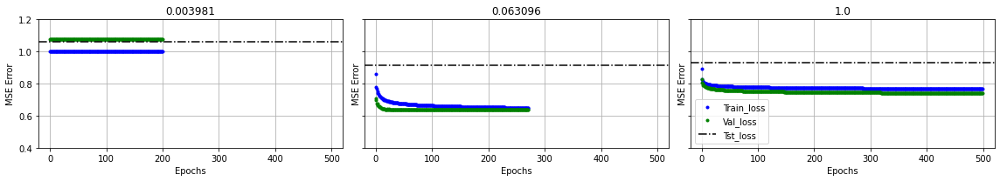

Red con menor error de validación: 1


In [ ]:
graph_results([red3_list[0][0].history,red3_list[1][0].history,red3_list[2][0].history],[red3_list[0][1], red3_list[1][1], red3_list[2][1]],[lear_decay[0],lear_decay[1], lear_decay[2]], 0.4, 1.2)
graph_results([red3_list[3][0].history,red3_list[4][0].history,red3_list[5][0].history],[red3_list[3][1], red3_list[4][1], red3_list[5][1]],[lear_decay[3],lear_decay[4], lear_decay[5]], 0.4, 1.2)
print("Red con menor error de validación: " + str(min_val3_list+1))

In [ ]:
print(val3_list)

[0.6003561019897461, 0.6088002920150757, 0.6028258800506592, 1.0799716711044312, 0.6360681653022766, 0.7407546043395996]


Se asumió el uso de parámetros de learning rate, número de neuronas y profundidad utilizados en las preguntas anteriores.

El learning decay disminuye el learning rate con el pasar de cada epoch. En la visualización se puede ver que, al aumentar el learning decay, el error de validación aumenta (excluyendo a la cuarta red). 

Lo anterior es consistente con lo encontrado en la pregunta anterior, ya que vimos que un learning rate menor provocaba que la red tuviese un error de validación peor, por lo que se debería buscar reducir este hiperparámetro lentamente para no llegar a un learning rate que provoque que el modelo no permita mejorar.



##### IV) **Realice** un experimento similar, ahora variando el optimizador para la arquitectura e hiperparámetros dados, pruebe con los optimizadores [SGD, Adagrad, Adadelta, Adam y RMSprop]. Para esto **implemente una función** semejante a la utilizada en el punto anterior. **Pregunta:** ¿En qué optimizadores no tiene sentido utilizar el learning decay, por qué? **Visualizar y comentar**

In [ ]:
from keras.optimizers import SGD, Adam, RMSprop, Adagrad, Adadelta

the_optimizers = [SGD, Adam, RMSprop, Adagrad, Adadelta]

#Se mantienen las 50 neuronas y el learning rate de 0.001, se toma en cuenta el decay de 1e-6 obtenido anteriormente
#para SGD
def train_network_1_c_iv(my_optimizer):
  input_dense= input_layer.Input(shape=(x_tr.shape[1]))
  dense=layers.Dense(50, activation='relu',use_bias=True)(input_dense)
  dense=layers.Dense(50, activation='relu',use_bias=True)(dense)
  output_dense=layers.Dense(1, activation='relu',use_bias=True)(dense)
  model=models.Model(inputs=input_dense, outputs=output_dense)
  if(my_optimizer == SGD):
    model.compile(optimizer=my_optimizer(learning_rate=0.001,decay=1e-6),loss='mean_squared_error')
  else:
    model.compile(optimizer=my_optimizer(learning_rate=0.001),loss='mean_squared_error')
  # Define callbacks
  my_callbacks = [History(), 
      tf.keras.callbacks.EarlyStopping(patience=500,monitor="val_loss", # (No modificar patience!!!!!!!!!)
                                      restore_best_weights=True)]
  hist = model.fit(x_tr, y_tr, epochs=500, verbose=0, validation_data=(x_val, y_val),callbacks=my_callbacks)
  test_loss=tf.math.reduce_mean(tf.keras.losses.MSE(y_test, model(x_test))).numpy()
  return(hist, test_loss)

In [ ]:
red4_list = list()
val4_list = list()

for i in the_optimizers:
  h_x, t_x = train_network_1_c_iv(i)
  red4_list.append((h_x, t_x))
  val4_list.append(np.min(h_x.history["val_loss"]))

min_val4_list = val4_list.index(np.min(val4_list))

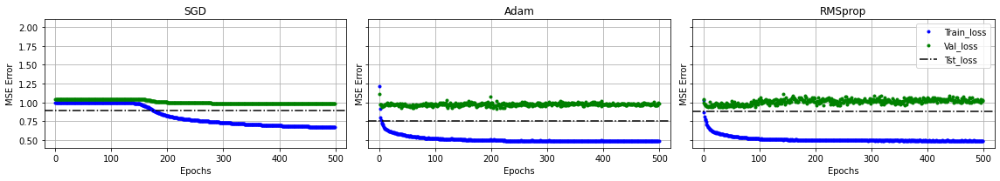

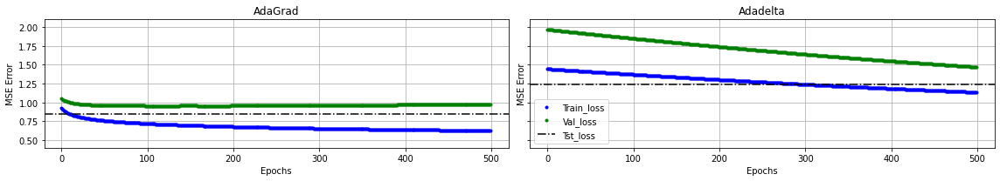

Red con menor error de validación: 2


In [ ]:
graph_results([red4_list[0][0].history,red4_list[1][0].history,red4_list[2][0].history],[red4_list[0][1], red4_list[1][1], red4_list[2][1]],["SGD","Adam", "RMSprop"], 0.4, 2.1)
graph_results([red4_list[3][0].history,red4_list[4][0].history],[red4_list[3][1], red4_list[4][1]],["AdaGrad", "Adadelta"], 0.4, 2.1)
print("Red con menor error de validación: " + str(min_val4_list+1))

In [ ]:
print(val4_list)

[0.9865255355834961, 0.921640157699585, 0.9342079162597656, 0.9561715126037598, 1.4707599878311157]


En los optimizadores que no tiene sentido aplicar un learning decay corresponden a Adam, RMSprop, Adagrad y Adadelta. Esto es debido a que por su propia implementación aplican un decay al learning rate de diferentes maneras. AdaGrad lo hace en proporción a su historial de actualizaciones almacenado en la media móvil. RMSprop lo hace similar a AdaGrad pero también aplica un decay al denominador que multiplica al gradiente. Adam, hace lo mismo que RMSprop con la media móvil del cuadrado de los gradientes, pero además incluye la media móvil de los gradientes por si solos. Por último Adadelta es una extensión más robusta de AdaGrad que utiliza un decay rate exponencial.

Respecto a los resultados obtenidos, Adadelta es el que posee el peor error de validación, siendo superior a todos los demás. El resto ronda valores cercanos, sin embargo se puede ver que AdaGrad luego de las 200 epoch presenta una tendencia a aumentar el error de validación. SGD presenta una disminución que inicia en torno a la epoch 150 y luego parece mantenerse constante. Por otro lado Adam y RMSprop presentan un comportamiento más irregular, sin embargo, Adam es el optimizador que posee el menor error de validación.

##### V) **Realice** un expermiento similar, ahora variando el batch_size entre 1 y x_tr.shape[0] incluyendo los extremos. Entrene 6 redes neuronales con la arquitectura e hiperparámetros dados. Para esto **implemente una función** semejante a la utilizada en el punto anterior. Para un batch_size=1 el entrenamiento se va a demorar más que en puntos anteriores, aprox. 1 segundo en _Colab_. **Visualizar y comentar**. **Preguntas:** ¿A qué es equivalente entrenar con un batch_size = 1 y batch_size=x_tr.shape[0]? ¿Cuál es el batch_size por default?

In [ ]:
n_batches=6
batches=np.round(np.linspace(1,x_tr.shape[0],n_batches))

#Se mantiene el optimizador, la cantidad de neuronas y el learning rate dado en la función
def train_network_1_c_v(my_batch):
  input_dense= input_layer.Input(shape=(x_tr.shape[1]))
  dense=layers.Dense(50, activation='relu',use_bias=True)(input_dense)
  dense=layers.Dense(50, activation='relu',use_bias=True)(dense)
  output_dense=layers.Dense(1, activation='relu',use_bias=True)(dense)
  model=models.Model(inputs=input_dense, outputs=output_dense)
  model.compile(optimizer=Adam(learning_rate=0.001),loss='mean_squared_error')
  # Define callbacks
  my_callbacks = [History(), 
      tf.keras.callbacks.EarlyStopping(patience=100,monitor="val_loss", # (No modificar patience!!!!!!!!!)
                                      restore_best_weights=True)]
  hist = model.fit(x_tr, y_tr, epochs=500, verbose=0, batch_size=my_batch,validation_data=(x_val, y_val),callbacks=my_callbacks)
  test_loss=tf.math.reduce_mean(tf.keras.losses.MSE(y_test, model(x_test))).numpy()
  return(hist, test_loss)

In [ ]:
red5_list = list()
val5_list = list()

for i in batches:
  
  h_x, t_x = train_network_1_c_v(int(i))
  red5_list.append((h_x, t_x))
  val5_list.append(np.min(h_x.history["val_loss"]))

min_val5_list = val5_list.index(np.min(val5_list))

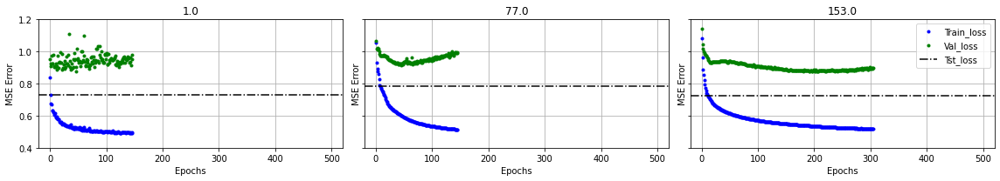

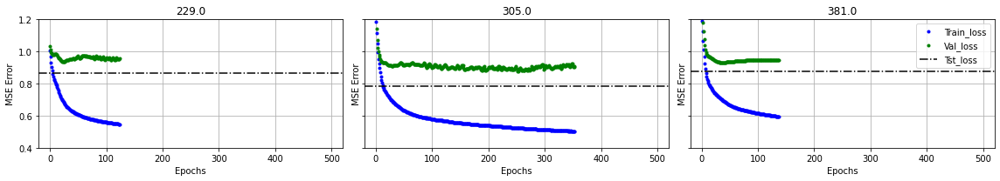

Red con menor error de validación: 3


In [ ]:
graph_results([red5_list[0][0].history,red5_list[1][0].history,red5_list[2][0].history],[red5_list[0][1], red5_list[1][1], red5_list[2][1]],[batches[0],batches[1], batches[2]], 0.4, 1.2)
graph_results([red5_list[3][0].history,red5_list[4][0].history,red5_list[5][0].history],[red5_list[3][1], red5_list[4][1], red5_list[5][1]],[batches[3],batches[4], batches[5]], 0.4, 1.2)
print("Red con menor error de validación: " + str(min_val5_list+1))

In [ ]:
print(val5_list)

[0.8779234290122986, 0.9153604507446289, 0.8746500015258789, 0.9348295331001282, 0.8767837285995483, 0.9304897785186768]


Se puede ver que no es ideal elegir un batch size igual a uno, ya que se puede caer en elegir malos ejemplos, poco representativos u outliers que hagan que el gradiente vaya en la dirección incorrecta, lo que se puede ver en la variación del error de validación a lo largo de las epochs, por lo que, a pesar de ser menos costoso, se realizaron menos epochs.
Por otro lado con el batch size máximo, 229 y 77 se obtuvo una detención temprana del entrenamiento en torno a la epoch 130, presentando todos un error de validación superior a 0.9, sin embargo, se puede observar que el error de validación para un batch size de 77 presenta una tendencia a aumentar.
Finalmente, los batch size restantes, 153 y 305, realizaron una mayor cantidad de epochs con un error de validación más estable, obtienendo los dos menores, pero, con un batch size de 153 parece hacerse presente un crecimiento del error de validación.

Respecto a las preguntas, ocupar un batch size de tamaño 1 significa tomar un solo sample para el cálculo del gradiente, denominado Stochastic Gradient Descent,lo que es menos costoso, pero puede ser perjudicial el tomar sólo un ejemplo por las razones antes dichas. El ocupar un batch size de tamaño máximo (381, en este caso) se denomina Batch Gradiendt Descent, es ocupar todos los samples para el cálculo del gradiente, lo que podría llevar a hacer overfitting.
El  batch size por default es de 32.

## 1.d Inicializaciones, pesos y gradientes

##### I) Utilizando las siguientes arquitecturas proceda a graficar la distribución de pesos de las distintas capas bajo inicialización uniforme (incluyendo bias). Adicionalmente calcule el gradiente de la función de pérdida (loss) para el conjunto de entrenamiento (promedio del gradiente del error de todos los datos de entrenamiento) respecto a los pesos en las distintas capas. **Visualize, compare y comente**

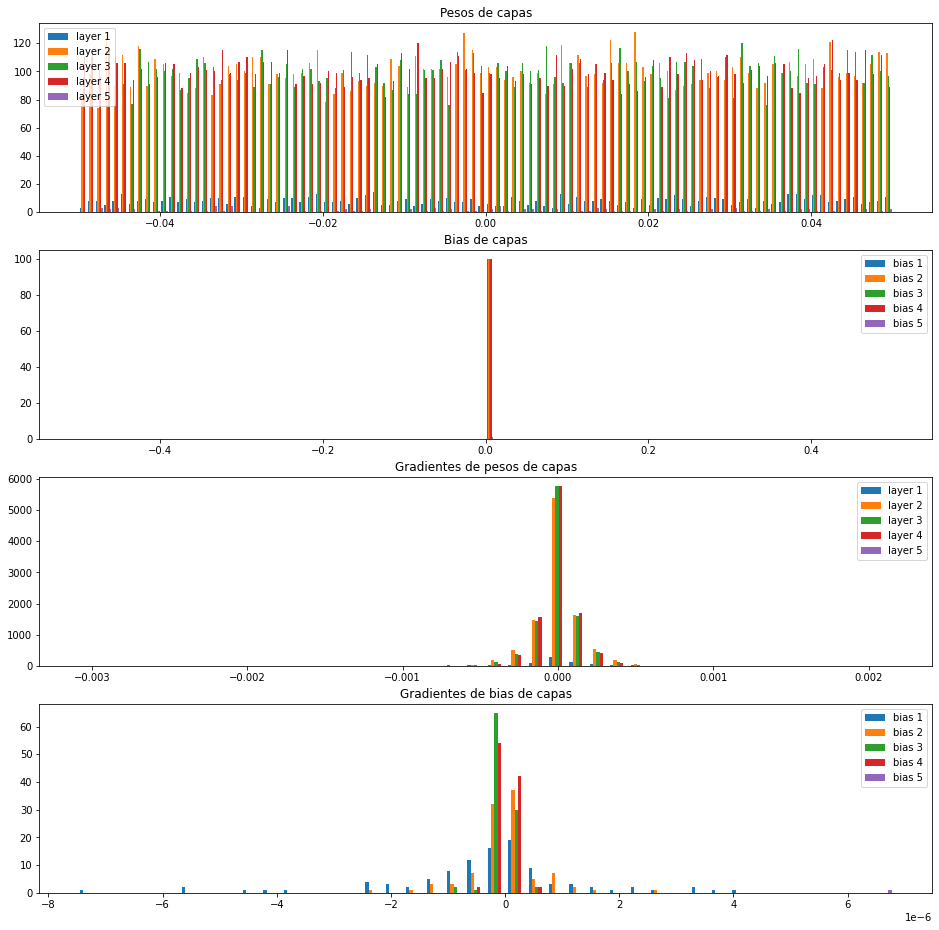

In [ ]:
# Define architecture (1)
input_dense= input_layer.Input(shape=(8))
dense=layers.Dense(100, activation='tanh',use_bias=True, kernel_initializer="uniform")(input_dense)
dense=layers.Dense(100, activation='tanh',use_bias=True, kernel_initializer="uniform")(dense)
dense=layers.Dense(100, activation='tanh',use_bias=True, kernel_initializer="uniform")(dense)
dense=layers.Dense(100, activation='tanh',use_bias=True, kernel_initializer="uniform")(dense)
output_dense=layers.Dense(1, activation='tanh',use_bias=True, kernel_initializer="uniform")(dense)
model=models.Model(inputs=input_dense, outputs=output_dense)



weights=model.get_weights()
# Get gradient
with tf.GradientTape() as tape:
  y_pred= model(x_tr)
  loss = tf.reduce_mean(tf.square(y_pred-y_tr)) #MSE loss
  grad=tape.gradient(loss,model.trainable_weights) 

plt.rcParams["figure.figsize"]=[16,16]
plt.subplot(4,1,1).set_title("Pesos de capas")
plt.hist(weights[::2],bins=100,label=["layer 1","layer 2","layer 3","layer 4","layer 5"]) #Pesos capa
plt.legend()
plt.subplot(4,1,2).set_title("Bias de capas")
plt.hist(weights[1::2],bins=100, label=["bias 1", "bias 2","bias 3","bias 4","bias 5"]) #Pesos bias
plt.legend()
plt.subplot(4,1,3).set_title("Gradientes de pesos de capas")
plt.hist(grad[::2],bins=40, label=["layer 1","layer 2","layer 3","layer 4","layer 5"])#Gradiente capa
plt.legend()
plt.subplot(4,1,4).set_title("Gradientes de bias de capas")
plt.hist(grad[1::2],bins=40, label=["bias 1", "bias 2","bias 3","bias 4","bias 5"])#Gradiente bias
plt.legend()
plt.show()

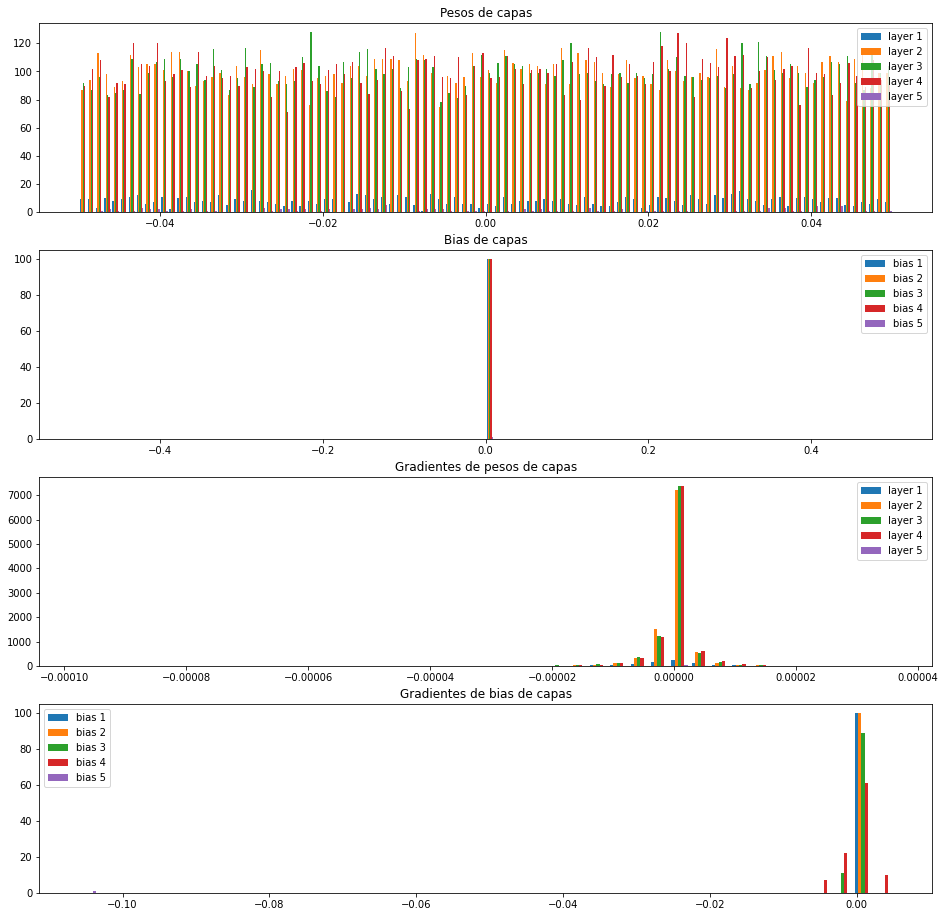

In [ ]:
# Define architecture (2)
input_dense= input_layer.Input(shape=(8))
dense=layers.Dense(100, activation='relu',use_bias=True, kernel_initializer="uniform")(input_dense)
dense=layers.Dense(100, activation='relu',use_bias=True, kernel_initializer="uniform")(dense)
dense=layers.Dense(100, activation='relu',use_bias=True, kernel_initializer="uniform")(dense)
dense=layers.Dense(100, activation='relu',use_bias=True, kernel_initializer="uniform")(dense)
output_dense=layers.Dense(1, activation='relu',use_bias=True, kernel_initializer="uniform")(dense)
model=models.Model(inputs=input_dense, outputs=output_dense)

weights=model.get_weights()
# Get gradient
with tf.GradientTape() as tape:
  y_pred= model(x_tr)
  loss = tf.reduce_mean(tf.square(y_pred-y_tr)) #MSE loss
  grad=tape.gradient(loss,model.trainable_weights) 

plt.rcParams["figure.figsize"]=[16,16]
plt.subplot(4,1,1).set_title("Pesos de capas")
plt.hist(weights[::2],bins=100,label=["layer 1","layer 2","layer 3","layer 4","layer 5"]) #Pesos capa
plt.legend()
plt.subplot(4,1,2).set_title("Bias de capas")
plt.hist(weights[1::2],bins=100, label=["bias 1", "bias 2","bias 3","bias 4","bias 5"]) #Pesos bias
plt.legend()
plt.subplot(4,1,3).set_title("Gradientes de pesos de capas")
plt.hist(grad[::2],bins=40, label=["layer 1","layer 2","layer 3","layer 4","layer 5"])#Gradiente capa
plt.legend()
plt.subplot(4,1,4).set_title("Gradientes de bias de capas")
plt.hist(grad[1::2],bins=40, label=["bias 1", "bias 2","bias 3","bias 4","bias 5"])#Gradiente bias
plt.legend()
plt.show()

La diferencia entre las 2 arquitecturas corresponde a la función de activación, siendo para la primera tanh y ReLU para la segunda. Se puede ver que en ambas los pesos de todas las capas siguen una distribución uniforme, destacando que la primera capa posee valores cercanos a 10 mientras que las demás poseen valores que rondan al 90. Los rangos se encuentran entre [-0.05, 0.05] Por otro lado, los bias de ambas arquitecturas son inicializados en 0 para todas las capas. 

Respecto a los gradientes, se puede ver que tanto para los pesos como los bias de ambas arquitecturas, estos siguen una distribución normal centrada en cero. Sin embargo, cabe destacar que en la primera arquitectura el rango de estos valores es menor para los pesos y mayor para los bias si se compara con la segunda arquitectura. Lo anterior se puede ver en los límites del eje x de los graficos de gradientes, siendo [-0.001, 0.001] y [-6e-6, 6e-6], contrastando con los límites de la segunda arquitectura [-0.0002, 0.0002] y [-0.01 , 0.01] (lo anterior sin cortar una mínima cantidad de valores que se aleja de estos rangos).

Se destaca el hecho de que los gradientes para la última capa son apenas perceptibles para ambas arquitecturas, y que las capas 2, 3 y 4 presentan una distribución similar. Además, los gradientes para la primera capa en la segunda arquitectura estan más concentrados respecto al cero, mientras que en la primera arquitectura se encuentran más dispersos.

##### II) Repita el experimento para las inicializaciones de kernel HE_uniform, Glorot normal y Glorot uniform. **Visualice, comente, y compare** 

**Pregunta** ¿Es posible inicializar los bias? ¿Cómo sería el código?

In [ ]:
kernel_initializer=['he_uniform','glorot_normal','glorot_uniform']
activation_func = ['tanh', 'relu']

def initializers_1_d_ii(my_initializer, my_act_fun):
  input_dense= input_layer.Input(shape=(8))
  dense=layers.Dense(100, activation=my_act_fun,use_bias=True, kernel_initializer=my_initializer)(input_dense)
  dense=layers.Dense(100, activation=my_act_fun,use_bias=True, kernel_initializer=my_initializer)(dense)
  dense=layers.Dense(100, activation=my_act_fun,use_bias=True, kernel_initializer=my_initializer)(dense)
  dense=layers.Dense(100, activation=my_act_fun,use_bias=True, kernel_initializer=my_initializer)(dense)
  output_dense=layers.Dense(1, activation=my_act_fun,use_bias=True, kernel_initializer=my_initializer)(dense)
  model=models.Model(inputs=input_dense, outputs=output_dense)

  weights=model.get_weights()
  # Get gradient
  with tf.GradientTape() as tape:
    y_pred= model(x_tr)
    loss = tf.reduce_mean(tf.square(y_pred-y_tr)) #MSE loss
    grad=tape.gradient(loss,model.trainable_weights) 

  plt.rcParams["figure.figsize"]=[18, 8]
  plt.subplot(2,2,1).set_title("Pesos de capas " + my_initializer + ", " + my_act_fun)
  plt.hist(weights[::2],bins=100,label=["layer 1","layer 2","layer 3","layer 4","layer 5"]) #Pesos capa
  plt.legend()
  plt.subplot(2,2,2).set_title("Bias de capas "  + my_initializer + ", " + my_act_fun)
  plt.hist(weights[1::2],bins=100, label=["bias 1", "bias 2","bias 3","bias 4","bias 5"]) #Pesos bias
  plt.legend()
  plt.subplot(2,2,3).set_title("Gradientes de pesos de capas "  + my_initializer + ", " + my_act_fun)
  plt.hist(grad[::2],bins=40, label=["layer 1","layer 2","layer 3","layer 4","layer 5"])#Gradiente capa
  plt.legend()
  plt.subplot(2,2,4).set_title("Gradientes de bias de capas "  + my_initializer + ", " + my_act_fun)
  plt.hist(grad[1::2],bins=40, label=["bias 1", "bias 2","bias 3","bias 4","bias 5"])#Gradiente bias
  plt.legend()
  plt.show()

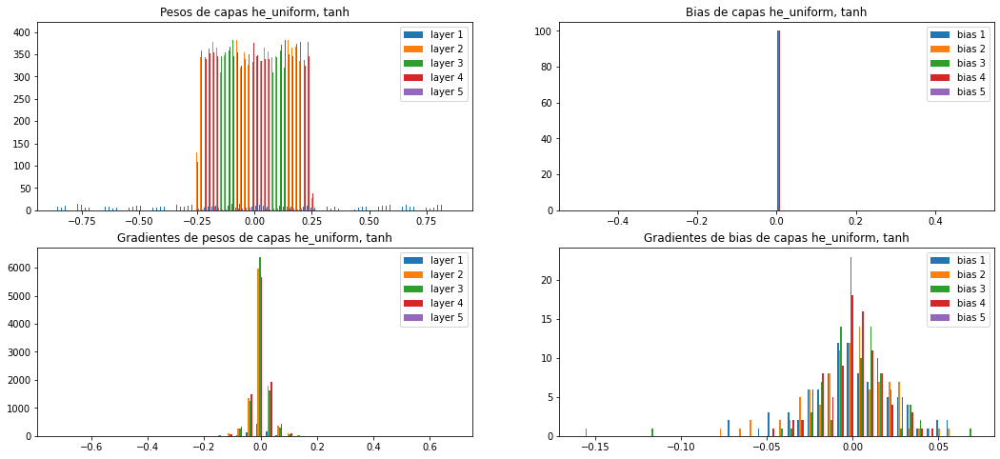

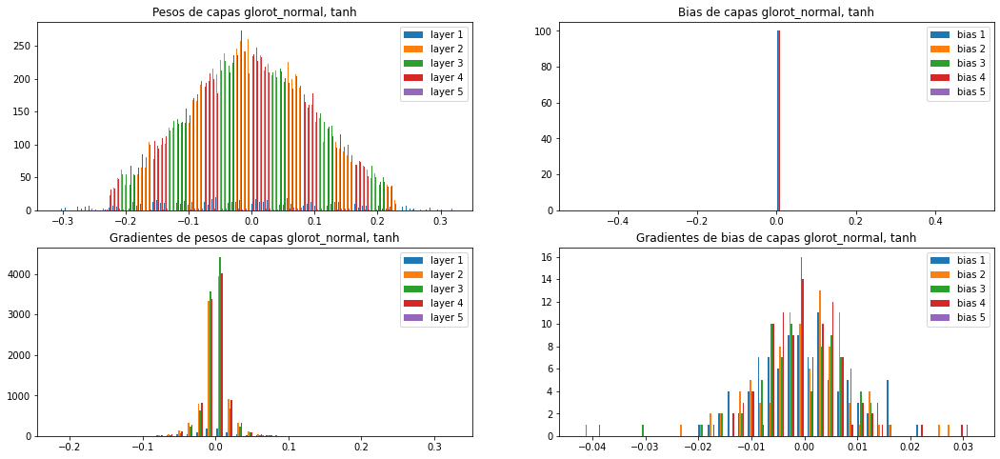

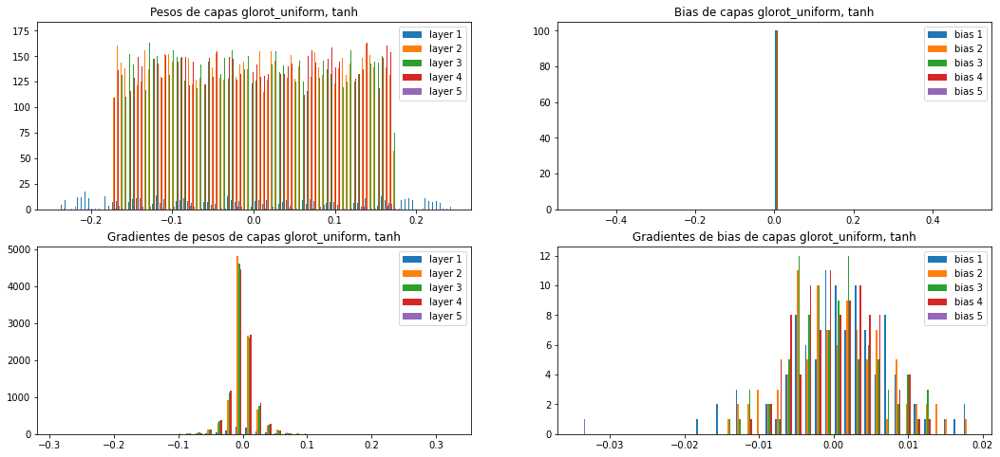

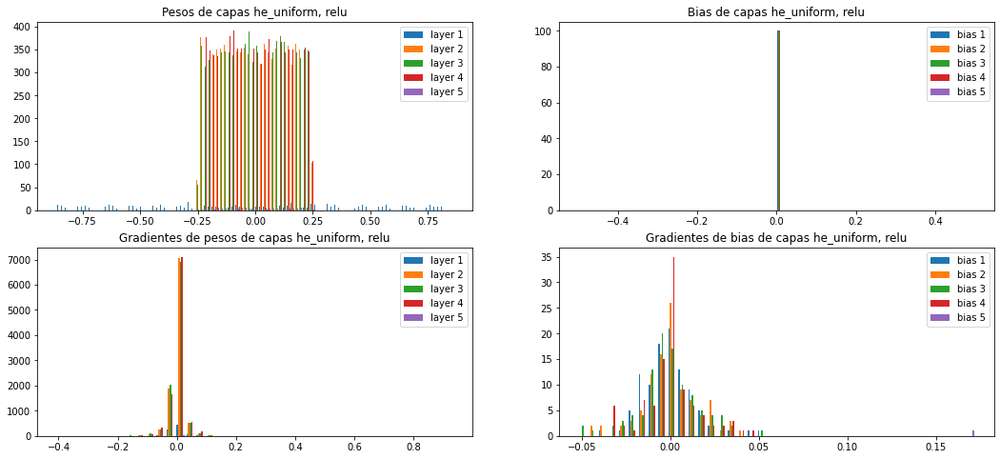

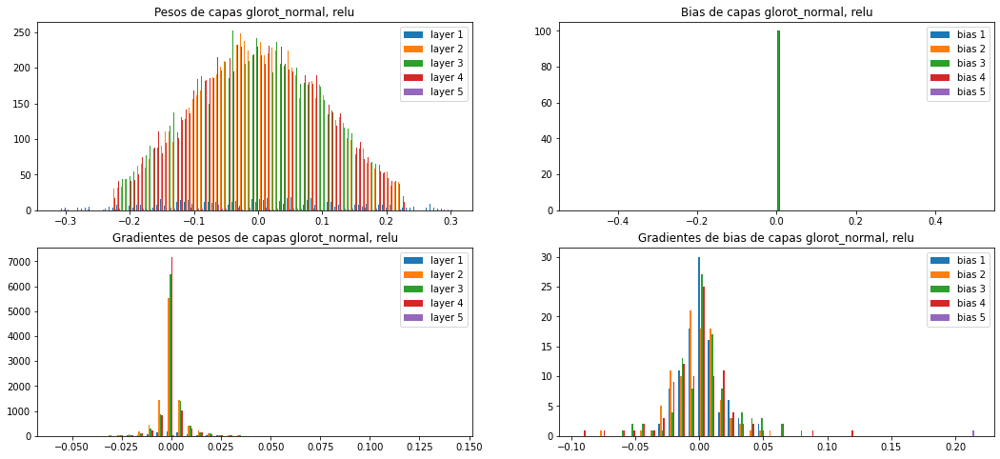

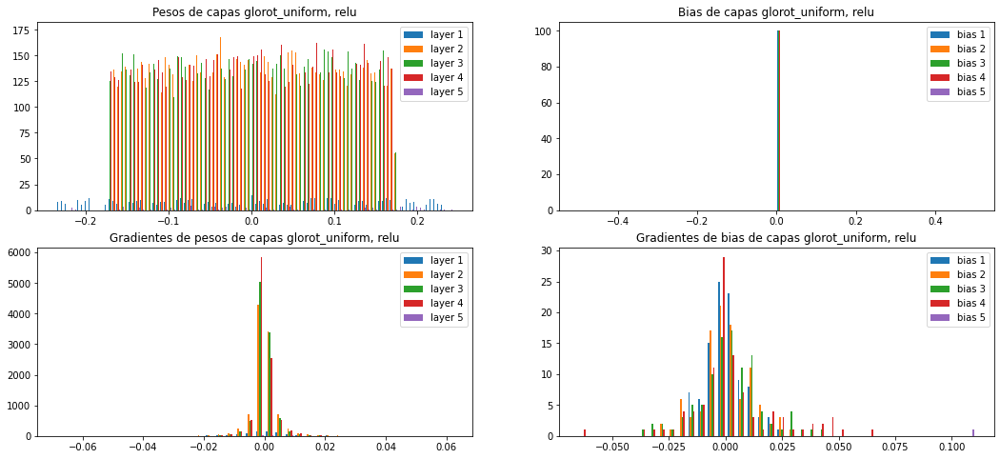

In [ ]:
for act_fun in activation_func:
  for k_init in kernel_initializer:
    initializers_1_d_ii(k_init, act_fun)

* Pesos de capas:

  Para todas las arquitecturas se tiene que la primera capa maneja un rango mayor de valores, y además, estos presentan una frecuencia menor a las demas capas, lo que tiene sentido ya la primera capa existen menos valores (900 para ser exactos)
  * he uniform, tanh y ReLU: Los pesos poseen una distribución similar a la uniforme, sin embargo, en las orillas se presenta una disminución en la frecuencia de aparición de los pesos notoria.
  * glorot normal, tanh y ReLU: En estas se puede apreciar que sigue una distribución normal, pero que posee una desviación estandar no menor.
  * glorot uniform, tanh y ReLU: Los pesos poseen una distribución similar a he uniform pero la disminución en la frecuencia de valores en los bordes es menor.


* Bias de capas:
  Para todas las capas se inicializan en cero.


* Gradientes de pesos de capas:
  En general, se ve que los comportamientos para los gradientes para las 6 arquitecturas son similares. Esto significa que la capa 2, 3 y 4 presentan una distribución similar, la capa 1 presenta valores menores en comparación a las anteriores nombradas y la capa 5 es casi imperceptible por la cantidad de parámetros que posee respecto a las otras capas.
  Se destaca el hecho que para glorot normal y glorot uniform con ReLU la capa 4 parece estar más concentrada en el cero.

* Gradientes de bias de capas:
  Se puede observar que la distribución para los bias es similiar respecto a los inicializadores, pero en cuanto a la función de activación, esta parece influir en como se presentan. Lo anterior viene dado a que para la función de activación ReLU presenta una distribución uniforme con una menor desviación que con tanh.

Respecto a la pregunta, es posible inicializar los bias. Por ejemplo, si queremos inicializar los bias respecto a una capa en específico se puede usar el siguiente código.

In [ ]:
layer = layers.Dense(
    units=64,
    kernel_initializer='random_normal',
    bias_initializer='zeros'
)

"bias_initializer" es el argumento en el cual uno define la manera en que los bias se inicializan, que en este caso serían ceros.

##### III) Utilizando las arquitecturas siguientes. **Recolecte** los pesos y gradientes al inicializar, **entrene** la red neuronal, y **recolecte** nuevamente los pesos y gradientes, junto a los errores de entrenamiento, validación y test. (En la medida de lo posible!). **Visualice, compare y comente**. Ciertos conceptos ya debiesen salir a colación para explicar lo que está sucediendo.

In [ ]:
# 1st arch
input_dense= input_layer.Input(shape=(8))
dense=layers.Dense(100, activation='sigmoid',use_bias=True, kernel_initializer="uniform")(input_dense)
dense=layers.Dense(100, activation='sigmoid',use_bias=True, kernel_initializer="uniform")(dense)
dense=layers.Dense(100, activation='sigmoid',use_bias=True, kernel_initializer="uniform")(dense)
dense=layers.Dense(100, activation='sigmoid',use_bias=True, kernel_initializer="uniform")(dense)
dense=layers.Dense(100, activation='sigmoid',use_bias=True, kernel_initializer="uniform")(dense)
dense=layers.Dense(100, activation='sigmoid',use_bias=True, kernel_initializer="uniform")(dense)
dense=layers.Dense(100, activation='sigmoid',use_bias=True, kernel_initializer="uniform")(dense)
output_dense=layers.Dense(1, activation='linear',use_bias=True, kernel_initializer="uniform")(dense)
model=models.Model(inputs=input_dense, outputs=output_dense)


# Get initial weights
weights_ini=model.get_weights()
# Get initial gradient
with tf.GradientTape() as tape:
  y_pred= model(x_tr)
  loss = tf.reduce_mean(tf.square(y_pred-y_tr)) #MSE loss
  grad_ini=tape.gradient(loss,model.trainable_weights) 
# Compile model
model.compile(optimizer=SGD(learning_rate=0.01),loss='mean_squared_error')
# Train model
hist = model.fit(x_tr, y_tr, epochs=200, verbose=0, validation_data=(x_val, y_val),callbacks=[History()]) #only history as callback
test_loss=tf.math.reduce_mean(tf.keras.losses.MSE(y_test, model(x_test))).numpy()
  
# Get final weights
weights_fin=model.get_weights()
# Get final gradient
with tf.GradientTape() as tape:
  y_pred= model(x_tr)
  loss = tf.reduce_mean(tf.square(y_pred-y_tr)) #MSE loss
  grad_fin=tape.gradient(loss,model.trainable_weights) 

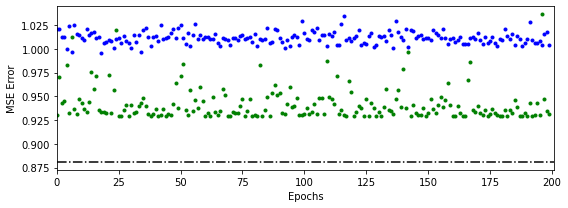

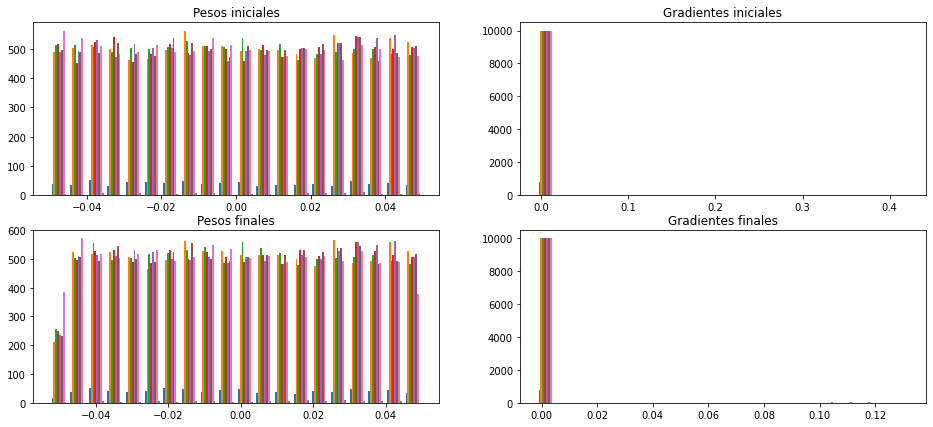

In [ ]:
plt.rcParams["figure.figsize"]=[8, 3]
plt.plot(hist.history["loss"],"b.", label = "Train_loss")
plt.plot(hist.history["val_loss"],"g.", label="Val_loss")
plt.axhline(y=test_loss,color="k",linestyle="-.",label="Tst_loss")

plt.xlabel("Epochs"),plt.ylabel("MSE Error")
plt.xlim([0,201])
plt.tight_layout()
plt.show()
plt.rcParams["figure.figsize"]=[16, 7]
plt.subplot(2,2,1).set_title("Pesos iniciales")
plt.hist(weights_ini[::2] ,bins = 20)
plt.subplot(2,2,2).set_title("Gradientes iniciales")
plt.hist(grad_ini[::2] ,bins = 20)
plt.subplot(2,2,3).set_title("Pesos finales")
plt.hist(weights_fin[::2], bins = 20)
plt.subplot(2,2,4).set_title("Gradientes finales")
plt.hist(grad_fin[::2], bins = 20)
plt.show() #and weights!!!!

In [ ]:
# 2nd arch
input_dense= input_layer.Input(shape=(8))
dense=layers.Dense(1000, activation='sigmoid',use_bias=False, kernel_initializer="he_uniform")(input_dense)
output_dense=layers.Dense(1, activation='linear',use_bias=False, kernel_initializer="uniform")(dense)
model=models.Model(inputs=input_dense, outputs=output_dense)

# Get initial weights
weights_ini=model.get_weights()
# Get initial gradient
with tf.GradientTape() as tape:
  y_pred= model(x_tr)
  loss = tf.reduce_mean(tf.square(y_pred-y_tr)) #MSE loss
  grad_ini=tape.gradient(loss,model.trainable_weights) 
# Compile model
model.compile(optimizer=SGD(learning_rate=0.01),loss='mean_squared_error')
# Train model
hist = model.fit(x_tr, y_tr, epochs=200, verbose=0, validation_data=(x_val, y_val),callbacks=[History()]) #only history as callback
test_loss=tf.math.reduce_mean(tf.keras.losses.MSE(y_test, model(x_test))).numpy()

# Get final weights
weights_fin=model.get_weights()
# Get final gradient
with tf.GradientTape() as tape:
  y_pred= model(x_tr)
  loss = tf.reduce_mean(tf.square(y_pred-y_tr)) #MSE loss
  grad_fin=tape.gradient(loss,model.trainable_weights) 

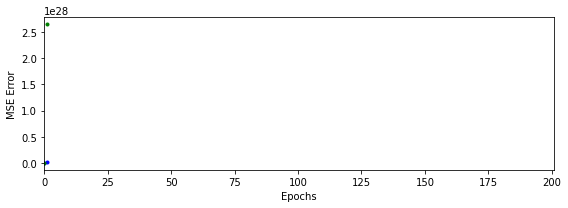

nan
{'loss': [680811954176.0, 1.611765263293976e+26, inf, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, na

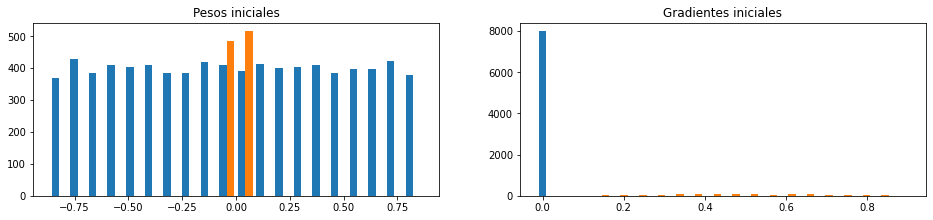

In [ ]:
plt.rcParams["figure.figsize"]=[8, 3]
plt.plot(hist.history["loss"],"b.", label = "Train_loss")
plt.plot(hist.history["val_loss"],"g.", label="Val_loss")
plt.axhline(y=test_loss,color="k",linestyle="-.",label="Tst_loss")

plt.xlabel("Epochs"),plt.ylabel("MSE Error")
plt.xlim([0,201])
plt.tight_layout()
plt.show()
print(test_loss)
print(hist.history)
plt.show()

plt.rcParams["figure.figsize"]=[16, 7]
plt.subplot(2,2,1).set_title("Pesos iniciales")
plt.hist(weights_ini[::] ,bins = 20)
plt.subplot(2,2,2).set_title("Gradientes iniciales")
plt.hist(grad_ini[::] ,bins = 20)


plt.show() #and weights!!!!

Para la segunda arquitectura se presentan problemas, ya que no se pueden obtener los errores ni los pesos y gradientes finales. Al imprimir el error del conjunto de test y el hist.history se puede ver que el primero es nan y el segundo posee valores extremadamente grandes seguido de muchos nan. Para encontrar una explicación a lo anterior nos podemos dar cuenta que esta posee sólo una capa oculta en la que su función de activación es sigmoidal y su inicializador es he uniform, mientras que en la capa de salida se tiene una función de activación lineal y su inicializador es uniform. Considerando lo anterior se tiene que la función de activación lineal es recomendada para redes neuronales utilizadas para problemas de regresión. Los problemas reales generalmente son no-lineales por lo que buscamos modelar este tipo de problemas con una función que sea no lineal también, al probar con una función de activación sigmoid se nos van estos problemas y nos termina entregando resultados. También se debe considerar que la función de activación lineal en la capa de salida, no es más que decir que es una función lineal del input de la capa densa anterior.

En la primera arquitectura se usa la misma capa de salida, pero se tienen más capas (con inicializador uniform) y además se hace uso de bias. Ambos elementos hacen el modelo mas complejo y por lo tanto hace que este no diverja, pero no presenta mejoras respecto a los errores de entrenamiento y validacion luego de las 200 epoch. Esto también se puede ver en la distribución de los pesos, ya que no varía mucho entre el inicio y fin del entrenamiento, además, ocurre lo mismo con los gradientes.

También se probó el cambiar la función de activación de la capa de output a sigmoide y usar bias en la segunda arquitectura, pasando a que esta no diverja.

En vista de que los pesos no se modifican dado que los gradientes se mantienen en cero, se estaría en presencia del fenómeno de vanishing gradient para la primera arquitectura. Esto puede estar dado por la función de activación que se ocupa en las capas, la que corresponde a la sigmoidal, cuyos gradientes son inicializados con valores muy pequeños, cercanos a cero, haciendo que su impacto en el entrenamiento sea nulo. Se debe considerar también que la derivada máxima de una sigmoidal es 0.25, por lo que al tener una red profunda y realizar backpropagation los gradientes, en el mejor de los casos se reducirán a 1/4 por cada capa. En el caso de la segunda, como podemos ver en el output del loss, este aumenta a valores muy altos llegando a valores NaN en la 4 epoch, lo que indica que estamos en presencia del fenómeno de exploding gradient, donde los valores de los pesos comienzan a tomar valores muy grandes llegando finalmente a valores NaN

## 1.d Regularización

##### i) Utilizando la siguiente arquitectura experimente con regularización l1 y l2 usando distintos valores de $\lambda$ para las distintas capas, pero manteniendo el mismo tipo de regularización en ambas capas (l1 ó l2). **Entrene** 4 redes neuronales para cada norma con distintos valores de $\lambda$ en cada capa (8 redes en total). Utilice las variaciones de $\lambda$ que desee, puede usar las indicadas si desea. **Visualice y comente** los errores de entrenamiento, validación **y la resta de ambos errores** (e.d error_tr-error_val). 

**Pregunta:** ¿Cómo se comportarán los pesos de la red neuronal para la norma l1 y para la norma l2 en función de $\lambda$? **Apoyarse en visualización de los pesos al final del entrenamiento para responder la pregunta.**

In [ ]:
from keras.regularizers import l1,l2
# Variaciones de lambda: 
# En las dos capas y para cada norma probar las 4 combinaciones:
lambda_1st=[0,0.1]
lambda_2nd=[0,0.1]
the_regularizers = [l1, l2]

# Define architecture
def  regularization_1_d_i(my_reg, lambda_1, lambda_2):
  input_dense= input_layer.Input(shape=(8))
  dense=layers.Dense(500, activation='relu',activity_regularizer=my_reg(lambda_1),use_bias=True, kernel_initializer="glorot_normal")(input_dense)
  dense=layers.Dense(500, activation='relu',activity_regularizer=my_reg(lambda_2),use_bias=True, kernel_initializer="glorot_normal")(dense)
  output_dense=layers.Dense(1, activation='relu',use_bias=True, kernel_initializer="uniform")(dense)
  model=models.Model(inputs=input_dense, outputs=output_dense)
  # Compile model
  model.compile(optimizer=Adam(learning_rate=0.001),loss='mean_squared_error')
  # Train model
  hist = model.fit(x_tr, y_tr, epochs=200, verbose=0, validation_data=(x_val, y_val),callbacks=[History()])
  weights_fin=model.get_weights()
  return(hist, weights_fin)

In [ ]:
final_hists = []

for reg in the_regularizers:
  for lambdas in lambda_1st:
    for lambdas2 in lambda_2nd:
      final_hists.append([[regularization_1_d_i(reg, lambdas, lambdas2)], [reg, lambdas, lambdas2]])

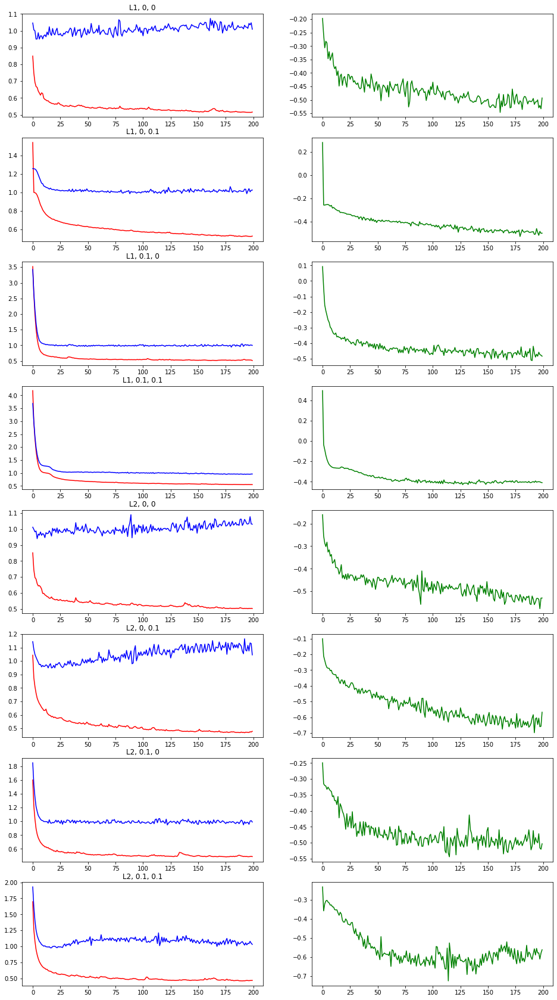

In [ ]:
plt.rcParams["figure.figsize"]=[16, 30]
for i in range(len(final_hists)):
  plt.subplot(8,2,2*i+1).set_title("{0}, {1}, {2}".format(final_hists[i][1][0].__name__, final_hists[i][1][1], final_hists[i][1][2]) )
  plt.plot(final_hists[i][0][0][0].history["loss"],"r")
  plt.plot(final_hists[i][0][0][0].history["val_loss"],"b")
  plt.subplot(8,2,2*i+2)
  plt.plot(np.asarray(final_hists[i][0][0][0].history["loss"])-np.asarray(final_hists[i][0][0][0].history["val_loss"]),"g")
plt.show()

Model: "functional_19"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_10 (InputLayer)        [(None, 8)]               0         
_________________________________________________________________
dense_27 (Dense)             (None, 500)               4500      
_________________________________________________________________
dense_28 (Dense)             (None, 500)               250500    
_________________________________________________________________
dense_29 (Dense)             (None, 1)                 501       
Total params: 255,501
Trainable params: 255,501
Non-trainable params: 0
_________________________________________________________________


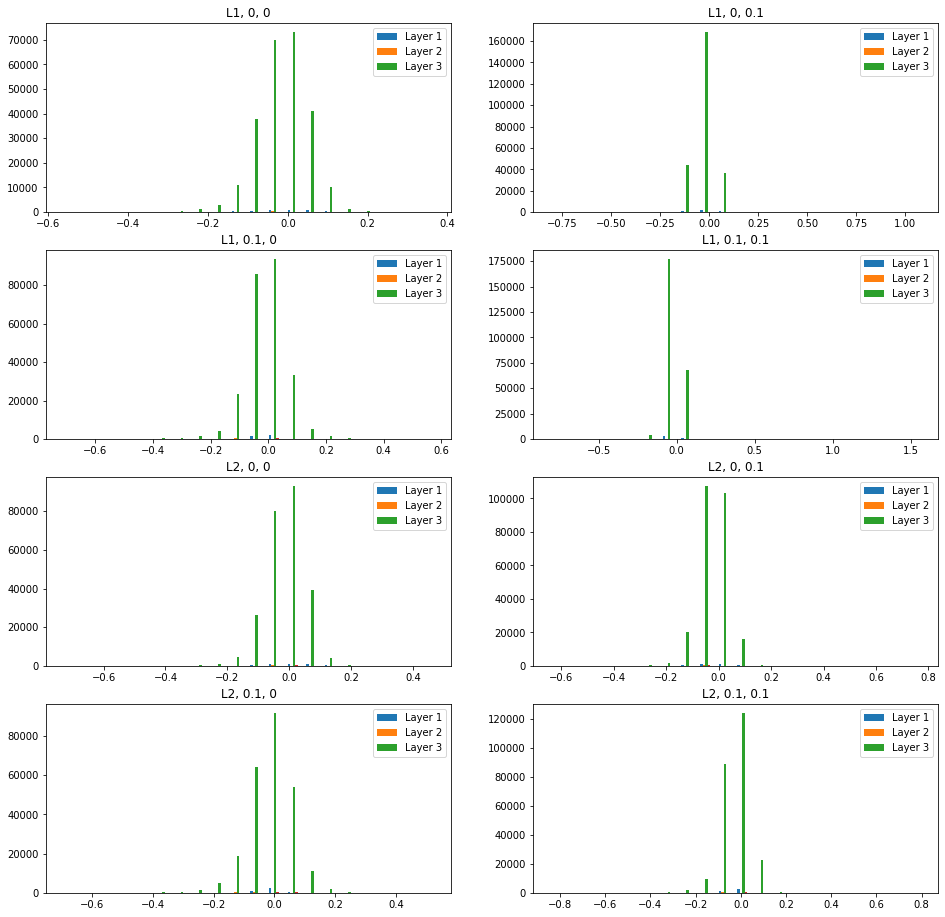

In [ ]:
plt.rcParams["figure.figsize"]=[16, 16]
for i in range(len(final_hists)):
  
  plt.subplot(4,2,i+1).set_title("{0}, {1}, {2}".format(final_hists[i][1][0].__name__, final_hists[i][1][1], final_hists[i][1][2]))
  plt.hist(final_hists[i][0][0][1] ,bins = 20, label = ["Layer 1", "Layer 2", "Layer 3"])
  plt.legend()

input_dense= input_layer.Input(shape=(8))
dense=layers.Dense(500, activation='relu',activity_regularizer=l1(0.1),use_bias=True, kernel_initializer="glorot_normal")(input_dense)
dense=layers.Dense(500, activation='relu',activity_regularizer=l1(0),use_bias=True, kernel_initializer="glorot_normal")(dense)
output_dense=layers.Dense(1, activation='relu',use_bias=True, kernel_initializer="uniform")(dense)
model=models.Model(inputs=input_dense, outputs=output_dense)
model.summary()

Para las 8 arquitecturas se tiene un comportamiento similar respecto a la resta del error de entrenamiento con el de validación, ya que luego de la epoch 25 la diferencia se asienta en el rango de [-0.6, -0.3] en la mayoría de los casos, alcanzando valores menores a -0.4 en las últimas epochs. 

Si nos fijamos en el error de entrenamiento y validación, se tiene que con L2 la diferencia entre estos es mayor, llegando a -0.5 en todas sus instancias. Además se puede ver que el comportamiento del error de validación es más irregular, y para los 2 primeros pares de valores de $\lambda$ este diverje, mientras que para los 2 últimos parece mantenerse constante, o con muy poca mejora luego de las primeras epoch.

En L1 las diferencias entre ambos errores es menor, además de presentar un comportamiento mucho más regular. Al igual que en L2, para los 2 primeros pares de valores de $\lambda$ se presenta un comportamiento divergente, mucho más sútil en el segundo experimento. Por otro lado, para los dos últimos se presentan gráficas más suaves en las que la diferencia de los errores se mantiene mucho más estable luego de cierta cantidad de epoch.

Por último, independiente del regularizador, se puede ver que con los valores de $\lambda_1 = 0.1$ y $\lambda_2=0.1$ junto con $\lambda_1 = 0.1$ y $\lambda_2=0$.

* ¿Cómo se comportarán los pesos de la red neuronal para la norma l1 y para la norma l2 en función de $\lambda$? 

  Los pesos se reducirán en función del lambda dado y se penalizará el error. En el caso de existir outliers, la norma l2 penalizará aún más el error debido al cuadrado de los pesos, lo que provocará que la regularización intente arreglarlo penalizando los pesos. En el caso de tener $\lambda$ igual a $0$, implica que el regularizador no es utilizado. 

  Si nos fijamos en la distribución de los pesos, se puede ver que estos estan mucho más concentrados cerca del cero con ambos $\lambda$ iguales a 0.1, con una cantidad de pesos cercano a los 120000 en este valor, mientras que en las otras solo llega a una cantidad cercana a 80000.


##### II) Experimentaremos con el método dropout. Probaremos con distintos valores de Dropout para ambas capas de la arquitectura presentada, de manera similar al punto anterior. Entrene 9 redes neuronales utilizando las combinaciones indicadas. **Visualizar, comparar y comentar** utilizando los errores de entrenamiento, validación y la resta entre ambos valores.

**Preguntas:** ¿Qué es/hace dropout? ¿Por qué es considerado un método de regularización?

In [ ]:
dropout_1st_layer=[0,0.3,0.6]
dropout_2nd_layer=[0,0.3,0.6]


# Define architecture
def dropout_1_d_ii(drop1, drop2):
  input_dense= input_layer.Input(shape=(8))
  dense=layers.Dense(500, activation='relu',use_bias=True, kernel_initializer="glorot_normal")(input_dense)
  dense=layers.Dropout(drop1)(dense)
  dense=layers.Dense(500, activation='relu',use_bias=True, kernel_initializer="glorot_normal")(dense)
  dense=layers.Dropout(drop2)(dense)
  output_dense=layers.Dense(1, activation='relu',use_bias=True, kernel_initializer="uniform")(dense)
  model=models.Model(inputs=input_dense, outputs=output_dense)
  # Compile model
  model.compile(optimizer=Adam(learning_rate=0.01),loss='mean_squared_error')
  # Train model
  hist = model.fit(x_tr, y_tr, epochs=200, verbose=0, validation_data=(x_val, y_val),callbacks=[History()])
  return hist

In [ ]:
dropout_hists = []
dropout_names = []
for drop1 in dropout_1st_layer:
  for drop2 in dropout_2nd_layer:
    dropout_hists.append(dropout_1_d_ii(drop1, drop2))
    dropout_names.append(str(drop1) + ", " + str(drop2))



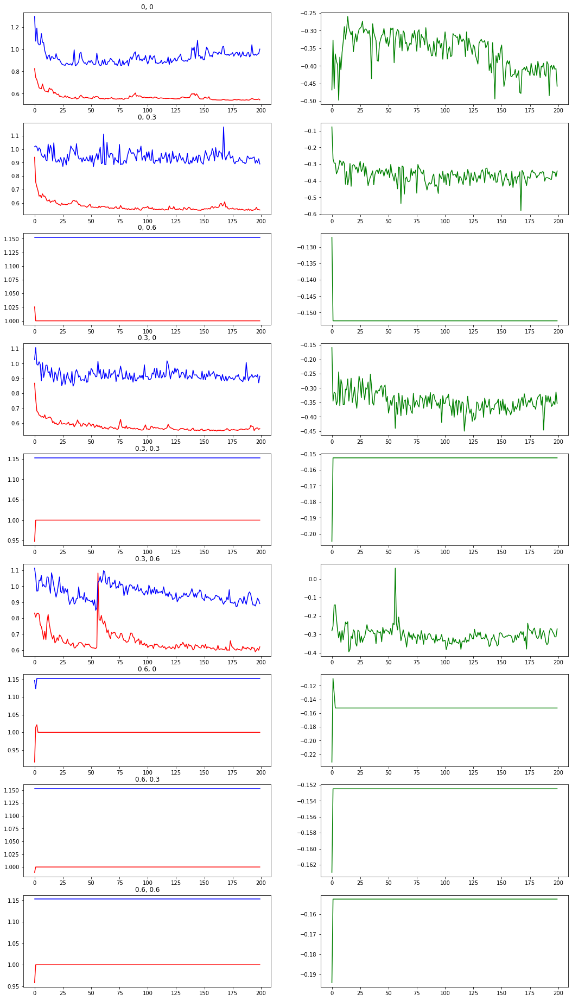

In [ ]:
plt.rcParams["figure.figsize"]=[18, 33]
for i in range(len(dropout_hists)):
  plt.subplot(9,2,2*i+1).set_title(dropout_names[i] )
  plt.plot(dropout_hists[i].history["loss"],"r")
  plt.plot(dropout_hists[i].history["val_loss"],"b")
  plt.subplot(9,2,2*i+2)
  plt.plot(np.asarray(dropout_hists[i].history["loss"])-np.asarray(dropout_hists[i].history["val_loss"]),"g")
plt.show()

Las arquitecturas con dropout 0-0.6, 0.3-0.3, 0.6-0, 0.6-0.3, 0.6-0.6 dieron resultados nulos luego del entrenamiento.

Las 4 redes restantes dieron resultados similares respecto a la diferencia de errores de entrenamiento y validación, rondando [-0.4, -0.3]. Sin embargo, las 3 primeras redes presentan un comportamiento más regular respecto a la con parámetros 0.3-0.6, en donde el error de entrenamiento se dispara en un momento. Con lo anterior se puede ver que los parámetros de dropout pueden afectar el entrenamiento de la red, y si estos llegan a ser muy altos, existe la posibilidad de que la red no logre obtener resultados. 

Se debe considerar además que al utilizar dropout se está entrenando una red con menos neuronas en las epoch, por lo que se podría tomar en cuenta aumentar la cantidad de neuronas en las capas densas, ya que actualmente se está intentando obtener una red que de similares resultados pero a través de una cantidad de neuronas menor.

Dropout es una técnica de regularización que de manera aleatoria desactiva una cantidad de neuronas de la red neuronal, de esta manera genera el efecto de simular bastantes redes con una estructura distinta. Es un método de regularización puesto se realizan modificaciones en la forma de entrenar la red, que en este caso nos ayuda reduciendo el aprendizaje interdependiente entre las neuronas de tal manera que podría mejorar el error de generalización y disminuir el sobreajuste de un modelo obtenido.

## 1.e Extreme Learning Machines

##### I) Una aproximación para obtener modelos grandes que no sobreajustan es la implementada por ELM. Explique en qué consiste la idea de ELM y por qué esto podría evitar sobreajuste a pesar de utilizar modelos con gran número de parámetros.

Entrene una ELM de una capa fija y una capa oculta, la primera con un número relativamente grande. Puede utilizar los valores propuestos en el código u otros que le parezcan convenientes.

Comente sobre el número total de parámetros y el número de parametros entrenables con respecto a los modelos anteriores. 

**Preguntas:** ¿Cómo se desempeña la red? ¿El número elevado de parámetros totales implica necesariamente _overfitting_?

Las máquinas de aprendizaje extremo son redes neuronales de retroalimentación para clasificación, regresión, agrupación, aproximación dispersa, compresión y aprendizaje de características con una sola capa o múltiples capas de nodos ocultos, donde los parámetros de los nodos ocultos (no solo los pesos que conectan las entradas a los nodos ocultos) necesitan no estar tuneados.
ELM no requiere backpropagation para funcionar. Utiliza la pseudoinversa Moore-Penrose para establecer los pesos de la red.
La máquina de aprendizaje extremo (ELM) se usa ampliamente en el aprendizaje por lotes, el aprendizaje secuencial y el aprendizaje incremental debido a su velocidad de aprendizaje rápida y eficiente, su rápida convergencia, su buena capacidad de generalización y su facilidad de implementación.

Los parámetros para inicializar una ELM son 3:
* El número de neuronas de la capa oculta
* Funciones de activación
* Pesos iniciales de la red que se generan siguiendo una distribución uniforme continua.

Lo único que acá se "entrena" son los pesos de la output layer, que en este caso se calculan minimizando el error cuadrático medio entre el target y el output, utilizando la solución de mínimos cuadrados de la forma:
$$ \beta = H^+T $$. 

donde $H^+$ es la  pseudoinversa Moore-Penrose de la matriz $H$, y $T$ es nuestro target.

Además, se debe considerar que esto se realiza una sola vez.

Finalmente para el caso de una ELM con 5000 neuronas de la capa oculta se entrenarían 5001 parámetros para la capa de output, lo cual es significativamente menor en comparación con las demás redes que hemos entrenado anteriormente. Por ejemplo para la pregunta anterior de dropout se tienen que entrenar $4500 + 250500 + 501 = 255501$ parámetros en total.

Para la explicación anterior y la posterior implementación se usó de referencia los siguientes links:

* https://towardsdatascience.com/introduction-to-extreme-learning-machines-c020020ff82b

* https://towardsdatascience.com/build-an-extreme-learning-machine-in-python-91d1e8958599

* https://www.kaggle.com/robertbm/extreme-learning-machine-example

A continuación se implementará una ELM y se testearán distintas arquitecturas para la capa oculta, en este caso serán $5000, 15000, 50000, 100000,200000$ neuronas para finalmente calcular el error de testing y comparar.

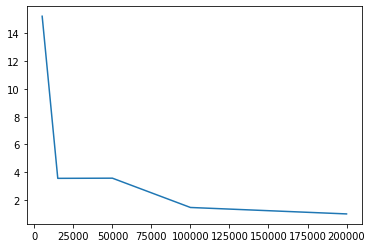

In [ ]:
from scipy.linalg import pinv2

def relu(x):
   return np.maximum(x, 0, x)

def hidden_nodes(X):
    G = np.dot(X, input_weights)
    G = G + biases
    H = relu(G)
    return H

def predict(X):
    out = hidden_nodes(X)
    out = np.dot(out, output_weights)
    return out

arr = [5000, 15000, 50000, 100000, 200000]
toPrint = []
for hsize in arr:
  input_size = x_tr.shape[1]
  hidden_size = hsize
  #Inicializacion de pesos con distribucion uniforme
  input_weights = np.random.uniform(-1., 1., size=[input_size,hidden_size])
  biases = np.random.uniform(-1., 1., size=[hidden_size])

  #Calculo de pesos de la outputlayer
  #pinv2 nos da la pseudinversa
  output_weights = np.dot(pinv2(hidden_nodes(x_tr)), y_tr)

  prediction = predict(x_test)
  test_batch_loss=tf.keras.losses.MSE(y_test, prediction)
  test_loss=tf.math.reduce_mean(test_batch_loss).numpy()
  toPrint.append(test_loss)

plt.plot(arr, toPrint)
plt.show()

In [ ]:
print(toPrint)

[15.234028034642645, 3.5592156032175684, 3.5714337067435054, 1.4610592158577385, 0.9973091878183337]


Como podemos apreciar en el gráfico anterior, si aumentamos la cantidad de neuronas, el error de testing baja significativamente. Tenemos que tener en cuenta también que la cantidad de parámetros los cuales se entrenan siguen siendo menores que las arquitecturas probadas en ejercicios anteriores, teniendo un buen resultado.

# 2. Reconocimiento de lenguaje de señas

Una de las áreas donde las redes neuronales han obtenido desempeños decisivamente superiores al resto de los métodos existentes, al menos en su momento, es en el reconocimiento de imágenes. La capacidad de las redes convolucionaes de aprender y extraer patrones sobre patrones hasta obtener características de alto nivel, representativas de atributos de las imágenes, ha permitido desempeños superiores a los obtenidos por otros métodos de aprendizaje automático o inteligencia aritificial, e incluso en algunos casos al desempeño humano.

Una de las tareas usuales que se pueden resolver con redes neuronales convolucionales es la clasificación de imágenes. Para este punto nos basaremos en un dataset de lenguaje de señas, su descripción detallada se puede encontrar en https://www.kaggle.com/datamunge/sign-language-mnist (No es necesario descargar directamente el dataset si está usando _Colab_ como es sugerido)

<h1 align='center'> <img src="https://i1.wp.com/25.media.tumblr.com/tumblr_mdcs1cF4nn1ri2o31o1_1280.png" width="100%" height="30%" /> </h1>


Note que el entrenamiento de redes convolucionales se beneficia particularmente del uso de unidades de procesamiento gráfico, por lo cual podría ser recomendable utilizarlas en caso de disponer, o considerar correr los codigos completos una vez verificado su funcionamiento en una sesión de Collab acelerada por GPU, entre otras opciones de GPU en la nube existentes.

## 2.a Carga de datos y visualizaciones

##### I) Iniciaremos cargando los datos. Para esto necesitará crear una cuenta en kaggle, dirigirse a su perfil, ir a Account, y en la sección API apretar _Create new API token_ , se descargará un archivo kaggle.json, ábralo como archivo de texto y obtenga su username y key. Luego ejecute el siguiente código (desconozco por qué pero a veces hay que ejecutar el código 2 veces para que funcione). Solución obtenida desde el hilo: https://gist.github.com/jayspeidell/d10b84b8d3da52df723beacc5b15cb27

In [ ]:
username="kevinalexanderlagos"
key="96b5054427cbbcc6be8945b792ba129f"
!pip install -q kaggle
api_token = {"username":username,"key":key}
import json
import zipfile
import os
os.environ['KAGGLE_USERNAME'] = str(username)
os.environ['KAGGLE_KEY'] = str(key)
!kaggle datasets download -d datamunge/sign-language-mnist
if not os.path.exists("/content/competitions/data_sign"):
    os.makedirs("/content/competitions/data_sign")
os.chdir('/content/competitions/data_sign')
for file in os.listdir():
    if file[-4:]==".zip":
      zip_ref = zipfile.ZipFile(file, 'r')
      zip_ref.extractall()
      zip_ref.close()
!ls

 78% 49.0M/62.6M [00:00<00:00, 51.8MB/s]
100% 62.6M/62.6M [00:00<00:00, 107MB/s] 
american_sign_language.PNG  sign-language-mnist.zip  sign_mnist_train
amer_sign2.png		    sign_mnist_test	     sign_mnist_train.csv
amer_sign3.png		    sign_mnist_test.csv


Si en el siguiente código obtiene error de directorio ejecutar de nuevo celda superior

In [ ]:
import pandas as pd
import numpy as np
df_tr=pd.read_csv("sign_mnist_train.csv")
X_tmp=df_tr.values[:,1:].reshape(-1,28,28,1)
Y_tmp=df_tr.values[:,:1]
df_tst=pd.read_csv("sign_mnist_test.csv")
X_tst=df_tst.values[:,1:].reshape(-1,28,28,1)
Y_tst=df_tst.values[:,:1]

Para evitar largos tiempos de entrenamiento y hacer más desafiante el problema, sacrificaremos data de entrenamiento. **Ejectuar el siguiente código**. Mantendremos el tamaño del conjunto de test.

In [ ]:
from sklearn.model_selection import StratifiedShuffleSplit
sf=StratifiedShuffleSplit(n_splits=1, test_size=2000, random_state=0)
for smaller_index,data_index in sf.split(X_tmp, Y_tmp): # en realidad este método está pensado para hacer cross-validation con clases balanceadas,
                                                                        # ahora lo ocupamos solamente para extraer 1200 observaciones manteniendo la proporción de clases
                                                                          # del dataset original
    x_tmp=X_tmp[data_index]
    y_tmp=Y_tmp[data_index]

##### II) **Visualice** algunas imágenes de cada una de las catégorias junto con sus nombres. 

**Preguntas:** ¿Qué pares de categorías cree podrían ocasionar problemas al momento de clasificación? ¿Por qué hay letras omitidas (inferir viendo abecedario de lenguaje de señas americano)? ¿Las categorías están balanceada? ¿Cuántos canales están disponibles?

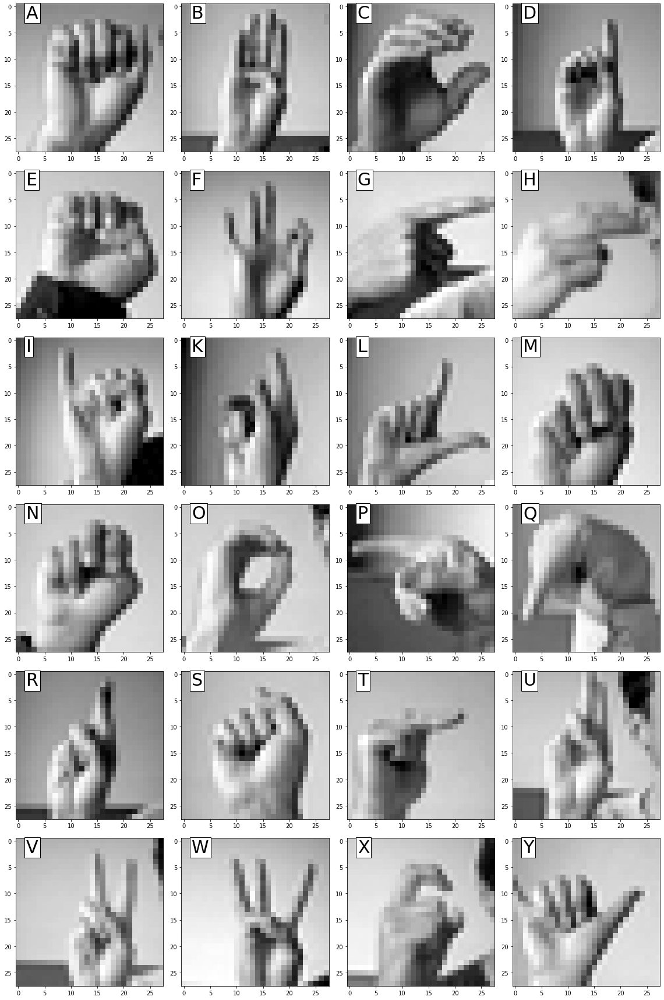

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.ticker as mticker
plt.rcParams["figure.figsize"]=[16,24]
letters=["A","B","C","D","E","F","G","H","I","K","L","M","N","O","P","Q","R","S","T","U","V","W","X","Y"]
fig, axs = plt.subplots(6,4)
axs = axs.flatten()

for i,ax in enumerate(axs):
  if i >= 9:
    letter_index = i + 1
  else:
    letter_index = i
  ax.imshow(x_tmp[np.where(y_tmp[:,0]==letter_index)[0][0],:,:,0], cmap = "gray") # arreglar error 
  ax.text(1.5, 2.2, letters[i], bbox={'facecolor': 'white', 'pad': 3},fontsize=30)

plt.tight_layout()
plt.show()

Letras omitidas se deben a que son con movimiento, por lo que no podríamos clasificar esas letras ya que debería ser un video.

Categorías que podrían causar problemas:
* El grupo A, E, M, N, S (en todas se presenta un puño)
* G y H
* D y U
* K y V
* R y U

Las categorías anteriores fueron elegidas puesto que sus representaciones son bastante similares, por lo que al momento de aprender podrían generar confusión al modelo.

Además, existe solamente 1 canal que en este caso sería para representar las imágenes de 28x28 pixeles en escala de grises con un valor que va en el rango $[0,255]$.

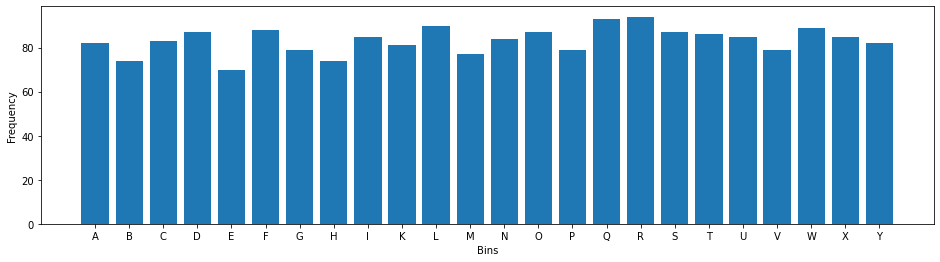

(2000, 28, 28, 1)


In [ ]:
def print_frecuency(y_set):
  unique, counts = np.unique(y_set, return_counts=True)
  d = dict(zip(unique, counts))

  y = list()
  for key, valor in d.items():
    y.append(valor)
  plt.rcParams["figure.figsize"]=[16,4]
  plt.bar(letters,y,align='center')
  plt.xlabel('Bins')
  plt.ylabel('Frequency')
  plt.show()

print_frecuency(y_tmp)
print(x_tmp.shape)

Podemos ver en el gráfico anterior, que las clases están balanceadas para todas las letras, teniendo un total de 2000 datos.

## 2.b Preprocesamiento

Conforme el conjunto en entrenamiento y validacion a partir de x_tmp e y_tmp con proporciones de 80% y 20% respectivamente, preocúpese de que los conjuntos de entrnamiento y validación mantengan la proporción (aprox.) para cada clase (mantener equilibrio de clases), inspírese en el código utilizado para reducir la cantidad de datos (sección 2.a). Transforme la escala de las imágenes, de $[0,255]$ a $[-1,1]$. Utilice la función `get_dummies` de pandas para transformar $y$ a _encodding_ _one hot vector_. 

**Preguntas:**
¿Perdemos información con este preprocesamiento? ¿Qué representa cada uno de los valores de la tupla `x_tr.shape`? 

¿Podemos considerar los valores de $y$ como valores numéricos o debemos transformarlos de alguna forma? ¿Por qué? 

¿Cómo se transforma el `.shape` de $y$?

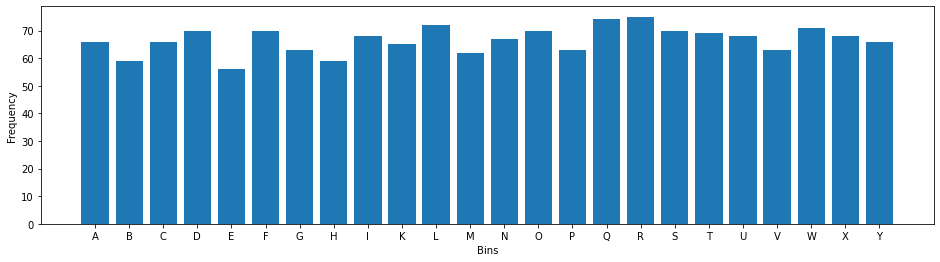

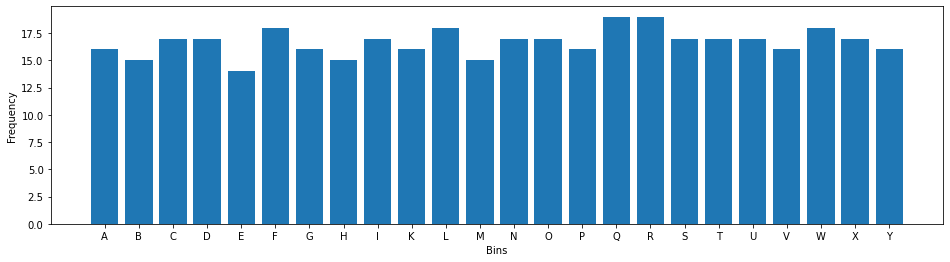

(1600, 28, 28, 1)
(1600, 1)
(1600, 24)


In [ ]:
import numpy as np
from sklearn.model_selection import StratifiedShuffleSplit # <- suggestion
from keras.utils.np_utils import to_categorical
sss = StratifiedShuffleSplit(n_splits=1, test_size=0.2, random_state=0)
sss.get_n_splits(x_tmp, y_tmp)
for train_index, test_index in sss.split(x_tmp, y_tmp):
  x_tr, x_val = x_tmp[train_index], x_tmp[test_index]
  y_tr, y_val = y_tmp[train_index], y_tmp[test_index]


print_frecuency(y_tr)
print_frecuency(y_val)

print(x_tr.shape)
x_tr = x_tr/127.5 - 1
x_val = x_val/127.5 - 1
X_tst = X_tst/127.5 - 1
print(y_tr.shape)
y_tr = pd.get_dummies(y_tr[:,0],len(letters)).values
y_val = pd.get_dummies(y_val[:,0],len(letters)).values
Y_tst = pd.get_dummies(Y_tst[:,0],len(letters)).values
print(y_tr.shape)

* Como podemos ver en los histogramas anteriores, tanto para el conjunto de entrenamiento y de test todas las clases se ven balanceadas, independiente del split 80% 20% que se realizó.

* No se pierde información en este preprocesamiento, puesto que se aplica solamente una transformación lineal sobre los pixeles. Por otra parte, para transformar y en un one hot vector tampoco perdemos información, lo único que hacemos es cambiar la manera de representar nuestro output de tal manera que pueda ser entendido en este caso por un algoritmo de machine-learning.

* Los valores de x_tr.shape corresponderían a (cantidad de datos, largo, ancho, canales). Para nuestro caso, serían 1600 datos, con imágenes de 28x28 pixeles y con 1 solo canal.

* No se debería considerar como valores numéricos, ya que corresponden a categorías (0: A, 1:B, ...), sería más una variable categórica cuantitativa y al dejarlo como números el modelo podría interpretar que existe una relación de orden entre estas. Debemos transformarlos a un one hot vector ya que es la manera de representar estos datos en un vector binario para evitar esta confusión que se le puede dar al modelo de la existencia de un orden entre categorías. Para simplemente volver atrás respecto a la variable $y$ se debe buscar el índice en el vector donde su valor sea $1$ y esa será la letra correspondiente a la imagen.

* Se transforma de (1600,1) a (1600,24), puesto que nuestro nuevo $y$ contiene vectores con 24 componentes en total, siendo este largo la cantidad de letras que son representadas por el conjunto de imágenes proporcionado, donde el índice $i$ en el vector tiene un valor $1$ si el output representa a la letra asociada a ese índice y $0$ en caso contrario.

## 2.c Primera red Convolucional

Entrenaremos una primera red convolucional sobre los datos, con la mayoría de los parámetros por defecto. Cree primero la red siguiendo la estructura $C\times P\times C\times P \times D$ donde $C$ representa una capa convolucional, $P$ una capa de _Max pooling_ y $D$ una capa densa. Note que antes de la capa densa debe agregar una capa _Flatten_ que transforma los filtros a vectores que luego pueden ser utilizados por la capa densa. 

Para los parámetros de las capas, fijaremos ambas capas convolucionales con 128 filtros de $3\times 3$, stride por default, y _padding 'same'_ (es decir agregaremos 0 a los bordes de la imágen de tal manera que se preserve la dimiensión de la imágen al atravesar la capa; y las capas de _pooling_ tendrán tamaño y _stride_ $2\times 2$, como muestra el código. **Note que a diferencia de la pregunta 1 aprovecharemos al máximo el lenguaje high-level keras.**

Utilice el método `.summary` del modelo para ver la cantidad de parámetros y las dimensiones de los outputs de cada capa (note que cómo en la primera capa especificamos el `input_shape` podemos llamar el método antes de compilar el modelo o de pasarle datos. **Justifique** el número parámetros y el _Output Shape_ de cada capa en función de la estructura de la red y lo aprendido en clases. 

**Preguntas:**

¿Por qué la capa de salida debe tener 24 neuronas? ¿Qué operación efectúa la activación _SoftMax_? ¿Qué representaría en terminos del problema el vector de salida de la red?

In [ ]:
from keras.models import Sequential
from keras.layers import Dense, Flatten
from keras.layers import Conv2D, MaxPooling2D

model = Sequential()

#Primera capa C x P
model.add(Conv2D(filters=128,
                 kernel_size=(3, 3),
                 padding='same',
                 activation='relu',
                 input_shape=x_tr.shape[1:]))
model.add(MaxPooling2D(pool_size=(2, 2)))

#Segunda capa C x P 
model.add(Conv2D(filters=128,
                 kernel_size=(3, 3),
                 padding='same',
                 activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

#Capa flatten y D
model.add(Flatten())    
model.add(Dense(units=24, activation='softmax')) # output

    
# summary
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 28, 28, 128)       1280      
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 14, 14, 128)       0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 14, 14, 128)       147584    
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 7, 7, 128)         0         
_________________________________________________________________
flatten (Flatten)            (None, 6272)              0         
_________________________________________________________________
dense (Dense)                (None, 24)                150552    
Total params: 299,416
Trainable params: 299,416
Non-trainable params: 0
__________________________________________________

* Debe tener una neurona de salida por cada clase que queremos predecir, como existen en este caso 24 letras, deben existir 24 neuronas en la capa de salida.

* Efectúa una normalización de un vector de las neuronas de la capa de salida, normalizándolo de tal manera que la suma de las respuestas de cada neurona sean iguales a 1 (debido a la suma de probabilidades). La operación que realiza es la siguiente:

$$ P(y=j | x) = \frac{e^{x^Tw_j}}{\Sigma_{k=1}^{24} e^{x^Tw_k}}$$

* Representaría la probabilidad de que el input sea cada una de las letras existentes.

## 2.d Primer entrenamiento

##### I) Compile la red definida en el item anterior. Para esta pregunta puede usar los optimizadores configurados por defecto, y debe usar como _loss_ _Categorical Crossentropy_.

Entrene la red hasta observar convergencia recuperando su `history`. Grafique como varia el _accuracy_ en entrenamiento y validación a lo largo del aprendizaje. Adicionalmente calcule el accuracy para todo el conjunto de test. Mida igualmente el _categorical accuracy_ como se muestra en el código.  

**Preguntas:**

¿Por qué preferimos medir _crossentropy_ y no por ejemplo _MSE_ en este problema? ¿Qué valor representa el _accuracy_? ¿Le parece buena medida de desempeño para este problema? ¿Por qué luego de lograr un accuracy de 100% en el conj. de entrenamiento siguen actualizándose los pesos de la red? ¿A qué corresponde cada valor de la lista que retorna model.evaluate?

**Recordar usar entorno GPU en _Colab_**

In [ ]:
from keras.callbacks import History, EarlyStopping
import tensorflow as tf

my_callbacks = [History(), # Returns validation and training loss
    EarlyStopping(patience=100,monitor="val_loss", #Stops training when the validation loss doesnt get better in n°patience consecutive epochs,keep it at 100 it's only to show u
                                     restore_best_weights=True)]

model.compile(optimizer='adam',loss='categorical_crossentropy',metrics=['acc'])
history = model.fit(x_tr, y_tr, epochs=20, validation_data=(x_val,y_val),verbose=0,callbacks=[History()])

In [ ]:
acc_tst = model.evaluate(X_tst, Y_tst, verbose=0)

[0.6055118441581726, 0.8813441395759583]


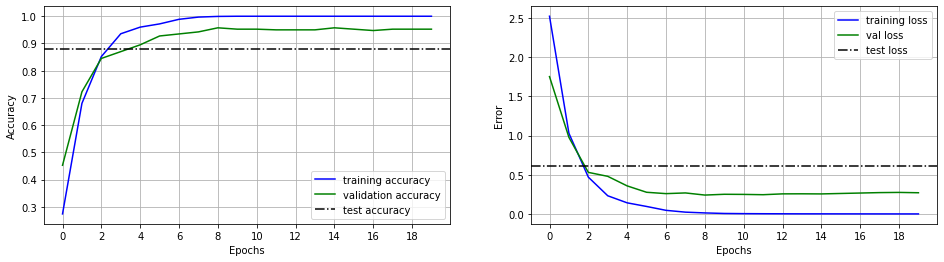

In [ ]:
plt.subplot(1,2,1)
plt.plot(history.history["acc"],"b-", label="training accuracy")
plt.plot(history.history['val_acc'], "g-", label="validation accuracy")
plt.axhline(y=acc_tst[1],color="k",linestyle="-.",label="test accuracy")
plt.xlabel("Epochs"),plt.ylabel("Accuracy")
plt.legend(),plt.grid()
plt.gca().xaxis.set_major_locator(mticker.MultipleLocator(2))
#...
plt.subplot(1,2,2)
plt.plot(history.history["loss"],"b-", label="training loss")
plt.plot(history.history["val_loss"],"g-",label="val loss")
plt.axhline(y=acc_tst[0],color="k",linestyle="-.",label="test loss")
plt.xlabel("Epochs"),plt.ylabel("Error")
plt.legend(),plt.grid()
plt.gca().xaxis.set_major_locator(mticker.MultipleLocator(2))
print(acc_tst)

* Crossentropy se utiliza para medir el rendimiento de un modelo cuyo output tiene probabilidades entre 0 y 1, donde se busca maximizar la semejanza de una distribución multinomial castigando los casos en el que se predice una clase errónea (cosa que no lo hace el MSE). Como estamos actualmente intentando clasificar imágenes de distintas clases, nos importa mucho el hecho de obtener un output correcto, siendo crossentropy una buena medida para este caso.
* El accuracy representa el número total de aciertos de clasificación dividido en el número total de clasificaciones.
* Nos parece una buena medida de desempeño, puesto que el accuracy del conjunto de test es de alrededor de un 88%.
* La red se sigue entrenando puesto que en los parámetros, la red detiene su entrenamiento si es que el val_loss no mejora en un número consecutivo de epochs. Podemos ver también que el hecho de tener un 100% de accuracy en el conjunto de entrenamiento no quiere decir que nuestro modelo esté listo, ya que se puede ver que en el primer gráfico una vez el accuracy del conjunto de entrenamiento llega al 100%, en las siguientes epochs el accuracy del conjunto de validación sigue subiendo.
* model.evaluate() entrega para nuestro caso dos valores, el primero corresponde al test loss y el segundo corresponde a las métricas que para nuestro caso sería el accuracy del modelo al evaluar el conjunto de test.

## 2.e Bloque $C\times C\times P$

Una práctica usual en redes convolucionales es apilar más de un filtro convolucional antes de aplicar _pooling_. La idea detras de esto es darle más "espacio" a la red para aprender los patrones relevantes antes de realizar el subsampleo mediante _pooling_. En el caso de este _dataset_ también nos permite agregar más capas convolucionales sin reducir tan fuertemente la dimensión de las imagenes filtradas. Incluso muchos investigadores optan por agregar más de una capa densa el final de la red, para dar aún más libertad al modelo, pues las restricciones impuestas sobre los parámetros por la estructura convolucional parecieran restringir lo suficiente al modelo, más libertad en las capas finales no pareciera implicar un _overfitting_ tan fuerte como sería por ejemplo en una red _Fully Connected_.

**Cree y entrene** una red, utilizando **dos bloques** de dos capas convolucionales y una de _maxpool_ y luego dos capas densas, es decir $C\times C\times P \times C\times C\times P\times D \times D$. Utilice $128$ filtros $3\times 3$ en las dos primeras convolucionales y $64$ filtros $3\times 3$ en las dos siguientes. Para ambas capas de _maxpool_ utilice tamaño y _stride_ $2\times 2$. 

**Comente** como se compara el desempeño con las redes anteriores. Apóyese de gráficos y valores numéricos. 

In [ ]:
model = Sequential()

#Primera capa C x C x P
model.add(Conv2D(filters=128,
                 kernel_size=(3, 3),
                 padding='same',
                 activation='relu',
                 input_shape=x_tr.shape[1:]))
model.add(Conv2D(filters=128,
                 kernel_size=(3, 3),
                 padding='same',
                 activation='relu',
                 input_shape=x_tr.shape[1:]))
model.add(MaxPooling2D(pool_size=(2, 2)))

#Segunda capa C x C x P 
model.add(Conv2D(filters=64,
                 kernel_size=(3, 3),
                 padding='same',
                 activation='relu'))
model.add(Conv2D(filters=64,
                 kernel_size=(3, 3),
                 padding='same',
                 activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

#Capa flatten y D
model.add(Flatten())    
model.add(Dense(units=512, activation='sigmoid')) # output
model.add(Dense(units=24, activation='softmax')) # output

    
# summary
model.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_2 (Conv2D)            (None, 28, 28, 128)       1280      
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 28, 28, 128)       147584    
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 14, 14, 128)       0         
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 14, 14, 64)        73792     
_________________________________________________________________
conv2d_5 (Conv2D)            (None, 14, 14, 64)        36928     
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 7, 7, 64)          0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 3136)             

In [ ]:
my_callbacks = [History(), # Returns validation and training loss
    EarlyStopping(patience=100,monitor="val_loss", #Stops training when the validation loss doesnt get better in n°patience consecutive epochs,keep it at 100 it's only to show u
                                     restore_best_weights=True)]

model.compile(optimizer='adam',loss='categorical_crossentropy',metrics=['acc'])
history = model.fit(x_tr, y_tr, epochs=20, validation_data=(x_val,y_val),verbose=0,callbacks=[History()])

In [ ]:
acc_tst = model.evaluate(X_tst, Y_tst, verbose=0)

[0.31791386008262634, 0.9023982286453247]


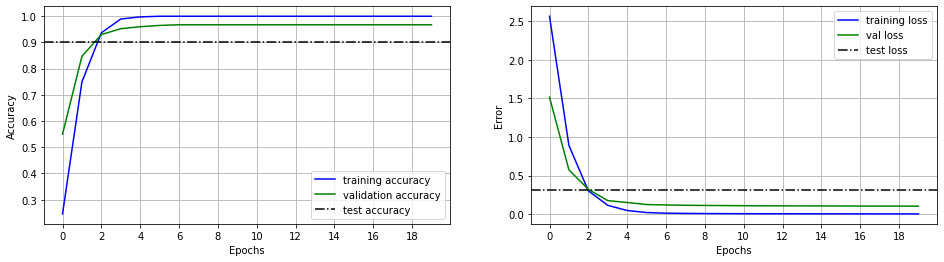

In [ ]:
plt.subplot(1,2,1)
plt.plot(history.history["acc"],"b-", label="training accuracy")
plt.plot(history.history['val_acc'], "g-", label="validation accuracy")
plt.axhline(y=acc_tst[1],color="k",linestyle="-.",label="test accuracy")
plt.xlabel("Epochs"),plt.ylabel("Accuracy")
plt.legend(),plt.grid()
plt.gca().xaxis.set_major_locator(mticker.MultipleLocator(2))
#...
plt.subplot(1,2,2)
plt.plot(history.history["loss"],"b-", label="training loss")
plt.plot(history.history["val_loss"],"g-",label="val loss")
plt.axhline(y=acc_tst[0],color="k",linestyle="-.",label="test loss")
plt.xlabel("Epochs"),plt.ylabel("Error")
plt.legend(),plt.grid()
plt.gca().xaxis.set_major_locator(mticker.MultipleLocator(2))
#...
print(acc_tst)
#...

* Podemos ver que el accuracy de la red mejoró en un 2% respecto a la arquitectura de la pregunta anterior. Por otro lado, vemos que el test_loss también disminuyó bastante de 0.6 a 0.33.

* En esta arquitectura también se puede visualizar que la red llegó a un accuracy del 100% para el conjunto de entrenamiento en la epoch 5, donde se ve una convergencia más rápida por la curva de la gráfica en esta arquitectura que en la anterior.

## 2.f Exploración de profundidad

Por comodidad preferiremos quedarnos con la estructura en bloques del item anterior. En esta pregunta deberán explorar qué ocurre a medida uno cambia la profundidad de la red. Para esto, entrene redes con distintos números de bloques. Debe a lo menos entrenar una red por cada número de bloques entre 1 y 4 bloques (**¿Qué particularidad tiene la red con 4 bloques? ¿Puede entrenar una más profunda?**). También entrenar una red con "0" bloques, es decir una red densa como las de la pregunta 1. 

Comente sobre los casos extremos (0 bloques y 4 bloques), ya sea a partir de lo aprendido en clases o lo que observa al momento de entrenar las redes. **¿Le parece que alguno de los dos sea buena aproximación para reconocimiento de imágenes?** Para cada red recupere `history` y grafique el valor del mejor _accuracy_ en validación y el _accuracy_ sobre entrenamiento en el mismo _epoch_ en función de la profundidad de la red, similar al procedimiento realizado en 1.c.

Quedan a su discreción los parámetros de cada capa convolucional, puede utilizar el número de filtros que estime convenientes, utilice _stride_ por default, y en caso de utilizar alguna regla para el número de filtros, que tal regla sea la misma para todas las profundidades (pueden ver dos posibles ejemplos en el código propuesto abajo). Para las capas de _MaxPool_ utilicen las que aparecen en el código.

Para ahorrar tiempo, si observa que una red no converge, puede detener anticipadamente el entrenamiento. Para esto es recomendable usar el _Callback_ de keras `EarlyStopping` el cual deben agregar al momento de utilizar el método `.fit` (ejemplo similar en pregunta 1 y pregunta 2.d), sin embargo asegúrese de ponerle _patience_ de a lo menos 10, pues como podrá observar algunas redes empeoran su desempeño en algunas _epochs_ para luego seguir mejorando. Puede elegir monitorear la métrica que estime conveniente para esta pregunta. 


In [ ]:
blocks = [0,1,2,3,4]

savedResults = list()
for block_num in blocks:
    model = Sequential()
    neuronas = 128

    for i in range(block_num):
        model.add(Conv2D(neuronas, (3,3),padding='same',activation='relu'))
        model.add(Conv2D(neuronas, (3,3), padding='same', activation='relu'))
        model.add(MaxPooling2D(pool_size=(2, 2)))
        neuronas /= 2
        
    #Capa flatten y D
    model.add(Flatten())    
    model.add(Dense(units=512, activation='sigmoid')) # output
    model.add(Dense(units=24, activation='softmax')) # output
    my_callbacks = [History(), # Returns validation and training loss
    EarlyStopping(patience=100,monitor="val_loss", #Stops training when the validation loss doesnt get better in n°patience consecutive epochs,keep it at 100 it's only to show u
                                     restore_best_weights=True)]
    model.compile(optimizer='adam',loss='categorical_crossentropy',metrics=['acc'])
    history = model.fit(x_tr, y_tr, epochs=20, validation_data=(x_val,y_val),verbose=0,callbacks=[History(), EarlyStopping()])
    acc_tst = model.evaluate(X_tst, Y_tst, verbose=0)
    savedResults.append((history, acc_tst))
    print("Red con {0} bloques entrenada".format(block_num))
    # compile
    # train and save results

Red con 0 bloques entrenada
Red con 1 bloques entrenada
Red con 2 bloques entrenada
Red con 3 bloques entrenada
Red con 4 bloques entrenada


'\nprint(tr_list.index(np.max(tr_list)))\nprint(val_list.index(np.max(val_list)))\nprint(tr_list)\nprint(val_list)\n'

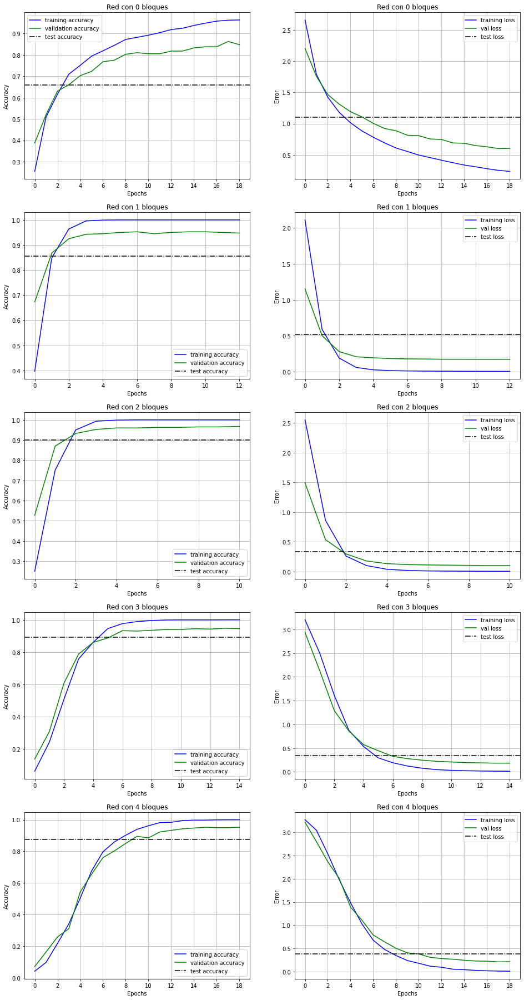

In [ ]:
val_list = list()
tr_list = list()

plt.rcParams["figure.figsize"]=[16,32]
for i in blocks:
  plt.subplot(5,2,2*i+1)
  plt.title("Red con {0} bloques".format(i))
  plt.plot(savedResults[i][0].history["acc"],"b-", label="training accuracy")
  plt.plot(savedResults[i][0].history['val_acc'], "g-", label="validation accuracy")
  plt.axhline(y=savedResults[i][1][1],color="k",linestyle="-.",label="test accuracy")
  plt.xlabel("Epochs"),plt.ylabel("Accuracy")
  plt.legend(),plt.grid()
  plt.gca().xaxis.set_major_locator(mticker.MultipleLocator(2))
  #...
  plt.subplot(5,2,2*i+2)
  plt.title("Red con {0} bloques".format(i))
  plt.plot(savedResults[i][0].history["loss"],"b-", label="training loss")
  plt.plot(savedResults[i][0].history["val_loss"],"g-",label="val loss")
  plt.axhline(y=savedResults[i][1][0],color="k",linestyle="-.",label="test loss")
  plt.xlabel("Epochs"),plt.ylabel("Error")
  plt.legend(),plt.grid()
  plt.gca().xaxis.set_major_locator(mticker.MultipleLocator(2))

Accuracy del conjunto de entrenamiento

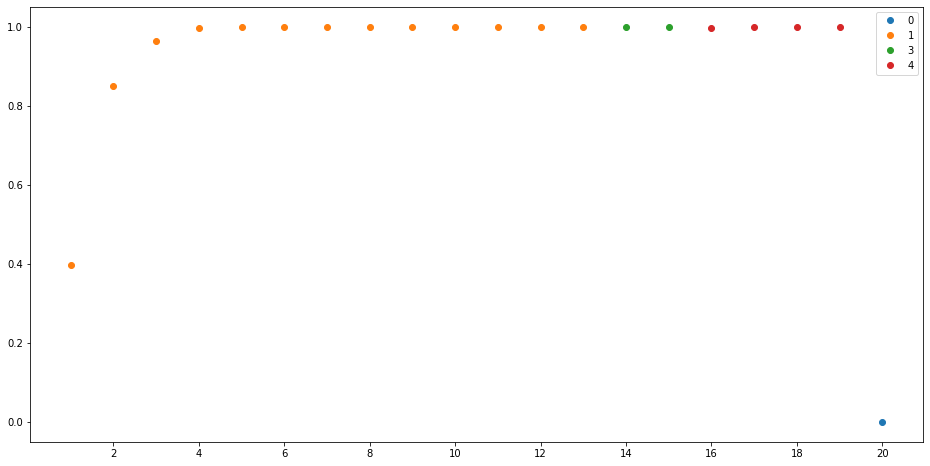

In [ ]:
epochs = range(1,21)
y = list()
labels = list()
for epoch in range(20):
  acc_list = list()
  for i in blocks:
    try:
      acc_list.append(savedResults[i][0].history["acc"][epoch])
    except:
      acc_list.append(0)
  maximum = np.max(acc_list)
  y.append(maximum)
  labels.append(acc_list.index(maximum))

plt.rcParams["figure.figsize"]=[16,8]
data = pd.DataFrame({"X Value": epochs, "Y Value": y, "Category": labels})
groups = data.groupby("Category")
for name, group in groups:
    plt.plot(group["X Value"], group["Y Value"], marker="o", linestyle="",label=name)
plt.legend()
plt.gca().xaxis.set_major_locator(mticker.MultipleLocator(2))


Accuracy del conjunto de validación

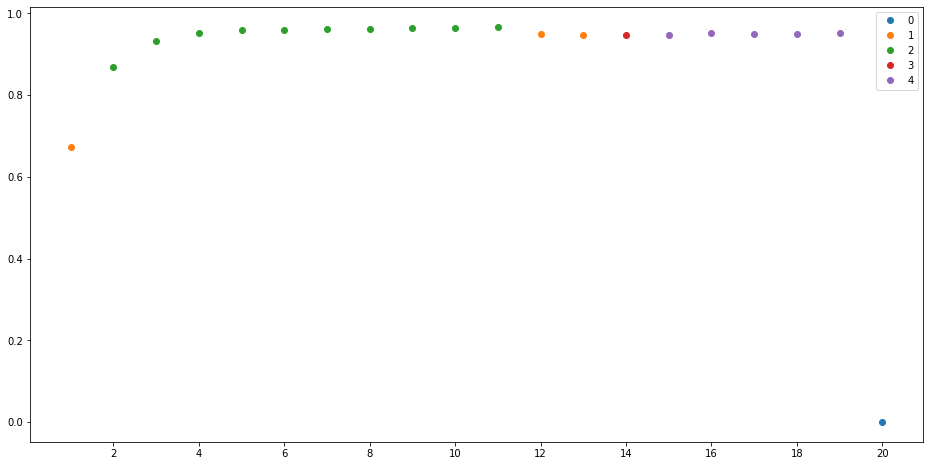

In [ ]:

epochs = range(1,21)
y = list()
labels = list()
for epoch in range(20):
  acc_list = list()
  for i in blocks:
    try:
      acc_list.append(savedResults[i][0].history["val_acc"][epoch])
    except:
      acc_list.append(0)
  maximum = np.max(acc_list)
  y.append(maximum)
  labels.append(acc_list.index(maximum))


plt.rcParams["figure.figsize"]=[16,8]
data = pd.DataFrame({"X Value": epochs, "Y Value": y, "Category": labels})
groups = data.groupby("Category")
for name, group in groups:
    plt.plot(group["X Value"], group["Y Value"], marker="o", linestyle="",label=name)
plt.legend()
plt.gca().xaxis.set_major_locator(mticker.MultipleLocator(2))

* La particularidad que tiene es que el último mapa de Pooling es de tamaño 1x1, lo cual es un pooled map bastante pequeño considerando que se extraen características de la imagen en estos mapas. Por otra parte, es la red con bloques >= 1 que tarda más en obtener un accuracy de entrenamiento cercano al 100%.
También se destaca que es la red con bloques que tiene más epoch en comparación con las otras, igualando las epochs con la red que solamente tiene capas densas.
* No se puede crear una red de 5 bloques, puesto que si vemos la arquitectura de la red con 4 bloques, la última capa de pooling genera 16 mapas de tamaño 1x1, por lo que si queremos agregar un bloque más el input es demasiado pequeño para la siguiente capa de convolución.
* Para los casos extremos, se puede ver que la red con 0 bloques es la que tiene peor rendimiento, ya que tiene una convergencia bastante lenta y es la que posee mayor error cercano al valor 1.2. Podemos ver que la red con 4 bloques, aún teniendo una convergencia más lenta que las otras redes con bloques, es más rápida que la FFN, llegando incluso en su convergencia a tener un desempeño similar a las otras arquitecturas. Esto se debe a que las CNN tienen la capacidad de poder extraer características de las imágenes y poder aprender de estas, cosa que una FFN en este caso no realiza ya que los input que toma solamente son a niveles de píxeles y no de características de la imagen. 
* Por lo anterior, la FFN no sería una buena aproximación para el reconocimiento de imágenes por su mal desempeño y la CNN con 4 bloques sería una buena aproximación pero no la indicada debido a su gasto de recursos, ya que se esperaría que mientras se agregan más bloques, se obtuviese un desempeño mejor, pero converge mucho más lento y obtiene un rendimiento similar a las otras arquitecturas.
* Podemos ver también que si graficamos los mejores accuracy de validación, la red con 2 bloques es la que tiene mejor desempeño, obtienendo el accuracy más alto que las demás redes en todas las epoch menos en la primera. Luego del epoch 11 esta red con 2 bloques converge y es por eso que aparecen valores de las demás redes en el gráfico. Finalmente se puede apreciar que tanto la red con 0 bloques y la red con 4 bloques son las que demoran más en converger, realizando 20 epochs para la red con 0 bloques y 19 epochs para la red con 4 bloques.

## 2.g Exploración libre

Como probablemente ya habrán notado, la cantidad de hiperparámetros que se pueden fijar y explorar en una red convolucional es enorme. A parte de poder modificar la arquitectura de la red y su tamaño o profundidad, pueden en cada una de las capas modificar el número de filtros, el tamaño de los filtros; modificar _stride_, cambiar las activaciones, cambiar el _padding_, cambiar los tamaños de los _MaxPool_ o sus _strides_ o incluso modificar las capas densas al final de la red. 

Por motivos de tiempo y con la esperanza de que la tarea no sea más tediosa de lo necesario, en vez de pedir explorar cada uno de estos parámetros, se les propone elegir una exploración de la siguiente lista. Debe realizar la exploración exahustivamente, comentar sus resultados apoyándose de gráficos y su conocimiento teórico cuando sea apropiado. Independiente de la exploración elegida debe responder las preguntas finales. 

Para todas las exploraciones utilice como _template_ la mejor red entrenada hasta ahora y modifique el parámetro relevante. Si utiliza otra red, justifique brévemente su elección. 

**Exploraciones posibles (Elija 1)**
* Tamaño de los filtros: Manteniendo el filtro cuadrado, explore cambiar el tamaño de filtro de alguna(s) capas convolucionales. Debe explorar a lo menos valores de $1\times 1$ hasta $9\times 9$, por lo cual debe asegurarse realizar la exploración en una capa donde las dimensiones de los filtros de la capa anterior (o el Input de la capa) se lo permita. 
* Exploración del número de filtros: Explore variando el número de filtros de alguna(s) capas. Se recomienda explorar en potencias de 2, y debe explorar a lo menos 10 valores distintos.
* Neuronas capa Densa: realice una exploración del número de neuronas de alguna o ambas de las capas densas. Debe explorar a lo menos 10 combinaciones distintas. Puede dejar una de las dos capas fijas y variar la otra siguiendo potencias de 2 por ejemplo. Tenga cuidado con la explosión del número de parámetros. 
* Pooling: Pruebe cambiar el tamaño de los _MaxPool_ entre $2\times 2$ a $6\times 6$. Pruebe también cambiando todas las capas por `AveragePooling2D`, realizando la misma exploración que con _MaxPool_.
* Pooling "convolucional": Una aproximación posible para reemplazar las capas de _maxpool_ es utilizando capas convolucionales con kernel $2\times 2$ y _stride_ $2\times 2$. Pruebe reemplazando las capas _maxpool_ por este tipo de capas, luego pruebe una mezcla de ambas, luego pruebe simplemente eliminando las capas de _pooling_ y agregandole _stride_ a la segunda capa de cada bloque (con _kernel size_ $2\times 2$ y $3 \times 3$). Pruebe finalmente cambiando las funciones de activación de las capas donde se realiza la disminución de dimensión, probando a lo menos activación lineal, sigmoidea y tangente hiperbólica.

**Preguntas (responder todas)**:
* ¿A que equivaldría utilizar tamaño de kernel $1 \times 1$?
* ¿Por qué si cambiamos el número de filtros de una capa también modificamos el número de parámetros de la siguiente capa?
* ¿En su opinión, qué metodo resume mejor la información de una capa, _maxpool_ o _averagepool_?
* ¿Qué tipo de patrones esperaría usted que se extraigan mejor con un kernel no cuadrado (por ejemplo $3\times 2$)? Apoyese de un ejemplo pequeño o una explique el fenómeno llevandolo al "extremo" (e.g. $1\times 3$)

### Red con MaxPooling

In [ ]:
from keras.layers import Conv2D, MaxPooling2D, Flatten, Dense
# do it yourself
pooling = [2,3,4,5,6]

savedResults = list()
for i in pooling: 
  model = Sequential()
  model.add(Conv2D(128, (3,3),padding='same',activation='relu'))
  model.add(Conv2D(128, (3,3), padding='same', activation='relu'))
  model.add(MaxPooling2D(pool_size=(i, i)))

  model.add(Conv2D(64, (3,3),padding='same',activation='relu'))
  model.add(Conv2D(64, (3,3), padding='same', activation='relu'))
  model.add(MaxPooling2D(pool_size=(i, i)))
      
  #Capa flatten y D
  model.add(Flatten())    
  model.add(Dense(units=512, activation='sigmoid')) # output
  model.add(Dense(units=24, activation='softmax')) # output


  my_callbacks = [History(), # Returns validation and training loss
  EarlyStopping(patience=100,monitor="val_loss", #Stops training when the validation loss doesnt get better in n°patience consecutive epochs,keep it at 100 it's only to show u
                                    restore_best_weights=True)]
  model.compile(optimizer='adam',loss='categorical_crossentropy',metrics=['acc'])
  try:
    history = model.fit(x_tr, y_tr, epochs=20, validation_data=(x_val,y_val),verbose=0,callbacks=[History(), EarlyStopping()])
    model.summary()  
    acc_tst = model.evaluate(X_tst, Y_tst, verbose=0)
    savedResults.append((history, acc_tst))
  except:
    print("Red con pooling {0}x{0} no se puede realizar".format(i))

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_6 (Conv2D)            (None, 28, 28, 128)       1280      
_________________________________________________________________
conv2d_7 (Conv2D)            (None, 28, 28, 128)       147584    
_________________________________________________________________
max_pooling2d_4 (MaxPooling2 (None, 14, 14, 128)       0         
_________________________________________________________________
conv2d_8 (Conv2D)            (None, 14, 14, 64)        73792     
_________________________________________________________________
conv2d_9 (Conv2D)            (None, 14, 14, 64)        36928     
_________________________________________________________________
max_pooling2d_5 (MaxPooling2 (None, 7, 7, 64)          0         
_________________________________________________________________
flatten_2 (Flatten)          (None, 3136)             

'\nprint(tr_list.index(np.max(tr_list)))\nprint(val_list.index(np.max(val_list)))\nprint(tr_list)\nprint(val_list)\n'

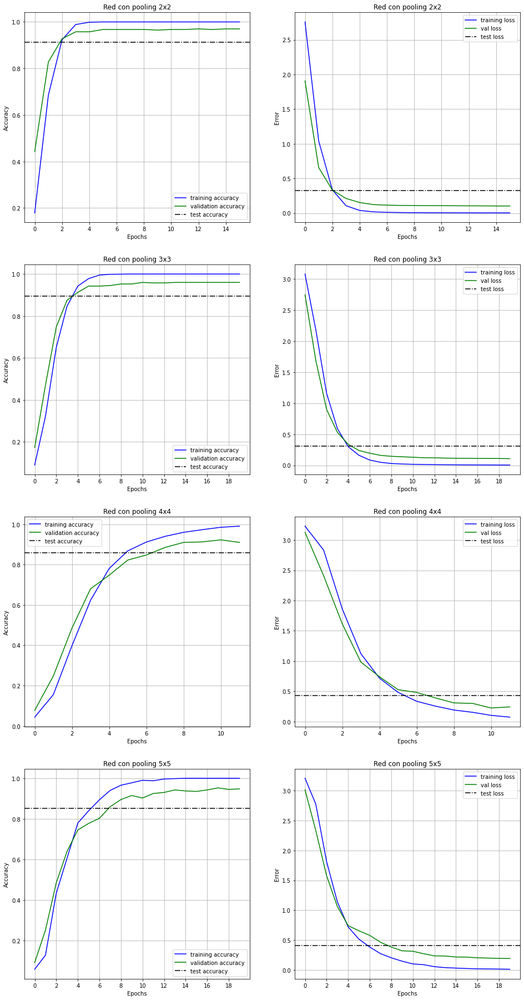

In [ ]:
val_list = list()
tr_list = list()

plt.rcParams["figure.figsize"]=[16,32]
for i in range(4):
  plt.subplot(4,2,2*i+1)
  plt.title("Red con pooling {0}x{0}".format(i+2))
  plt.plot(savedResults[i][0].history["acc"],"b-", label="training accuracy")
  plt.plot(savedResults[i][0].history['val_acc'], "g-", label="validation accuracy")
  plt.axhline(y=savedResults[i][1][1],color="k",linestyle="-.",label="test accuracy")
  plt.xlabel("Epochs"),plt.ylabel("Accuracy")
  plt.legend(),plt.grid()
  plt.gca().xaxis.set_major_locator(mticker.MultipleLocator(2))
  #...
  plt.subplot(4,2,2*i+2)
  plt.title("Red con pooling {0}x{0}".format(i+2))
  plt.plot(savedResults[i][0].history["loss"],"b-", label="training loss")
  plt.plot(savedResults[i][0].history["val_loss"],"g-",label="val loss")
  plt.axhline(y=savedResults[i][1][0],color="k",linestyle="-.",label="test loss")
  plt.xlabel("Epochs"),plt.ylabel("Error")
  plt.legend(),plt.grid()
  plt.gca().xaxis.set_major_locator(mticker.MultipleLocator(2))

### Red con AveragePooling

In [ ]:
from keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, AveragePooling2D
from keras.models import Sequential
from keras.callbacks import History, EarlyStopping
# do it yourself
pooling = [2,3,4,5,6]

savedResults = list()
for i in pooling: 
  model = Sequential()
  model.add(Conv2D(128, (3,3),padding='same',activation='relu'))
  model.add(Conv2D(128, (3,3), padding='same', activation='relu'))
  model.add(AveragePooling2D(pool_size=(i, i)))

  model.add(Conv2D(64, (3,3),padding='same',activation='relu'))
  model.add(Conv2D(64, (3,3), padding='same', activation='relu'))
  model.add(AveragePooling2D(pool_size=(i, i)))
      
  #Capa flatten y D
  model.add(Flatten())    
  model.add(Dense(units=512, activation='sigmoid')) # output
  model.add(Dense(units=24, activation='softmax')) # output


  my_callbacks = [History(), # Returns validation and training loss
  EarlyStopping(patience=100,monitor="val_loss", #Stops training when the validation loss doesnt get better in n°patience consecutive epochs,keep it at 100 it's only to show u
                                    restore_best_weights=True)]
  model.compile(optimizer='adam',loss='categorical_crossentropy',metrics=['acc'])
  try:
    history = model.fit(x_tr, y_tr, epochs=20, validation_data=(x_val,y_val),verbose=0,callbacks=[History(), EarlyStopping()])
    model.summary()  
    acc_tst = model.evaluate(X_tst, Y_tst, verbose=0)
    savedResults.append((history, acc_tst))
  except:
    print("Red con pooling {0}x{0} no se puede realizar".format(i))

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_4 (Conv2D)            (None, 28, 28, 128)       1280      
_________________________________________________________________
conv2d_5 (Conv2D)            (None, 28, 28, 128)       147584    
_________________________________________________________________
average_pooling2d_2 (Average (None, 14, 14, 128)       0         
_________________________________________________________________
conv2d_6 (Conv2D)            (None, 14, 14, 64)        73792     
_________________________________________________________________
conv2d_7 (Conv2D)            (None, 14, 14, 64)        36928     
_________________________________________________________________
average_pooling2d_3 (Average (None, 7, 7, 64)          0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 3136)             

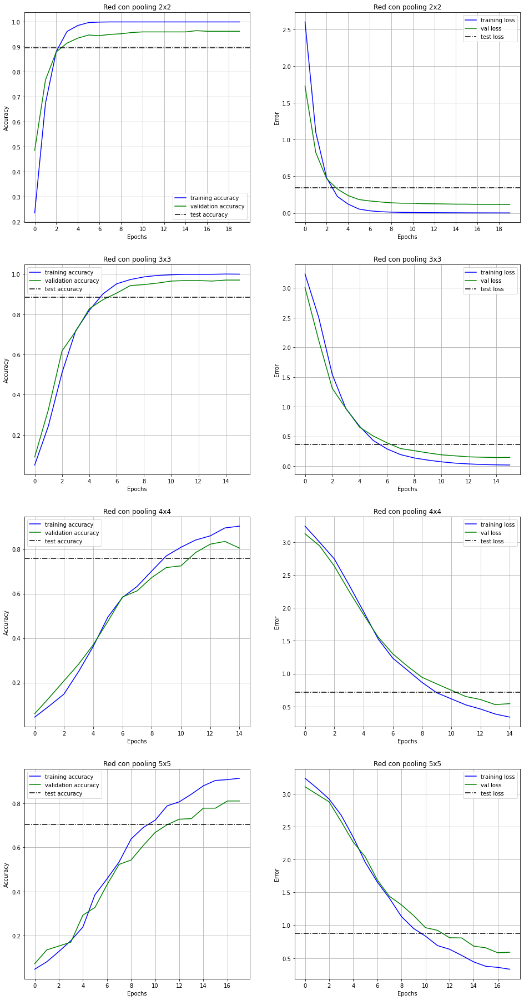

In [ ]:
val_list = list()
tr_list = list()

plt.rcParams["figure.figsize"]=[16,32]
for i in range(4):
  plt.subplot(4,2,2*i+1)
  plt.title("Red con pooling {0}x{0}".format(i+2))
  plt.plot(savedResults[i][0].history["acc"],"b-", label="training accuracy")
  plt.plot(savedResults[i][0].history['val_acc'], "g-", label="validation accuracy")
  plt.axhline(y=savedResults[i][1][1],color="k",linestyle="-.",label="test accuracy")
  plt.xlabel("Epochs"),plt.ylabel("Accuracy")
  plt.legend(),plt.grid()
  plt.gca().xaxis.set_major_locator(mticker.MultipleLocator(2))
  #...
  plt.subplot(4,2,2*i+2)
  plt.title("Red con pooling {0}x{0}".format(i+2))
  plt.plot(savedResults[i][0].history["loss"],"b-", label="training loss")
  plt.plot(savedResults[i][0].history["val_loss"],"g-",label="val loss")
  plt.axhline(y=savedResults[i][1][0],color="k",linestyle="-.",label="test loss")
  plt.xlabel("Epochs"),plt.ylabel("Error")
  plt.legend(),plt.grid()
  plt.gca().xaxis.set_major_locator(mticker.MultipleLocator(2))

* Podemos ver que realizar pooling con un filtro de 6x6 no es posible, debido a que ocurre lo mismo que ocurría en el ejercicio anterior respecto a la cantidad de bloques. El hecho de querer aumentar el filtro a una de 6x6, generaria un output shape en la primera capa de pooling de tamaño (None, 4, 4, 128) y por ende este tamaño de input es más pequeño que el filtro que se desearía aplicar en el siguiente pooling.
* Se puede apreciar que al aumentar el tamaño de MaxPool, se va deteriorando la convergencia del accuracy, siendo cada vez más lenta que con un tamaño más pequeño.
* Podemos ver que el menor error de testing para los casos probados, se obtiene al realizar MaxPool con tamaño $3x3$, posterior a este tamaño el error va incrementando.

* Respecto a la implementación con **AveragePooling**, se tiene que existe un peor desempeño en la red en comparación con MaxPooling, puesto que en todos los casos se obtiene un loss más alto con diferentes tamaños de pooling en validación, y un menor accuracy para el conjunto de validación también. Por lo tanto, para nuestro caso aplicar MaxPooling es una mejor opción ya que mantiene mejores resultados, puesto que con averagepooling se suavizan las imágenes y no se extraen características más importantes o destacables como lo realizan MaxPooling.

* ¿A que equivaldría utilizar tamaño de kernel  1×1 ?
R: Si es para realizar convolución correspondería a multiplicar los píxeles de una imagen por un número. Por otro lado, si se utiliza un tamaño de kernel 1x1 para la capa de pooling no se modificaría nada, ya que agarraría pixel a pixel sacando su máximo, lo cual no modificaría el pooling map del feature map.

* ¿Por qué si cambiamos el número de filtros de una capa también modificamos el número de parámetros de la siguiente capa?

  R: Se debe a que el número de filtros afecta el número de parámetros, ya que el número de parámetros de una capa se calcula como:
$$ \text{N° Parametros: ((Tamaño de Kernel * N° Filtros Capa Anterior) + bias)} \cdot \text{N° Filtros Capa Actual}  $$

  Por ejemplo, para calcular la cantidad de parámetros para la segunda capa de convolución con un tamaño de kernel 3x3 y 128 filtros, se calcularía como:
$$ ((3 \cdot 3 \cdot 128)+1) \cdot 128 = 147584 $$

* ¿En su opinión, qué metodo resume mejor la información de una capa, maxpool o averagepool?

  En nuestra opinión, encontramos que maxpool es la mejor opción ya que puede extraer características más destacadas o más fuertes en una imagen, como podrían ser los bordes de una imagen, lo que es importante para el trabajo que estamos realizando ahora. En cambio, con averagepool esta información se suavizaría ya que toda característica aportaría al pooling y esta información no sería tan representativa para la tarea que queremos realizar.

* ¿Qué tipo de patrones esperaría usted que se extraigan mejor con un kernel no cuadrado (por ejemplo  3×2 )? Apoyese de un ejemplo pequeño o una explique el fenómeno llevandolo al "extremo" (e.g.  1×3 )

  R: Se podrían extraer de mejor manera patrones en los que efectivamente posean características que no sean cuadradas necesariamente, ya que, con un kernel cuadrado, lo que se intenta hacer es "observar" un área lo más similar a un círculo. En cambio, con kernels rectangulares se podría favorecer la extracción de bordes en un sentido de mejor manera. Por ejemplo usar kernels de 3x1 para identificar una linea recta horizontal. 

## 2.h Data Augmentation

Otra manera de evitar sobreajuste y mejorar los desempeños de una red convolucionar es usar aumentación de datos (Ignore el hecho de que botamos datos al inicio). La idea detrás de este método es un hecho muy simple: si rotamos ligeramente una foto por ejemplo de un caballo, seguirá siendo de un caballo. Lo mismo si la movemos ligeramente hacia algun lado, hacia arriba, _etc_.

Keras trae implementado un generador de imagenes aumentadas, puede basarse en el código abajo para utilizarlo, aunque si lo desea o estima conveniente puede cambiar alguno de los parámetros. Entrene a completitud la mejor red que obtuvo a lo largo de toda la tarea.

**Pregunta:** 

¿Qué tanto mejora el desempeño de la red utilizando aumentación de datos? 

Basándose en el abecedario de lenguaje de señas que disponemos, ¿Cree que resultará beneficioso o contraproducente realizar _flips_ horizontales y/o verticales?

In [ ]:
from keras.preprocessing.image import ImageDataGenerator
datagen = ImageDataGenerator(
        featurewise_center=False,  # set input mean to 0 over the dataset
        samplewise_center=False,  # set each sample mean to 0
        featurewise_std_normalization=False,  # divide inputs by std of the dataset
        samplewise_std_normalization=False,  # divide each input by its std
        zca_whitening=False,  # apply ZCA whitening
        rotation_range=10,  # randomly rotate images in the range (degrees, 0 to 180)
        zoom_range = 0.1, # Randomly zoom image 
        width_shift_range=0.1,  # randomly shift images horizontally (fraction of total width)
        height_shift_range=0.1,  # randomly shift images vertically (fraction of total height)
        horizontal_flip=False,  # randomly flip images
        vertical_flip=False)  # randomly flip images

datagen.fit(x_tr)

model = Sequential()
model.add(Conv2D(128, (3,3),padding='same',activation='relu'))
model.add(Conv2D(128, (3,3), padding='same', activation='relu'))
model.add(MaxPooling2D(pool_size=(3, 3)))

model.add(Conv2D(64, (3,3),padding='same',activation='relu'))
model.add(Conv2D(64, (3,3), padding='same', activation='relu'))
model.add(MaxPooling2D(pool_size=(3, 3)))
    
#Capa flatten y D
model.add(Flatten())    
model.add(Dense(units=512, activation='sigmoid')) # output
model.add(Dense(units=24, activation='softmax')) # output


my_callbacks = [History(), # Returns validation and training loss
EarlyStopping(patience=100,monitor="val_loss", #Stops training when the validation loss doesnt get better in n°patience consecutive epochs,keep it at 100 it's only to show u
                                  restore_best_weights=True)]
model.compile(optimizer='adam',loss='categorical_crossentropy',metrics=['acc'])

history = model.fit_generator(datagen.flow(x_tr, y_tr, batch_size=32),
                    epochs=50,
                    verbose=2,
                    callbacks=[EarlyStopping(patience=5)],
                    validation_data=(x_val,y_val),
                    validation_freq=1,
                    shuffle=True)
acc_tst = model.evaluate(X_tst, Y_tst, verbose=0)

Epoch 1/50
50/50 - 1s - loss: 3.1381 - acc: 0.0756 - val_loss: 2.8291 - val_acc: 0.1425
Epoch 2/50
50/50 - 1s - loss: 2.4455 - acc: 0.2519 - val_loss: 1.8760 - val_acc: 0.4750
Epoch 3/50
50/50 - 1s - loss: 1.6398 - acc: 0.4775 - val_loss: 1.0023 - val_acc: 0.6975
Epoch 4/50
50/50 - 1s - loss: 1.0502 - acc: 0.6719 - val_loss: 0.6782 - val_acc: 0.8150
Epoch 5/50
50/50 - 1s - loss: 0.7630 - acc: 0.7700 - val_loss: 0.5293 - val_acc: 0.8525
Epoch 6/50
50/50 - 1s - loss: 0.6130 - acc: 0.8263 - val_loss: 0.4542 - val_acc: 0.8550
Epoch 7/50
50/50 - 1s - loss: 0.4828 - acc: 0.8631 - val_loss: 0.3346 - val_acc: 0.9175
Epoch 8/50
50/50 - 1s - loss: 0.3936 - acc: 0.8931 - val_loss: 0.3280 - val_acc: 0.9025
Epoch 9/50
50/50 - 1s - loss: 0.3501 - acc: 0.9094 - val_loss: 0.2513 - val_acc: 0.9400
Epoch 10/50
50/50 - 1s - loss: 0.2921 - acc: 0.9294 - val_loss: 0.1883 - val_acc: 0.9550
Epoch 11/50
50/50 - 1s - loss: 0.2162 - acc: 0.9500 - val_loss: 0.1637 - val_acc: 0.9700
Epoch 12/50
50/50 - 1s - loss:

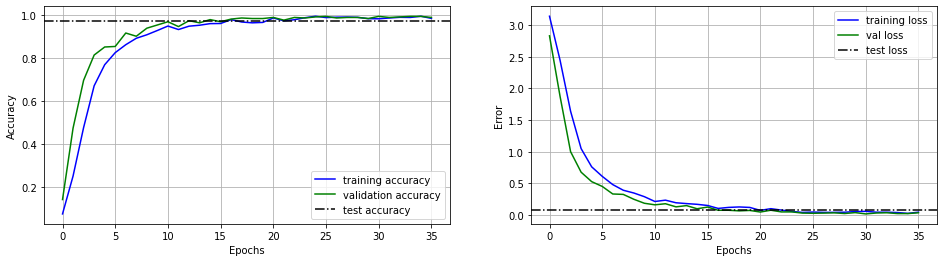

In [ ]:
plt.rcParams["figure.figsize"]=[16,4]
plt.subplot(1,2,1)
plt.plot(history.history["acc"],"b-", label="training accuracy")
plt.plot(history.history['val_acc'], "g-", label="validation accuracy")
plt.axhline(y=acc_tst[1],color="k",linestyle="-.",label="test accuracy")
plt.xlabel("Epochs"),plt.ylabel("Accuracy")
plt.legend(),plt.grid()
plt.gca().xaxis.set_major_locator(mticker.MultipleLocator(5))
#...
plt.subplot(1,2,2)
plt.plot(history.history["loss"],"b-", label="training loss")
plt.plot(history.history["val_loss"],"g-",label="val loss")
plt.axhline(y=acc_tst[0],color="k",linestyle="-.",label="test loss")
plt.xlabel("Epochs"),plt.ylabel("Error")
plt.legend(),plt.grid()
plt.gca().xaxis.set_major_locator(mticker.MultipleLocator(5))

In [ ]:
print("-- Mejor resultado pregunta anterior --")
print("Test acc red MaxPool 3x3: " + str(savedResults[1][1][1]) + "\nTest loss red MaxPool 3x3: " + str(savedResults[1][1][0]))
print("-- Resultado pregunta actual --")
print("Test acc: " + str(acc_tst[1]) + "\nTest loss: " + str(acc_tst[0]))


-- Mejor resultado pregunta anterior --
Test acc red MaxPool 3x3: 0.8958449363708496
Test loss red MaxPool 3x3: 0.3103233277797699
-- Resultado pregunta actual --
Test acc: 0.9723926186561584
Test loss: 0.08910379558801651


* Se usó la red con dos bloques de dos capas convolucionales y MaxPool de 3x3.

¿Qué tanto mejora el desempeño de la red utilizando aumentación de datos? 

* Se puede notar mejoras respecto a entrenamientos anteriores. En primer lugar, tanto el test accuracy como el test loss son muy cercanos a 1 y 0 respectivamente y presentan mejoras respecto a modelos anteriores, donde el test accuracy alcanzaba valores que rondaban cerca de 0.9 solamente, presentando una mejora del 8% aproximadamente, mientras que el error se presentaba en rangos de [0.25, 0.5] y presenta una reducción de 0.23 aproximadamente.

* Por otro lado, se debe considerar también que se realizaron una mayor cantidad de epochs, en donde se llegaron a las 36, mientras que en anteriores experimentos no se superaban las 20. Lo anterior indica que el entrenamiento podía seguir mejorando el modelo, aunque estas mejoras fuesen pequeñas.

Basándose en el abecedario de lenguaje de señas que disponemos, ¿Cree que resultará beneficioso o contraproducente realizar _flips_ horizontales y/o verticales?

* Por un lado, puede resultar contraproducente, ya que al hacer _flips_ horizontales se podrían confundir ciertas señas, como por ejemplo, la K con la T, que invertidas presentan una silueta similar. Por otro lado, esto sería beneficioso para poder reconocer señas hechas con la mano izquierda, para así poder reconocerlas en el caso de que la persona tenga su mano izquierda como dominante. En el último caso, podría ser beneficioso duplicar el número de clases, haciendo la distinción entre si la seña fue hecha con la mano izquierda o derecha.

* Respecto a hacer _flips_ verticales, creemos que esto sólo sería contraproducente, ya que las señas expuestas se deben realizar como se muestra en las imágenes (con la mano orientada hacia arriba, por decirlo de alguna manera), y no tendría sentido posicionar la mano al revés para hacer una seña, por lo que sólo se añadirían imagenes para entrenar una red que finalmente no recibiría como input este tipo de imágenes de forma común. 

## 2.i Matriz de Confusión

Si bien el _accuracy_ nos ha acompañado toda la pregunta para evaluar el desempeño de nuestras redes de forma fácilmente interpretable, no considera por ejemplo si una gran parte de los errores provienen de una sola clase, o si alguna clase se logra clasificar perfectamente. Una manera de visualizar fácilmente esta métrica más granular, es utilizando la matriz de confusión. Investigue y explique brévemente en qué consiste una matriz de confusión (puede explicar el caso binario donde solo hay dos clases).


Luego, apoyándose en los códigos de abajo, visualizaremos la matriz de confusión del modelo que mejor se desempeñó a lo largo de toda la tarea. 

- ¿Algo le llama la atención? 
- ¿Qué clases se confunden más entre si?
- ¿Coincidió esto con sus predicciones al inicio de la tarea? 

Igual de la misma forma que en 2.a, visualice algunas imágenes mal clasificadas por su modelo. 
- ¿Le parece razonable que el modelo no las clasifique bien?

### Matriz de confusión:

Una matriz de confusión es una herramienta usada en problemas de clasificación que permite la visualización del desempeño de un algoritmo, o en nuestro caso, de una red y ver si esta confundiendo clases.Consiste en una tabla con 2 conjuntos, los valores reales (en las filas )y los predichos (en las columnas). Entonces en estas la cantidad si se predicen 3 ejemplos como "perros", en la columna perros se sumará 3, pero si uno de estos era un gato, en las filas aparecerá un 2 en la fila "perros" intersectada con la columna "perros" y un 1 en la fila "gatos". 

Esta representación permite visualizar rápidamente cuales son las clases que más se confunden.

Ejemplo de caso binario con 2 clases "perros y "gatos", en dónde se predicen 3 perros (2 aciertos) y 5 gatos (4 aciertos):

|        | Perros | Gatos |   
|--------|--------|-------|
| Perros | 2      | 1     |   
| Gatos  | 1      | 4     |   




In [ ]:
from sklearn.metrics import confusion_matrix
# Puede usar libreria seaborn para realizar facilmente heatmaps anotados: 
import seaborn as sns

#Ocupando el modelo de la pregunta anterior y el conjunto de test

y_pred = model.predict(X_tst)

plt.rcParams["figure.figsize"]=[16,8]
conf = confusion_matrix(Y_tst.argmax(axis=1), y_pred.argmax(axis=1))

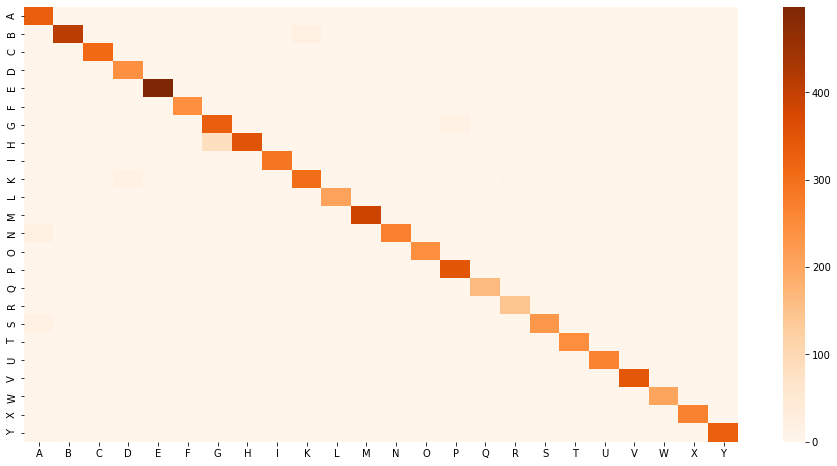

In [ ]:
labels = ["A","B","C","D","E","F","G","H","I","K","L","M","N","O","P","Q","R","S","T","U","V","W","X","Y"]
sns.heatmap( conf, cmap="Oranges", xticklabels=labels, yticklabels=labels)

En el mapa de confusión se puede ver que, en su mayoría, el modelo clasifica bien. Sin embargo, nos llama la atención el hecho de que la diagonal tenga una diversidad de color tan amplia, ya que se puede ver que, por ejemplo para R la cantidad de ejemplos es menor que para E, o bien, las predicciones de la columna R están mas dispersas en las filas, pero no las podemos percibir.

A simple vista las clases que se confunden son:
* (N,A)
* (S,A)
* (H,G)
* (K,D)
* (G,P)

Y nuestra predicción fue:
* El grupo A, E, M, N, S (en todas se presenta un puño)
* G y H
* D y U
* K y V
* R y U

Con esto podemos ver que ciertas predicciones se cumplen, como el confundir la N y la S con la A y la H con una G. Sin embargo, existen predicciones que no teníamos contempladas, como confundir K con D y G con P, siendo que en este último par, son manos apuntando a distintos lados.

A continuación, se muestra la imagen, su clase correcta (arriba a la izquierda) y su clase predicha(arriba a la derecha). Nos parece completamente razonable para el segundo caso ya que en ambas señas se forma un puño y lo que varía es la disposición de los dedos, mientras que en el tercero la diferencia es la cantidad de dedos "apuntando", lo que es fácilmente confundible. El primer caso no nos parece tan razonable ya que la seña para U solo posee la mitad de los dedos arriba y no parece estar identificando bien eso en la foto. Respecto al último caso, a simple vista también nos parece que corresponde a una D, por lo que es entendible y lo que puede jugar en contra aqui es el ángulo de la imagen.

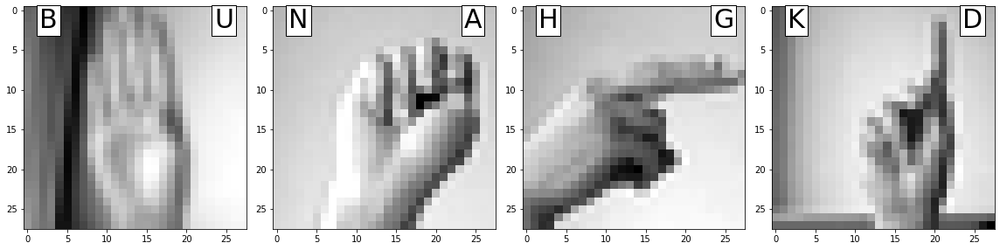

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.ticker as mticker
plt.rcParams["figure.figsize"]=[16,4]
letters=["A","B","C","D","E","F","G","H","I","K","L","M","N","O","P","Q","R","S","T","U","V","W","X","Y"]
fig, axs = plt.subplots(1,4)

bad_pred = []
y_test_argmax = Y_tst.argmax(axis=1)
y_pred_argmax = y_pred.argmax(axis=1)
for i in range(len(y_pred_argmax)):
  if(y_test_argmax[i] != y_pred_argmax[i]):
    #Index, Real,Predicted
    bad_pred.append((i , y_test_argmax[i], y_pred_argmax[i]))
  if(len(bad_pred) == 4):
    break
for i,ax in enumerate(axs):
  ax.imshow(X_tst[bad_pred[i][0],:,:,0], cmap = "gray") # arreglar error 

  ax.text(1.5, 2.2, letters[bad_pred[i][1]], bbox={'facecolor': 'white', 'pad': 3},fontsize=30)
  ax.text(23.5, 2.2, letters[bad_pred[i][2]], bbox={'facecolor': 'white', 'pad': 3},fontsize=30)
plt.tight_layout()
plt.show()

## 2.j Batch Normalization
Una manera propuesta de mejorar los desempeños de las redes en general, que funciona bastante bien en tareas de reconocimiento de imagenes es _Batch Normalization_. Entrene nuevamente su red preferida de la pregunta anterior, agregando capas de _Batch Normalization_ luego de cada capa de _MaxPool_. Comente sus resultados. 

**Preguntas**

Segun su conocimiento teórico y investigación, ¿Qué realiza _Batch Normalization_ en términos matemáticos? En términos de aprendizaje, ¿qué evita la utilización de _Batch Normalization_?

¿Mejoran los desempeños de la red agregando _Batch Normalization_? ¿Existe diferencias entre una capa de _batch normalization_ justo antes o justo despues de una capa de _MaxPool_ en términos numéricos? ¿Opina lo mismo en términos de aprendizaje? Discuta. 

In [ ]:
from keras.layers.normalization import BatchNormalization
#Se decide entrenar sobre el conjunto sin data augmentation

model = Sequential()
model.add(Conv2D(128, (3,3),padding='same',activation='relu'))
model.add(Conv2D(128, (3,3), padding='same', activation='relu'))
model.add(MaxPooling2D(pool_size=(3, 3)))

model.add(BatchNormalization())

model.add(Conv2D(64, (3,3),padding='same',activation='relu'))
model.add(Conv2D(64, (3,3), padding='same', activation='relu'))
model.add(MaxPooling2D(pool_size=(3, 3)))

model.add(BatchNormalization())

#Capa flatten y D
model.add(Flatten())    
model.add(Dense(units=512, activation='sigmoid')) # output
model.add(Dense(units=24, activation='softmax')) # output


my_callbacks = [History(), # Returns validation and training loss
EarlyStopping(patience=100,monitor="val_loss", #Stops training when the validation loss doesnt get better in n°patience consecutive epochs,keep it at 100 it's only to show u
                                  restore_best_weights=True)]
model.compile(optimizer='adam',loss='categorical_crossentropy',metrics=['acc'])
history = history = model.fit(x_tr, y_tr, epochs=20, validation_data=(x_val,y_val),verbose=0,callbacks=[History(), EarlyStopping(patience=10)])
model.summary()
acc_tst = model.evaluate(X_tst, Y_tst, verbose=0)

Model: "sequential_28"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_110 (Conv2D)          (None, 28, 28, 128)       1280      
_________________________________________________________________
conv2d_111 (Conv2D)          (None, 28, 28, 128)       147584    
_________________________________________________________________
max_pooling2d_56 (MaxPooling (None, 9, 9, 128)         0         
_________________________________________________________________
batch_normalization_34 (Batc (None, 9, 9, 128)         512       
_________________________________________________________________
conv2d_112 (Conv2D)          (None, 9, 9, 64)          73792     
_________________________________________________________________
conv2d_113 (Conv2D)          (None, 9, 9, 64)          36928     
_________________________________________________________________
max_pooling2d_57 (MaxPooling (None, 3, 3, 64)        

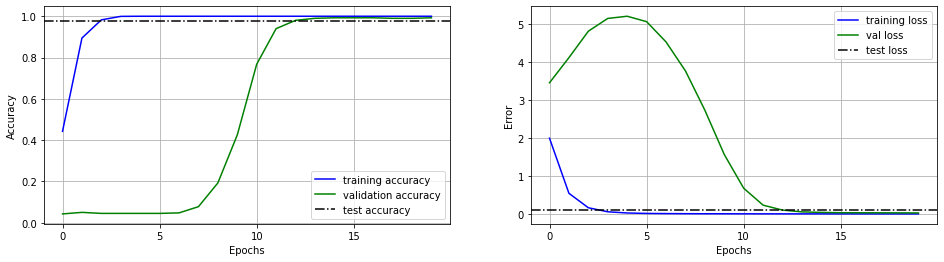

In [ ]:
plt.rcParams["figure.figsize"]=[16,4]
plt.subplot(1,2,1)
plt.plot(history.history["acc"],"b-", label="training accuracy")
plt.plot(history.history['val_acc'], "g-", label="validation accuracy")
plt.axhline(y=acc_tst[1],color="k",linestyle="-.",label="test accuracy")
plt.xlabel("Epochs"),plt.ylabel("Accuracy")
plt.legend(),plt.grid()
plt.gca().xaxis.set_major_locator(mticker.MultipleLocator(5))
#...
plt.subplot(1,2,2)
plt.plot(history.history["loss"],"b-", label="training loss")
plt.plot(history.history["val_loss"],"g-",label="val loss")
plt.axhline(y=acc_tst[0],color="k",linestyle="-.",label="test loss")
plt.xlabel("Epochs"),plt.ylabel("Error")
plt.legend(),plt.grid()
plt.gca().xaxis.set_major_locator(mticker.MultipleLocator(5))

In [ ]:
acc_tst = model.evaluate(X_tst, Y_tst, verbose=0)
print("-- Resultado pregunta actual --")
print("Test acc: " + str(acc_tst[1]) + "\nTest loss: " + str(acc_tst[0]))

-- Resultado pregunta actual --
Test acc: 0.9760178327560425
Test loss: 0.09292259812355042


El resultado que se presenta es curioso, ya que presenta un desempeño peor en las primeras epochs, aumentando incluso el error de validación y teniendo un mal desempeño en el accuracy para este conjunto también. Sin embargo, luego comienzan a mejorar los resultados llegando a tener un muy buen desempeño. En este caso se obtuvo un accuracy de 0.976 y un loss de 0.09 en el conjunto de testeo. Al compararlo con el mejor resultado de la pregunta 2.g superamos sus resultados y presentamos unos similares a los de la pregunta 2.h, teniendo un test loss superior en 0.01 solamente.

* ¿Qué realiza Batch Normalization en términos matemáticos? En términos de aprendizaje, ¿qué evita la utilización de Batch Normalization?

  Para una capa con un input $d$-dimensional $a= (a^{(1)}, a^{(2)},...,a^{(d)})^T$ se normaliza cada dimensión considerando un minibatch $a_1,a_2,...,a_m$ de tal forma que:

  $\hat{a}^k = \frac{a^{(k)}- E[a^{(k)}]}{\sqrt{Var[a^{(k)}]}+\epsilon}$

  Donde $\epsilon$ vale $10^{-8}$

  Lo que evita Batch Normalization es el _covariate shift_, que se da por el uso del gradiente, que nos dice como actualizar los parámetros asumiendo que en las otras capas no cambian, pero en el entrenamiento al actualizar los parámetros de una capa anterior, la distribución de la capa actual necesita actualizarse y estar constantemente reajustandose a nuevas distribuciones.

* ¿Mejoran los desempeños de la red agregando Batch Normalization? ¿Existe diferencias entre una capa de batch normalization justo antes o justo despues de una capa de MaxPool en términos numéricos? ¿Opina lo mismo en términos de aprendizaje? Discuta.

  Mejoran, pero la red se debe entrenar una mayor cantidad de epochs. 

  Existe diferencia en términos numéricos ya que realizar primero Pooling y después batch normalization, por la fórmula de calcular los valores variaría la varianza y la esperanza, lo que en consecuencia generaría una diferencia numérica entre hacerlo antes y después.

  En terminos de aprendizaje no debería afectar, ya que con o sin Batch Normalization la capa de MaxPooling eligiría los mismo píxeles.

# 3. Interpretabilidad de CNNs, transfer learning y skip connections

Los modelos de aprendizaje automático, especialmente los modelos de aprendizaje profundo, a menudo se consideran una caja negra y difíciles de interpretar. Bueno, esta afirmación no es completamente cierta ni es completamente falsa. Es un hecho que depurar un modelo de aprendizaje profundo es mucho más difícil que otros modelos de aprendizaje automático, pero hay formas en las que puede obtener información sobre su modelo y, hasta cierto punto, puede ver lo que está sucediendo. Dado que trabajaremos con archivos .jpg mucho código vendrá dado, se darán ejemplos en el camino para que se familiarice con las herramientas sin la necesidad de entenderlas en su totalidad. **¡¡¡¡¡¡Evite trabajar de más y trabaje esta pregunta en _Colab_!!!!!** La gran mayoría del código de pre-procesamiento a utilizar, y ciertos tópicos ha cubrir, han sido sacados de https://www.kaggle.com/aakashnain/what-does-a-cnn-see/notebook , puede ocupar el código para guiarse, sin embargo se ha bajado el código para trabajar con tensorflow directamente. Aprecie que en los datasets de Kaggle, hay una sección notebooks, donde distintos usuarios suben distintas aplicaciones que le han dado al dataset en cuestión.  


<h1 align='center'> <img src="https://miro.medium.com/max/831/1*7Ip2_SeOz_BoruHEytEMlQ.png" width="60%" height="60%" /> </h1> 
<h1 align='center'></h1>

Para esto analizaremos el problema de clasificación de imágenes, en este caso clasificaremos 10 especies de monos, su descripción se puede encontrar en: https://www.kaggle.com/slothkong/10-monkey-species (No es necesario descargar el dataset trabajando en _Colab_). Este dataset será el más pesado que utilizaremos en esta tarea. **Recordar usar entorno de ejecución con acelerador GPU**. Veremos los temas de transfer learning, skip connections, y class activation mappings. Donde la primera herramienta nos ayudará a hacer el entrenamiento más ligero, la segunda nos permitirá atacar tener redes profundas con pesos fijos, y la última nos permetirá visualizar qué está viendo nuestra red CNN.


## 3.a Carga de datos (tan solo insertar datos kaggle, leer código y comentarios para entender la funcionalidad de cada celda).

##### I) Iniciaremos cargando los datos. Para esto necesitará crear una cuenta en kaggle, dirigirse a su perfil, ir a Account, y en la sección API apretar _Create new API token_ , se descargará un archivo kaggle.json, ábralo como archivo de texto y obtenga su username y key. Luego ejecute el siguiente código (desconozco por qué pero a veces hay que ejecutar el código 2 veces para que funcione). Solución obtenida desde el hilo: https://gist.github.com/jayspeidell/d10b84b8d3da52df723beacc5b15cb27

In [ ]:
username="andrsfelipenavarro"
key="2327f4add531dbbe58a28855b95670c5"

!pip install -q kaggle
api_token = {"username":username,"key":key}
import json
import zipfile
import os
os.environ['KAGGLE_USERNAME'] = str(username)
os.environ['KAGGLE_KEY'] = str(key)
!kaggle datasets download -d slothkong/10-monkey-species
if not os.path.exists("/content/competitions/monillos"):
    os.makedirs("/content/competitions/monillos")
os.chdir('/content/competitions/monillos')
for file in os.listdir():
    if file[-4:]==".zip":
      zip_ref = zipfile.ZipFile(file, 'r')
      zip_ref.extractall()
      zip_ref.close()
!ls

 99% 541M/547M [00:02<00:00, 237MB/s]
100% 547M/547M [00:02<00:00, 221MB/s]
10-monkey-species.zip  monkey_labels.txt  training  validation


Ejecute el siguiente código como viene para generar los conjuntos de entrenamiento y validación, en este formato la primera columna indicará el archivo .jpg al que está ligado cada dato, y la columna labels indicará a qué clase pertenece. **Si le aparece un error de directorio volver a ejecutar celda anterior**

In [ ]:
from pathlib import Path
import pandas as pd
import cv2
import numpy as np
from keras.applications.vgg16 import preprocess_input
import matplotlib.pyplot as plt

labels_dict= {'n0':0, 'n1':1, 'n2':2, 'n3':3, 'n4':4, 'n5':5, 'n6':6, 'n7':7, 'n8':8, 'n9':9}
training_data = Path('training/training/') 
validation_data = Path('validation/validation/') 
labels_path = Path('monkey_labels.txt')
# Creating a dataframe for the training dataset
train_df = []
for folder in os.listdir(training_data):
    # Define the path to the images
    imgs_path = training_data / folder
    # Get the list of all the images stored in that directory
    imgs = sorted(imgs_path.glob('*.jpg'))
    # Store each image path and corresponding label 
    for img_name in imgs:
        train_df.append((str(img_name), labels_dict[folder]))
train_df = pd.DataFrame(train_df, columns=['image', 'label'], index=None)
# shuffle the dataset 
train_df = train_df.sample(frac=1.).reset_index(drop=True)

# Creating dataframe for validation data in a similar fashion
valid_df = []
for folder in os.listdir(validation_data):
    imgs_path = validation_data / folder
    imgs = sorted(imgs_path.glob('*.jpg'))
    for img_name in imgs:
        valid_df.append((str(img_name), labels_dict[folder]))

        
valid_df = pd.DataFrame(valid_df, columns=['image', 'label'], index=None)
# shuffle the dataset 
valid_df = valid_df.sample(frac=1.).reset_index(drop=True)

OpenCV es una poderosa herramienta para computer vision:

_OpenCV (Open Source Computer Vision Library) is an open source computer vision and machine learning software library. OpenCV was built to provide a common infrastructure for computer vision applications and to accelerate the use of machine perception in the commercial products. Being a BSD-licensed product, OpenCV makes it easy for businesses to utilize and modify the code._

Procederemos a visualizar una imagen del dataset al azar. Familiarícese con las f° a utilizar

In [ ]:
# dimensions to consider for the images
img_rows, img_cols, img_channels = 224,224,3

# batch size for training  
batch_size=8

# total number of classes in the dataset
nb_classes=10

Como podrá inferir en base a la imágen mostrada, el dataset es muy pesado, por lo cual en lugar de trabajar directamente con un dataframe con los pixeles de la imágen, como en la pregunta 2, trabajaremos con la siguiente función.

In [ ]:
from keras.utils import to_categorical
def data_generator(data, batch_size, is_validation_data=False):
    # Get total number of samples in the data
    n = len(data)
    nb_batches = int(np.ceil(n/batch_size))

    # Get a numpy array of all the indices of the input data
    indices = np.arange(n)
    
    # Define two numpy arrays for containing batch data and labels
    batch_data = np.zeros((batch_size, img_rows, img_cols, img_channels), dtype=np.float32)
    batch_labels = np.zeros((batch_size, nb_classes), dtype=np.float32)
    
    while True:
        if not is_validation_data:
            # shuffle indices for the training data
            np.random.shuffle(indices)
            
        for i in range(nb_batches):
            # get the next batch 
            next_batch_indices = indices[i*batch_size:(i+1)*batch_size]
            
            # process the next batch
            for j, idx in enumerate(next_batch_indices):
                img = cv2.imread(data.iloc[idx]["image"])
                img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                label = data.iloc[idx]["label"]
                img = cv2.resize(img, (img_rows, img_cols)).astype(np.float32)
                batch_data[j] = img
                batch_labels[j] = to_categorical(label,num_classes=nb_classes)
            
            batch_data = preprocess_input(batch_data)
            yield batch_data, batch_labels

In [ ]:
#training data generator 
train_data_gen = data_generator(train_df, batch_size)

# validation data generator 
valid_data_gen = data_generator(valid_df, batch_size, is_validation_data=True)

##### II) Visualice una imágen para cada clase de mono indicado su raza. Básese en el siguiente código.

OpenCV es una poderosa herramienta para computer vision:

_OpenCV (Open Source Computer Vision Library) is an open source computer vision and machine learning software library. OpenCV was built to provide a common infrastructure for computer vision applications and to accelerate the use of machine perception in the commercial products. Being a BSD-licensed product, OpenCV makes it easy for businesses to utilize and modify the code._

Procederemos a visualizar una imagen del dataset al azar. Familiarícese con las f° a utilizar

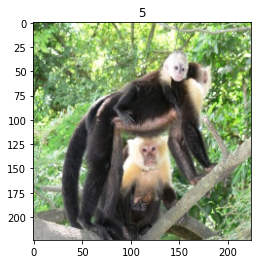

In [ ]:
idx= np.random.randint(100) # <- random number
sample_image = cv2.imread(valid_df.iloc[idx]['image']) #read image from validation set
sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB) #set color
sample_image = cv2.resize(sample_image, (img_rows, img_cols)) #resize, because .jpg images are from diferent size
sample_label = valid_df.iloc[idx]["label"] #get label
sample_image_processed = np.expand_dims(sample_image, axis=0) #not used here, but to transform image from (pixel,pixel,canal) to (obs, pixel, pixel, canal)
sample_image_processed = preprocess_input(sample_image_processed) #transformation for vgg16
plt.title(sample_label)
plt.imshow(sample_image)
plt.show()

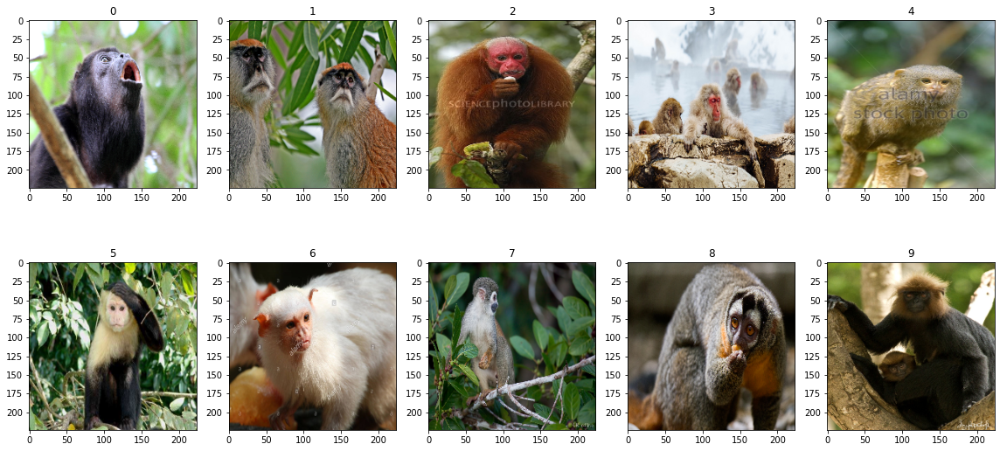

In [ ]:
import matplotlib.pyplot as plt

monkey_examples = dict()

for i in range(len(valid_df)):
  if len(monkey_examples) == 10:
    break
  if not (valid_df.iloc[i]["label"] in monkey_examples):
    monkey_examples[valid_df.iloc[i]["label"]] = i

plt.rcParams["figure.figsize"]=[16,8]
fig, axs = plt.subplots(2,5)
axs = axs.flatten()
for i,ax in enumerate(axs):
  sample_image = cv2.imread(valid_df.iloc[monkey_examples[i]]['image']) #read image from validation set
  sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB) #set color
  sample_image = cv2.resize(sample_image, (img_rows, img_cols)) #resize, because .jpg images are from diferent size
  sample_label = valid_df.iloc[monkey_examples[i]]["label"] #get label
  sample_image_processed = np.expand_dims(sample_image, axis=0) #not used here, but to transform image from (pixel,pixel,canal) to (obs, pixel, pixel, canal)
  sample_image_processed = preprocess_input(sample_image_processed) #transformation for vgg16
  ax.imshow(sample_image)
  ax.set_title(sample_label)

plt.tight_layout()
plt.show()


## 3.b Transfer learning

El aprendizaje por transferencia es un método de aprendizaje automático en el que un modelo desarrollado para una tarea se reutiliza como punto de partida para un modelo en una segunda tarea.

Es un enfoque popular en el aprendizaje profundo en el que los modelos previamente entrenados se utilizan como punto de partida en la visión por computadora y las tareas de procesamiento del lenguaje natural, dada la gran cantidad de recursos informáticos y de tiempo necesarios para desarrollar modelos de redes neuronales sobre estos problemas y los enormes saltos en las habilidades que proporcionan sobre problemas relacionados. El concepto de transfer learning abarca más que este tipo de implementación en específico, p.ej, en el área de reinforcement learning se le puede llamar transfer learning al hecho de utilizar demostraciones humanas para ayudar a una red neuronal a resolver un _task_ o _multi-task_ en específico.

<h1 align='center'> <img src="https://neurohive.io/wp-content/uploads/2018/11/vgg16-1-e1542731207177.png" width="60%" height="60%" /> </h1> 
<h1 align='center'> VGG16 </h1> 

Para este item utilizaremos la red vgg16 como red base (info: https://neurohive.io/en/popular-networks/vgg16/) desarrollada por Oxford.

##### I) Procederemos a obtener la red VGG16 desde keras.applications, retirar su arquitectura densa, congelar sus pesos, y añadir una capa densa propia entrenable.

In [ ]:
from keras.applications.vgg16 import VGG16
from keras.layers import Dropout,Dense,Flatten
from keras.optimizers import RMSprop
from keras.callbacks import History, EarlyStopping
import tensorflow as tf
from keras.applications.vgg16 import preprocess_input
tf.keras.backend.clear_session()
tf.compat.v1.disable_eager_execution()

base_model = VGG16(input_shape=(img_rows, img_cols, img_channels), weights='imagenet', include_top=True)
#  get the output of the last layer
base_model_output = base_model.layers[-2].output
# # add new layers 
x = Dropout(0.7)(base_model_output)
output = Dense(10, activation='softmax')(x)
# define a new model 
model = tf.keras.models.Model(base_model.input, output)
# # Freeze all the base model layers
for layer in base_model.layers[:-1]:
    layer.trainable=False
my_callbacks = [History(), # Returns validation and training loss
    EarlyStopping(patience=2,monitor="val_accuracy", #Stops training when the validation loss doesnt get better in n°patience consecutive epochs
                                     restore_best_weights=True)]
model.compile(loss='categorical_crossentropy', optimizer=RMSprop(1e-3), metrics=['accuracy'])

553467904/553467096 [==============================] - 5s 0us/step


In [ ]:
model.summary()

Model: "functional_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)      

In [ ]:
# number of training and validation steps for training and validation
nb_train_steps = int(np.ceil(len(train_df)/batch_size))
nb_valid_steps = int(np.ceil(len(valid_df)/batch_size))
# number of epochs 
nb_epochs=3

hist = model.fit(train_data_gen,      # ¿Demasiado lento?, revisar estar usando entorno de ejecución en modo GPU. Debiese demorarse aprox. 40 secs por epoch. Dejar verbose
                                          # para seguir el entrenamiento, esto tomará su tiempo en comparación con las demás secciones.
                              epochs=nb_epochs, 
                              steps_per_epoch=nb_train_steps, 
                              validation_data=valid_data_gen, 
                              validation_steps=nb_valid_steps,
                              callbacks=my_callbacks)

Epoch 1/3
137/137 [==============================] - ETA: 0s - batch: 68.0000 - size: 8.0000 - loss: 1.5509 - accuracy: 0.7126WARNING:tensorflow:From /usr/local/lib/python3.6/dist-packages/tensorflow/python/keras/engine/training_v1.py:2048: Model.state_updates (from tensorflow.python.keras.engine.training) is deprecated and will be removed in a future version.
Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.
137/137 [==============================] - 34s 252ms/step - batch: 68.0000 - size: 8.0000 - loss: 1.5509 - accuracy: 0.7126 - val_loss: 0.0593 - val_accuracy: 0.9779
Epoch 2/3
137/137 [==============================] - 36s 265ms/step - batch: 68.0000 - size: 8.0000 - loss: 0.4851 - accuracy: 0.8996 - val_loss: 0.0406 - val_accuracy: 0.9853
Epoch 3/3
137/137 [==============================] - 35s 253ms/step - batch: 68.0000 - size: 8.0000 - loss: 0.2035 - accuracy: 0.9526 - val_loss: 0.0298 - val_accuracy: 0.9816


##### II) Grafique los errores y accuracy de entrenamiento y validación a lo largo de los epochs. **Comente**

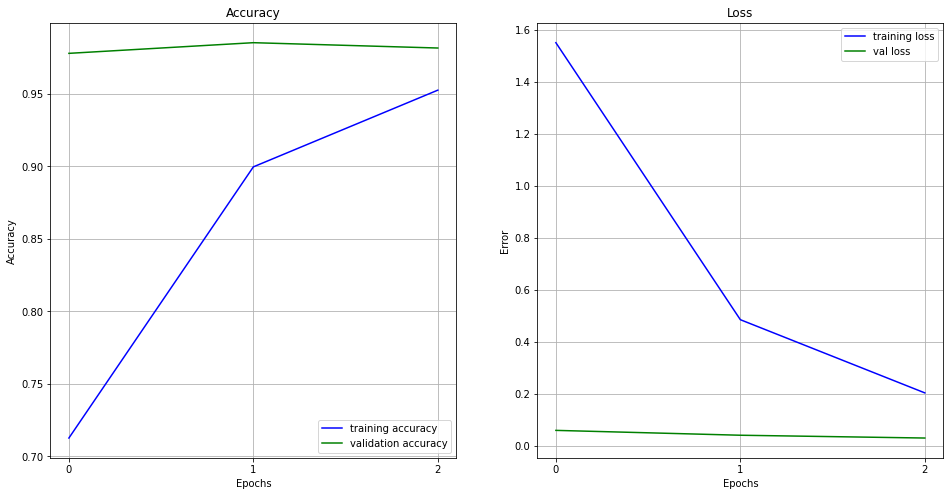

In [ ]:
import matplotlib.ticker as mticker

plt.rcParams["figure.figsize"]=[16,8]

plt.subplot(1,2,1)
plt.title("Accuracy")
plt.plot(hist.history["accuracy"],"b-", label="training accuracy")
plt.plot(hist.history['val_accuracy'], "g-", label="validation accuracy")
plt.xlabel("Epochs"),plt.ylabel("Accuracy")
plt.legend(),plt.grid()
plt.gca().xaxis.set_major_locator(mticker.MultipleLocator(1))
#...
plt.subplot(1,2,2)
plt.title("Loss")
plt.plot(hist.history["loss"],"b-", label="training loss")
plt.plot(hist.history["val_loss"],"g-",label="val loss")
plt.xlabel("Epochs"),plt.ylabel("Error")
plt.legend(),plt.grid()
plt.gca().xaxis.set_major_locator(mticker.MultipleLocator(1))
#...

Se puede observar que son sólo 3 epoch se obtienen buenos resultados, con un accuracy de validación que supera al de entrenamiento y en el caso de los errores, el de validación se mantiene por debajo del de entrenamiento. En ambos casos la "curva" de validación presenta un mejor resultado, pero para ambos conjuntos se presenta un buen desempeño, con accuracy sobre 95% y errores bajo 0.25.

##### III) **(Las preguntas de este ítem 2.b se tendrán que volver a implementar para futuras preguntas)** 

Realice la visualización del input (con título predicted label y true label), Class Activation Map (con título del label y salida de la red correspondiente), y superposición de input y CAM correspondiente al predicted label. **Deberá** modificar el código para obtener lo solicitado para 10 entradas distintas (1 para cada clase de mono) y su CAM para cada una de las 10 clases de monos. En total para cada clase de mono deberá obtener: 1 imágen de entrada de la clase de mono en cuestión, 10 CAM una para cada neurona del output de la red, y 1 superposición de la imágen de entrada y el CAM correspondiente a la predicción (por lo tanto, 120 imágenes en total). **Las imágenes tienen que ser claras, cada una de tamaño semejante a las que entrega el siguiente código.** Ocupe su herramienta gráfica preferida.

Apoyándose de las visualizaciones responda todas las preguntas siguientes:

**1) ¿Qué es CAM?, ¿Cómo nos ayuda a entender la visualización de nuestra CNN?** Puede limitarse a responder con la información entregada en el artículo https://medium.com/@GaganaB/class-activation-maps-551477720679 (si es que se le acabaron las visitas a medium, puede entrar en modo incógnito de manera ilimitada) y en el video https://www.youtube.com/watch?v=vTY58-51XZA&ab_channel=LazyProgrammer

**2) ¿Dónde se enfoca la red para verificar a qué clase de mono pertenece la imágen? ¿Qué estrategia asume la red para reconocer cada clase de mono?** 

1) CAM es una técnica que, a partir de una imagen que se le da al modelo, genera una representación de un mapa de calor que resalta los píxeles de la imagen que provocaron que el modelo asociara dicha imagen con la clase. Esto es de ayuda ya que nos permite visualizar de mejor manera como es que cada clase identifica y se enfoca en ciertos rasgos en la imagen para poder determinar si corresponde a esta o no, dando así a las personas que desarrollan la CNN una idea de las regiones de la imagen que más influyen en la predicción de la red.

2) La red se enfoca mayoritariamente en los rasgos de la cabeza del mono, concentrandose aún más en los rasgos faciales. La estrategia que asume para casi todas las clases es la de reconocer las características de la cabeza del mono. La clase 5 parece ser una excepción, ya que, como se puede ver en el CAM, si bien se activa en los rasgos faciles, se destacan más los píxeles que se encuentran en el torso del mono, ya que posee una división de colores en este, donde la parte de arriba es blanca y la de abajo es negra. Respecto a la clase 0, se puede ver que se le da más importancia las extremidades del mono, pero también se destacan algunos rasgos de la cabeza.

[0]


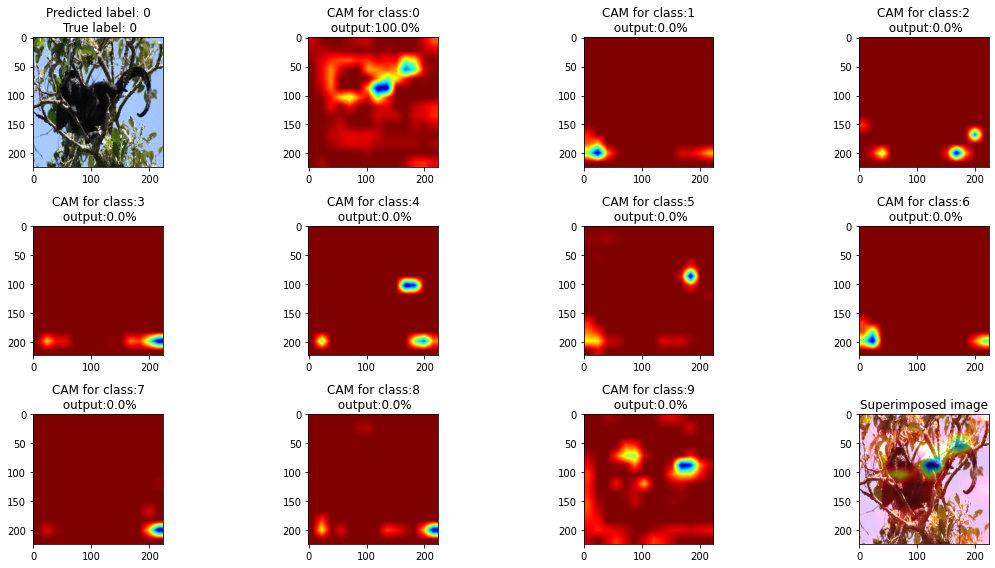

[1]


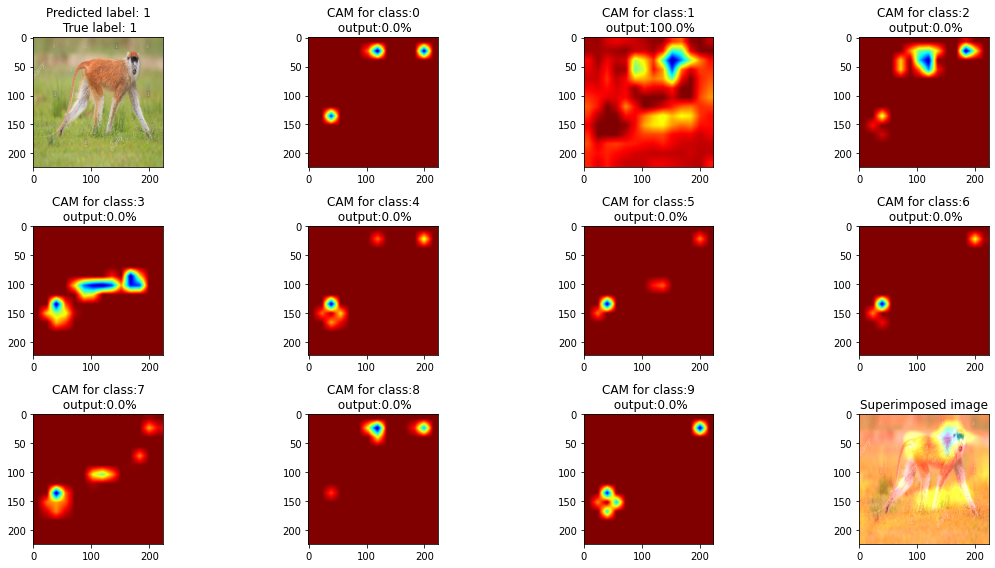

[2]


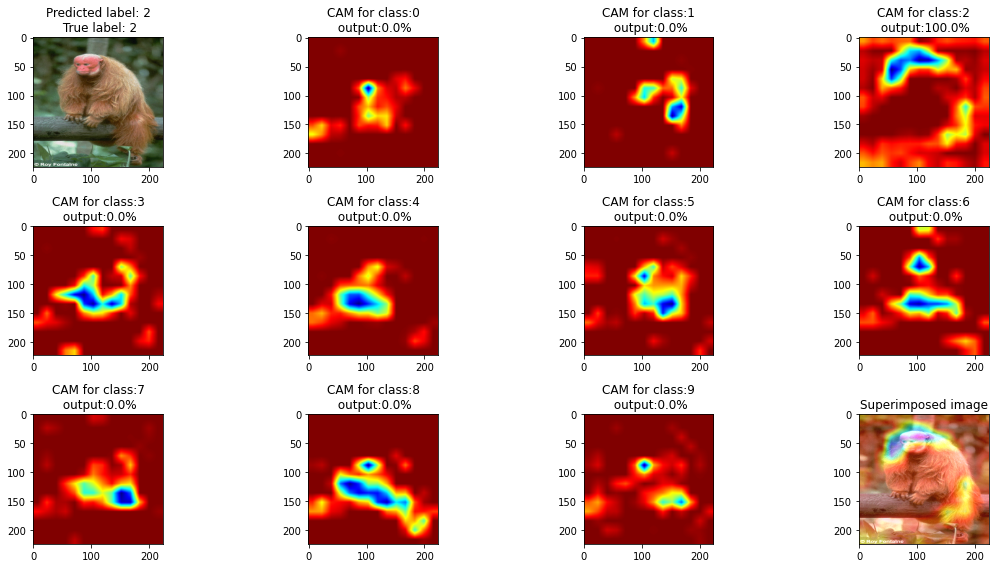

[3]


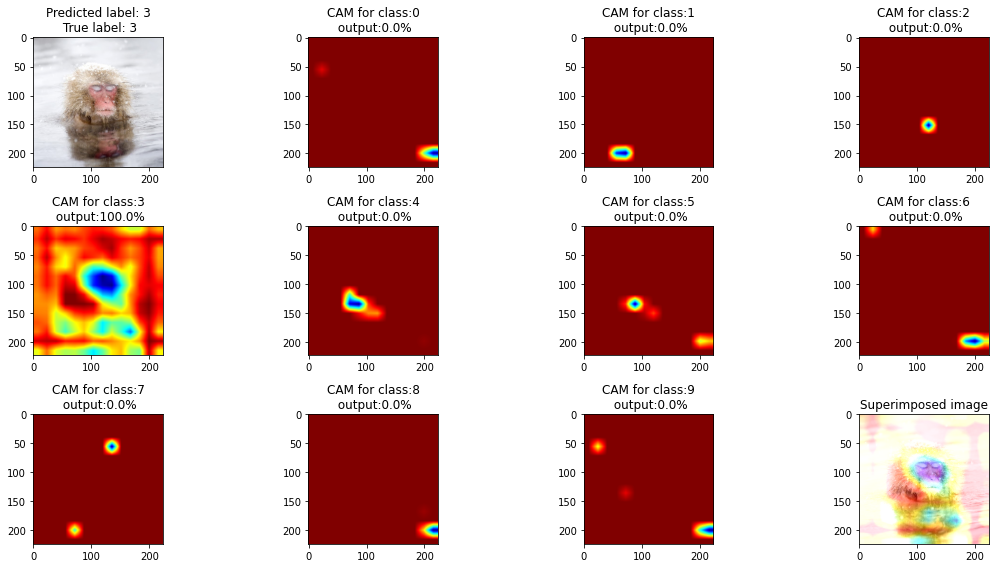

[4]


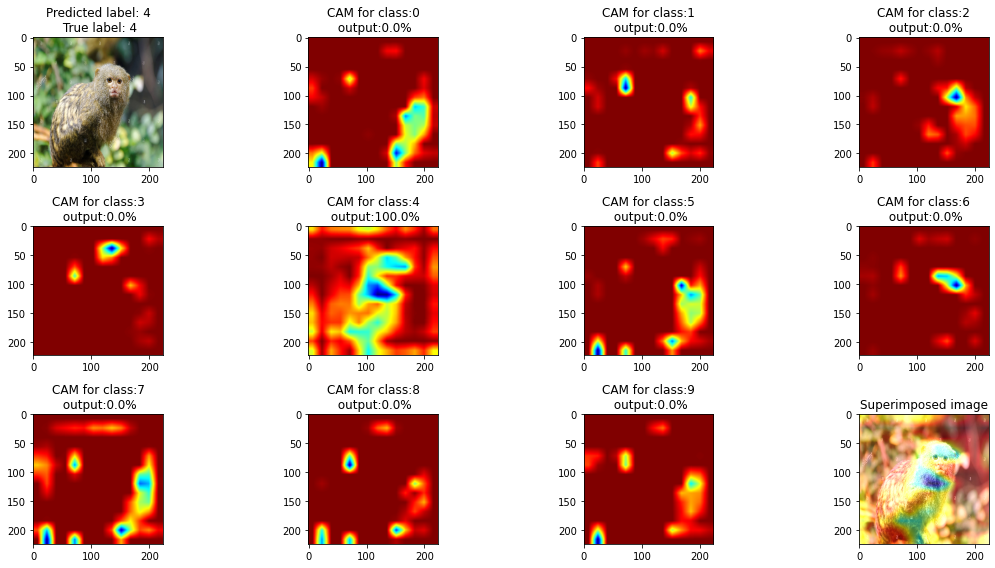

[5]


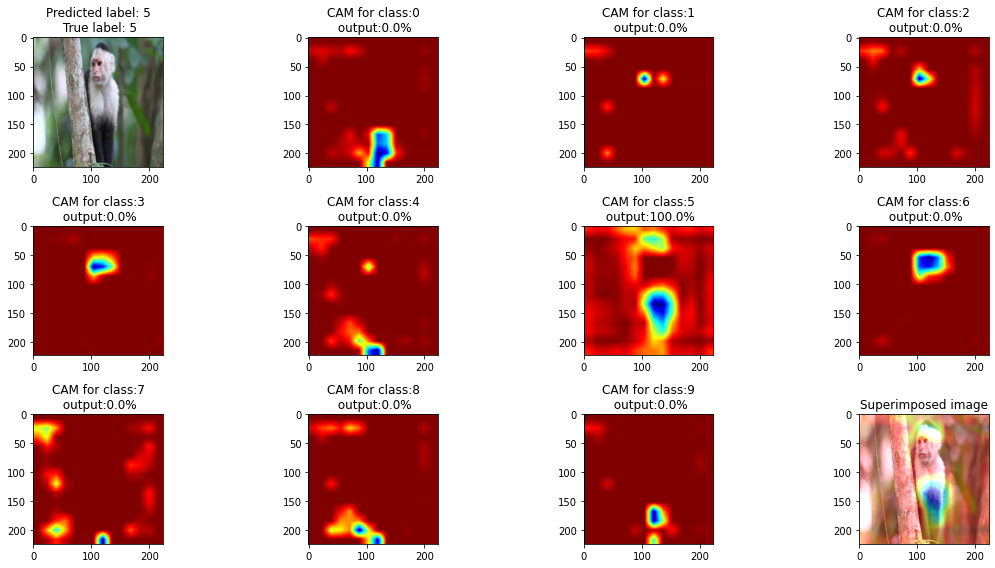

[6]


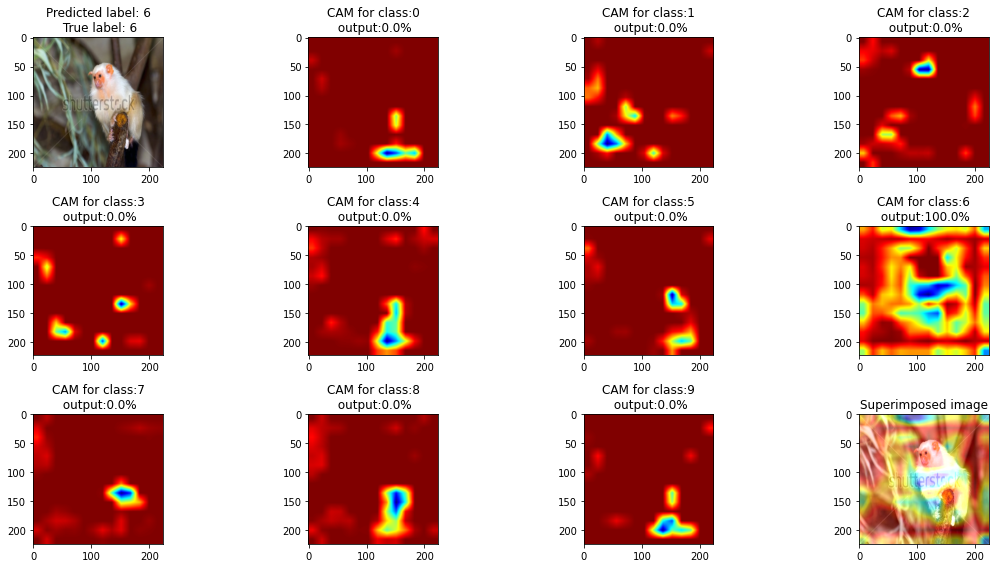

[7]


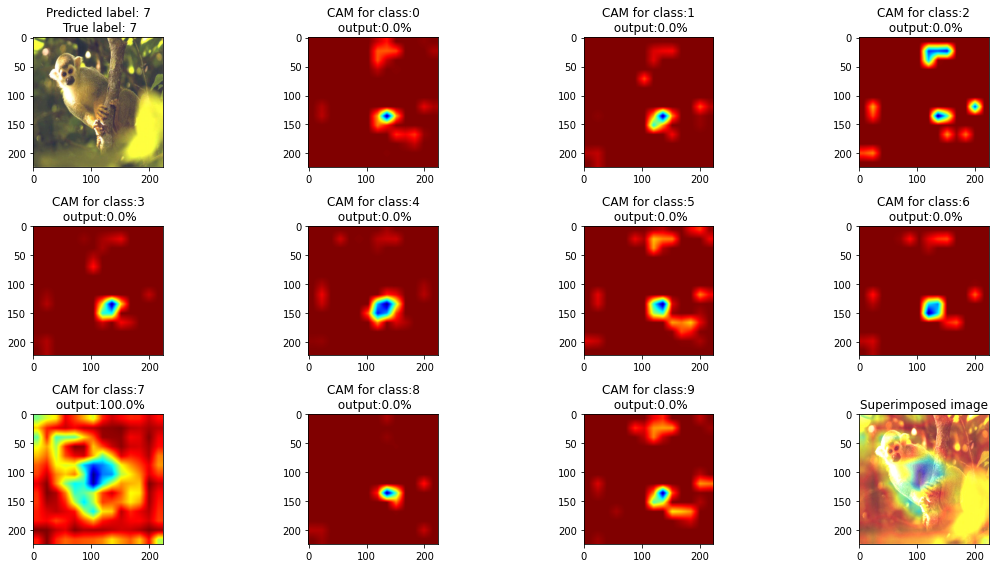

[8]


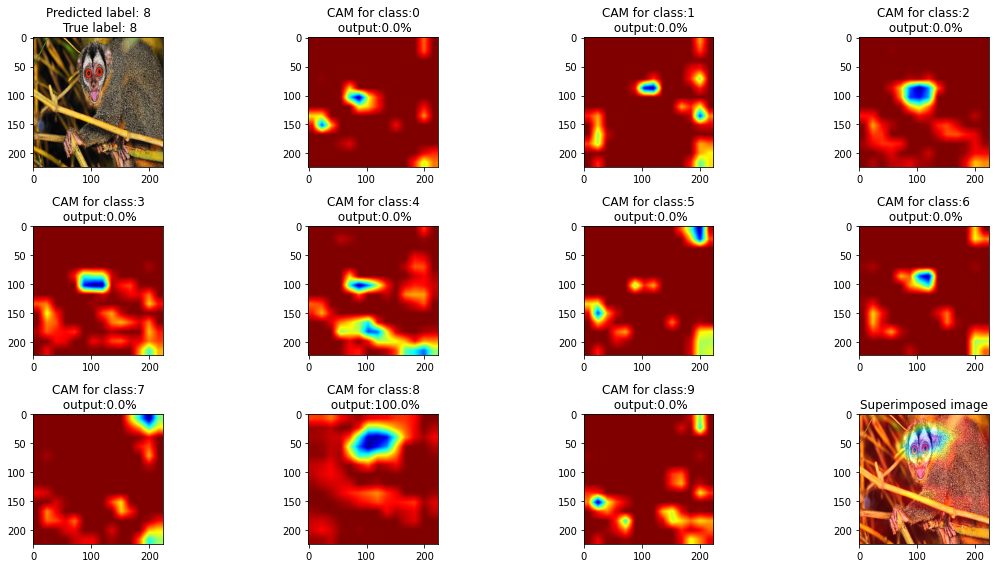

[9]


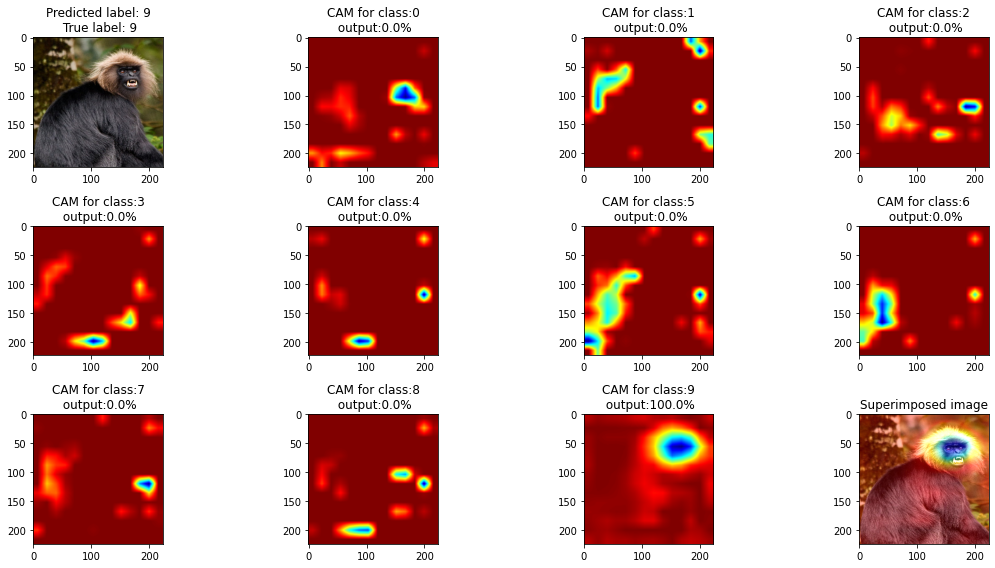

In [ ]:
plt.rcParams["figure.figsize"]=[20,8]
from keras import backend as K

monkey_examples = dict()

for i in range(len(valid_df)):
  if len(monkey_examples) == 10:
    break
  if not (valid_df.iloc[i]["label"] in monkey_examples):
    monkey_examples[valid_df.iloc[i]["label"]] = i

plt.rcParams["figure.figsize"]=[16,8]
for i in range(10):
  # get random image, true label, and predicted label
  idx= np.random.randint(100) # <- random number
  true_label = valid_df.iloc[monkey_examples[i]]["label"]


  ####### VISUALIZACIÓN INPUT
  sample_image = cv2.imread(valid_df.iloc[monkey_examples[i]]['image']) #read image from validation set
  sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)
  sample_image = cv2.resize(sample_image, (img_rows, img_cols))
  sample_label = valid_df.iloc[monkey_examples[i]]["label"]
  sample_image_processed = np.expand_dims(sample_image, axis=0)
  sample_image_processed = preprocess_input(sample_image_processed)
  predicted_label=np.argmax(model.predict(sample_image_processed), axis=-1)[0]
  plt.subplot(3,4,1)
  plt.title("Predicted label: "+str(predicted_label)+"\n True label: "+str(true_label))
  plt.imshow(sample_image)# <- Image is ready to plot

  ##### Visualización CAM
  heatmaps=[]
  kk=0
  predicted_label=np.argmax(model.predict(sample_image_processed), axis=-1)[0] #repeated for clearness
  print(np.argmax(model.predict(sample_image_processed), axis=-1))
  #for k in [0,predicted_label]:
  for k in range(10):
    predicted_output = model.output[:, k]
    # choose the last conv layer in your model
    last_conv_layer = model.get_layer('block5_conv3') #<....... you'll need to look what's the name of the last conv model.summary())
    grads = K.gradients(predicted_output, last_conv_layer.output)[0] #predicted output=loss, last_conv_layer=input al gradiente, ¿qué calculará el gradiente entonces?
    # take mean gradient per feature map
    grads = K.mean(grads, axis=(0,1,2))
    # Define a function that generates the values for the output and gradients
    evaluation_function = K.function([model.input], [grads, last_conv_layer.output[0]]) #en eager executions disabled estamos trabajando con tensores continuamente, 
                                                                                        # si siguen el código se darán cuenta que evaluation function mantiene 
                                                                                        # las definiciones de variables
    # get the values
    grads_values, conv_ouput_values = evaluation_function([sample_image_processed]) #run evaluation function
    # iterate over each feature map in yout conv output and multiply
    # the gradient values with the conv output values. This gives an 
    # indication of "how important a feature is"
    for i in range(conv_ouput_values.shape[-1]): # we have 512 features in our last conv layer
        conv_ouput_values[:,:,i] *= grads_values[i]
    # create a heatmap
    heatmap = np.mean(conv_ouput_values, axis=-1)
    # remove negative values
    heatmap = np.maximum(heatmap, 0)
    # re-scale
    heatmap /= heatmap.max()
    # get the heatmap for class activation map(CAM)
    heatmap = cv2.resize(heatmap, (sample_image.shape[0], sample_image.shape[1]))
    heatmap = heatmap *255
    heatmap = np.clip(heatmap, 0, 255).astype(np.uint8)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    plt.subplot(3,4,2+kk)
    plt.title("CAM for class:"+ str(k)+"\n output:"+str(np.round(model.predict(sample_image_processed)[0,k],2)*100)+"%")
    plt.imshow(heatmap)# <- Image is ready to plot
    kk+=1
    heatmaps.append(heatmap) # <- correct it
  # get the superimposed image
  super_imposed_image = heatmaps[predicted_label] * 0.5 + sample_image #<- correct it  
  super_imposed_image = np.clip(super_imposed_image, 0,255).astype(np.uint8)
  plt.subplot(3,4,12)
  plt.title("Superimposed image")
  plt.imshow(super_imposed_image)# <- Image is ready to plot
  plt.tight_layout()
  plt.show()

##### IV) **(Las preguntas de este ítem 2.b se tendrán que volver a implementar para futuras preguntas)** Visualice los feature maps de **todas** las capas convolucionales del modelo para una entrada de su elección (mantenga el id de esta imágen para cuando tenga que visualizar nuevamente en 3.c y 3.d). Apóyese en el siguiente código que las genera para la primera capa. 

**Pregunta:** ¿Cómo se relaciona esta información respecto a lo que nos entrega CAM? ¿Qué feature map ocupa CAM para construirse?

In [ ]:
# get random image, SELECCIONE UNA A GUSTO
idx= 84 # <- random number
true_label=valid_df.iloc[idx]['label']
####### VISUALIZACIÓN INPUT
sample_image = cv2.imread(valid_df.iloc[idx]['image'])
sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)
sample_image = cv2.resize(sample_image, (img_rows, img_cols))
sample_label = valid_df.iloc[idx]["label"]
sample_image_processed = np.expand_dims(sample_image, axis=0)
sample_image_processed = preprocess_input(sample_image_processed)

In [ ]:
from keras.models import Sequential
model.summary()
def get_n_layers(max_layer, original_model):
  truncated_model = Sequential()
  for layer in range(max_layer): #first is the input
    truncated_model.add(original_model.get_layer(index=layer))
  truncated_model.summary()
  return truncated_model

Model: "functional_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)      

In [ ]:
fet_maps_stacked=vis_model.predict(sample_image_processed)[0,:,:,:]
feature_maps=np.zeros((14*8,14*8))
k=0
for i in range(8):
  for j in range(8):
      feature_map = fet_maps_stacked[:,:,k]
      feature_map -= feature_map.mean()
      feature_map /= feature_map.std()
      feature_map *=255
      feature_map = np.clip(feature_map, 0, 255).astype(np.uint8)
      feature_maps[14*i:14*(i+1),14*j:14*(j+1)]=feature_map
      k+=1

In [ ]:
conv_layers = [2, 3, 5, 6,  8 , 9, 10, 12, 13, 14, 16,17,18]
layer_size = 224
all_f_maps = []

for n in conv_layers:
  print(layer_size)
  vis_model = get_n_layers(n, model)
  fet_maps_stacked=vis_model.predict(sample_image_processed)[0,:,:,:]
  feature_maps=np.zeros((layer_size*8,layer_size*8))
  k=0
  for i in range(8):
    for j in range(8):
        feature_map = fet_maps_stacked[:,:,k]
        feature_map -= feature_map.mean()
        feature_map /= feature_map.std()
        feature_map *=255
        feature_map = np.clip(feature_map, 0, 255).astype(np.uint8)
        feature_maps[layer_size*i:layer_size*(i+1),layer_size*j:layer_size*(j+1)]=feature_map
        k+=1
  all_f_maps.append(feature_maps)
  if n == 3 or n == 6 or n == 10 or n == 14:
    layer_size //= 2


224
Model: "sequential_19"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
Total params: 1,792
Trainable params: 0
Non-trainable params: 1,792
_________________________________________________________________
224
Model: "sequential_20"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
Total params: 38,720
Trainable params: 0
Non-trainable params: 38,720
_________________________________________________________________
112
Model: "sequential_21"
_________________________________________________________________
Layer (type)                 Output Shape              

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in true_divide
  from ipykernel import kernelapp as app


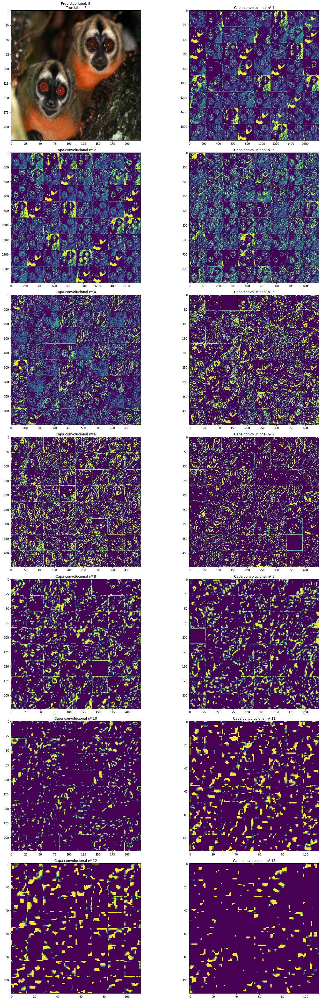

In [ ]:
plt.rcParams["figure.figsize"]=[20,50]
plt.subplot(7,2,1)
plt.title("Predicted label: "+str(np.argmax(model.predict(sample_image_processed), axis=-1)[0])+"\n True label: "+str(true_label))
plt.imshow(sample_image)# <- Image is ready to plot
for i in range(len(all_f_maps)):

  plt.subplot(7,2,2+i)
  plt.imshow(all_f_maps[i])
  plt.title("Capa convolucional nº " + str(i+1))
plt.tight_layout()
plt.show()

* ¿Cómo se relaciona esta información respecto a lo que nos entrega CAM?

Esta información corresponde al proceso de extracción de características por la CNN en cada capa, hasta llegar a la última, que es la que ocupará CAM para realizar los mapas de calor.

* ¿Qué feature map ocupa CAM para construirse?

Ocupa los feature map de la última capa, "block5_conv3". Estos se multiplican por el peso asociado a este y se suman, obteniendo así una grilla  de números que seria nuestro mapa de calor.



## 3.c Transfer learning parte II
I) **Repetir los puntos I) a IV) de la sección anterior** usando como red base VGG19 (Si es que desea utilizar otra no hay problema, visitar: https://keras.io/api/applications/). Para la visualización de CAM y feature maps, use las mismas imágenes de entrada para mejor comparación.


**A partir de los resultados responda: ¿Cómo cambió la estrategia de esta red respecto a la del punto anterior?**

In [ ]:
from keras.applications.vgg19 import VGG19
from keras.applications.vgg19 import preprocess_input
tf.keras.backend.clear_session()
tf.compat.v1.disable_eager_execution()


base_model = VGG19(input_shape=(img_rows, img_cols, img_channels), weights='imagenet', include_top=True)
#  get the output of the last layer
base_model_output = base_model.layers[-2].output
# # add new layers 
x = Dropout(0.7)(base_model_output)
output = Dense(10, activation='softmax')(x)
# define a new model 
model = tf.keras.models.Model(base_model.input, output)
# # Freeze all the base model layers
for layer in base_model.layers[:-1]:
    layer.trainable=False
my_callbacks = [History(), # Returns validation and training loss
    EarlyStopping(patience=2,monitor="val_accuracy", #Stops training when the validation loss doesnt get better in n°patience consecutive epochs
                                     restore_best_weights=True)]
model.compile(loss='categorical_crossentropy', optimizer=RMSprop(1e-3), metrics=['accuracy'])

In [ ]:
model.summary()

Model: "functional_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)      

In [ ]:
# number of training and validation steps for training and validation
nb_train_steps = int(np.ceil(len(train_df)/batch_size))
nb_valid_steps = int(np.ceil(len(valid_df)/batch_size))
# number of epochs 
nb_epochs=3

hist = model.fit(train_data_gen,      # ¿Demasiado lento?, revisar estar usando entorno de ejecución en modo GPU. Debiese demorarse aprox. 40 secs por epoch. Dejar verbose
                                          # para seguir el entrenamiento, esto tomará su tiempo en comparación con las demás secciones.
                              epochs=nb_epochs, 
                              steps_per_epoch=nb_train_steps, 
                              validation_data=valid_data_gen, 
                              validation_steps=nb_valid_steps,
                              callbacks=my_callbacks)

Epoch 1/3
137/137 [==============================] - 40s 293ms/step - batch: 68.0000 - size: 8.0000 - loss: 1.2941 - accuracy: 0.7026 - val_loss: 0.1341 - val_accuracy: 0.9485
Epoch 2/3
137/137 [==============================] - 38s 281ms/step - batch: 68.0000 - size: 8.0000 - loss: 0.3571 - accuracy: 0.9179 - val_loss: 0.1268 - val_accuracy: 0.9706
Epoch 3/3
137/137 [==============================] - 38s 277ms/step - batch: 68.0000 - size: 8.0000 - loss: 0.2902 - accuracy: 0.9407 - val_loss: 0.1662 - val_accuracy: 0.9706


##### II) Grafique los errores y accuracy de entrenamiento y validación a lo largo de los epochs. **Comente**

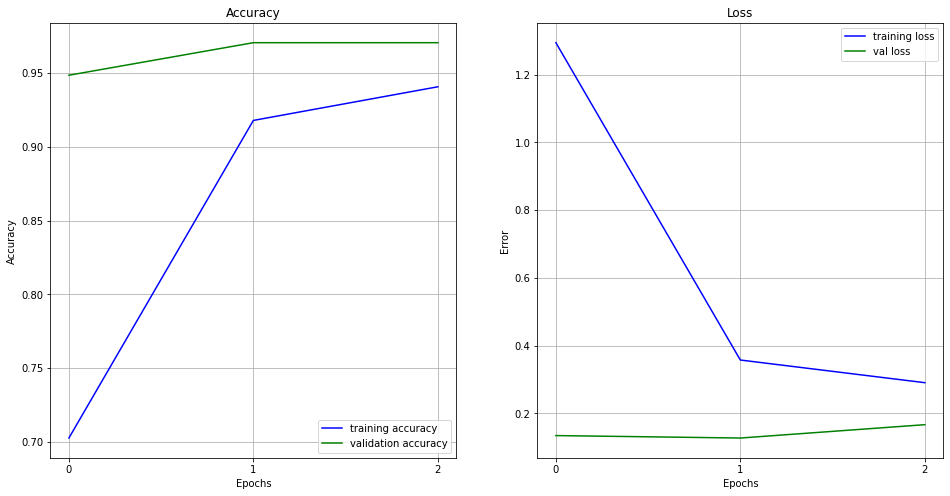

In [ ]:
import matplotlib.ticker as mticker

plt.rcParams["figure.figsize"]=[16,8]

plt.subplot(1,2,1)
plt.title("Accuracy")
plt.plot(hist.history["accuracy"],"b-", label="training accuracy")
plt.plot(hist.history['val_accuracy'], "g-", label="validation accuracy")
plt.xlabel("Epochs"),plt.ylabel("Accuracy")
plt.legend(),plt.grid()
plt.gca().xaxis.set_major_locator(mticker.MultipleLocator(1))
#...
plt.subplot(1,2,2)
plt.title("Loss")
plt.plot(hist.history["loss"],"b-", label="training loss")
plt.plot(hist.history["val_loss"],"g-",label="val loss")
plt.xlabel("Epochs"),plt.ylabel("Error")
plt.legend(),plt.grid()
plt.gca().xaxis.set_major_locator(mticker.MultipleLocator(1))

Se puede observar que son sólo 3 epoch se obtienen buenos resultados, con un accuracy de validación que supera al de entrenamiento y en el caso de los errores, el de validación se mantiene por debajo del de entrenamiento. En ambos casos la "curva" de validación presenta un mejor resultado, pero para ambos conjuntos se presenta un buen desempeño, con accuracy sobre 94% y errores bajo 0.3.

Respecto a la red VGG16 se obtienen resultandos similares pero un poco peores, ya que tanto para el conjunto de training como el de validación los errores obtienen valores mayores y en el caso de los accuracys, valores menores.

##### III) Realice la visualización del input (con título predicted label y true label), Class Activation Map (con título del label y salida de la red correspondiente), y superposición de input y CAM correspondiente al predicted label. **Deberá** modificar el código para obtener lo solicitado para 10 entradas distintas (1 para cada clase de mono) y su CAM para cada una de las 10 clases de monos. En total para cada clase de mono deberá obtener: 1 imágen de entrada de la clase de mono en cuestión, 10 CAM una para cada neurona del output de la red, y 1 superposición de la imágen de entrada y el CAM correspondiente a la predicción (por lo tanto, 120 imágenes en total). **Las imágenes tienen que ser claras, cada una de tamaño semejante a las que entrega el siguiente código.** Ocupe su herramienta gráfica preferida.

Apoyándose de las visualizaciones responda todas las preguntas siguientes:

**2) ¿Dónde se enfoca la red para verificar a qué clase de mono pertenece la imágen? ¿Qué estrategia asume la red para reconocer cada clase de mono?** 

Esta vez, en algunas razas se mantiene el enfoque en los rasgos de la cabeza (ver clase 7, 8 y 9). Sin embargo, con VGG19 se rescatan otras características, lo que se puede ver en el ejemplo de la clase 0, 1, 2 y 3. También se mantiene que la clase 5 se enfoca en el torso del mono para identificarlo.

La estrategia de esta red parece ser un poco más variada para cada clase. Ya que en los mapas se resaltan otras características de la imagen. Para la clase 0 y 6 parece que se le da más importancia al entorno o vegetación que rodea al mono. Mientras que para las clases 1, 2, 3, 4 y 5 se enfoca más en el contorno del mono o alguna característica física que no sea de la cara. Para las clases 7, 8 y 9 se sigue priorizando la cara, pero se destacan ciertas partes del cuerpo del mono también.

[0]


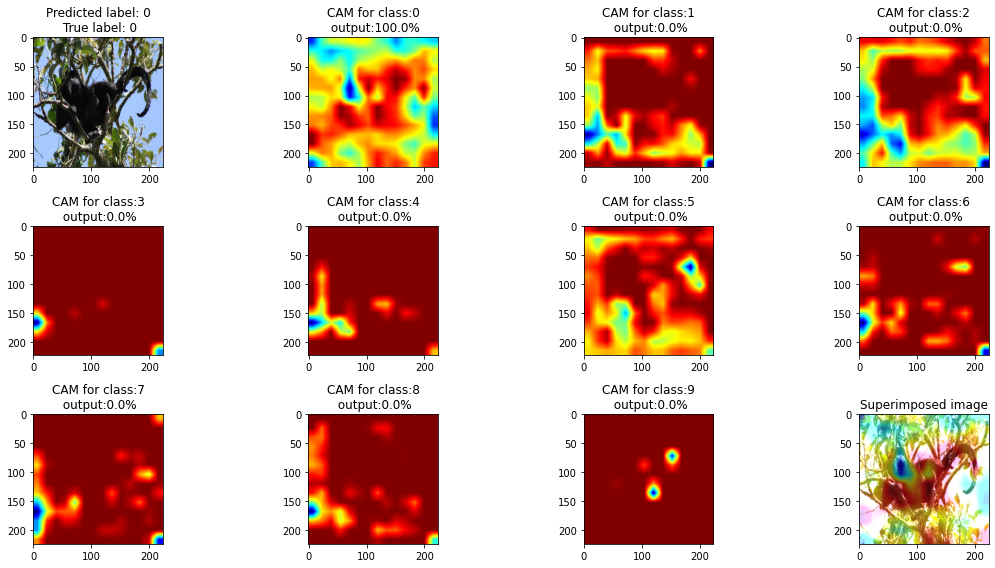

[1]


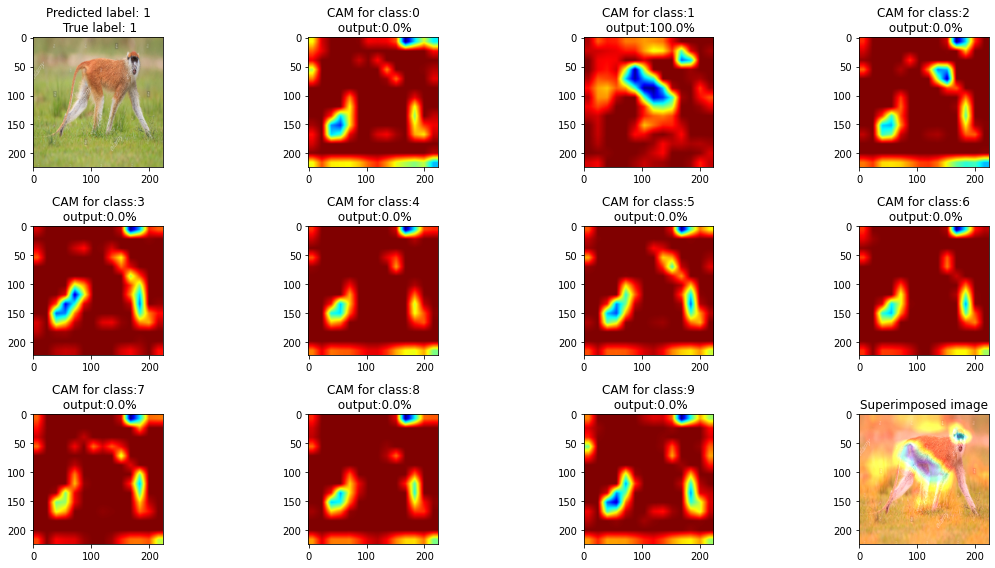

[2]


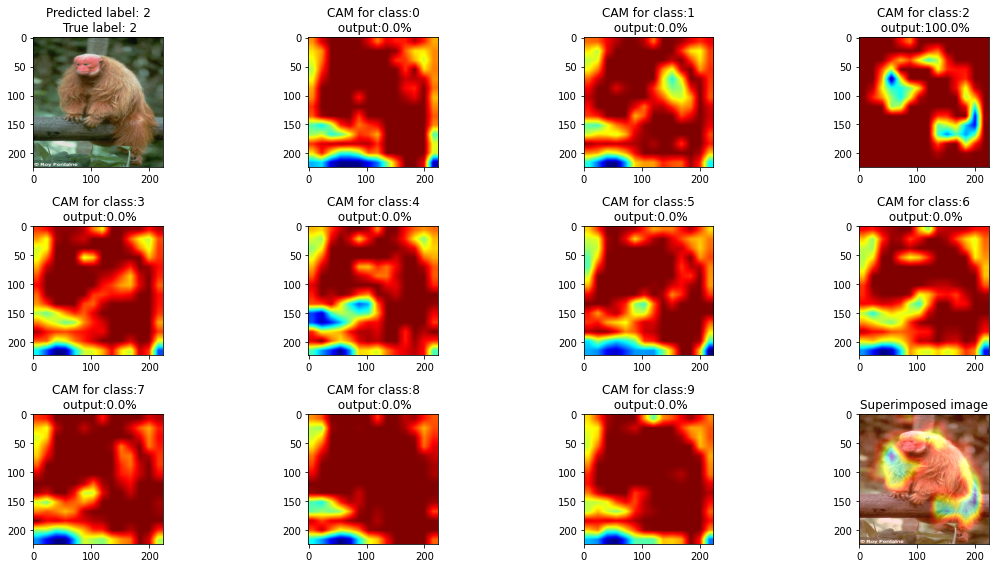

[3]


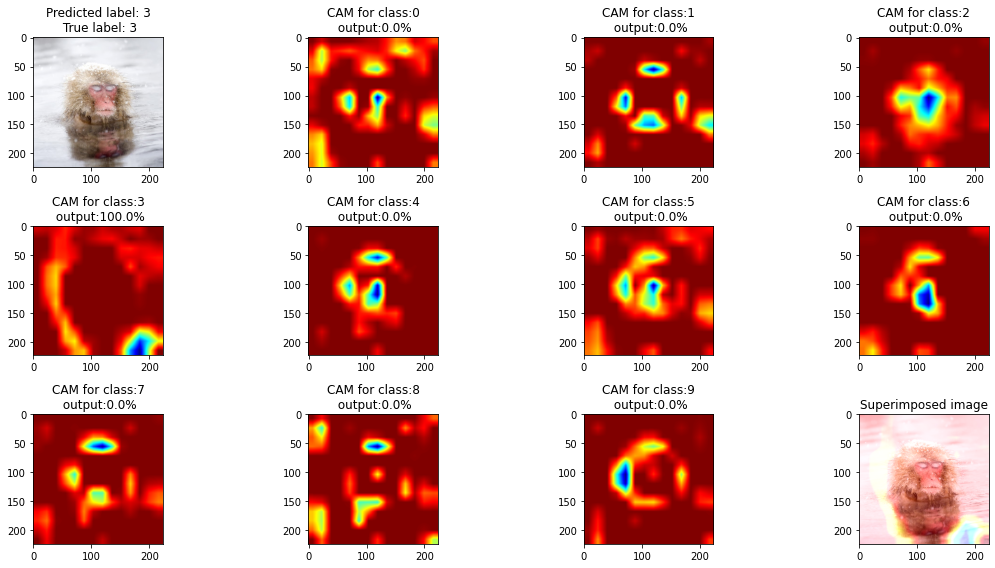

[4]


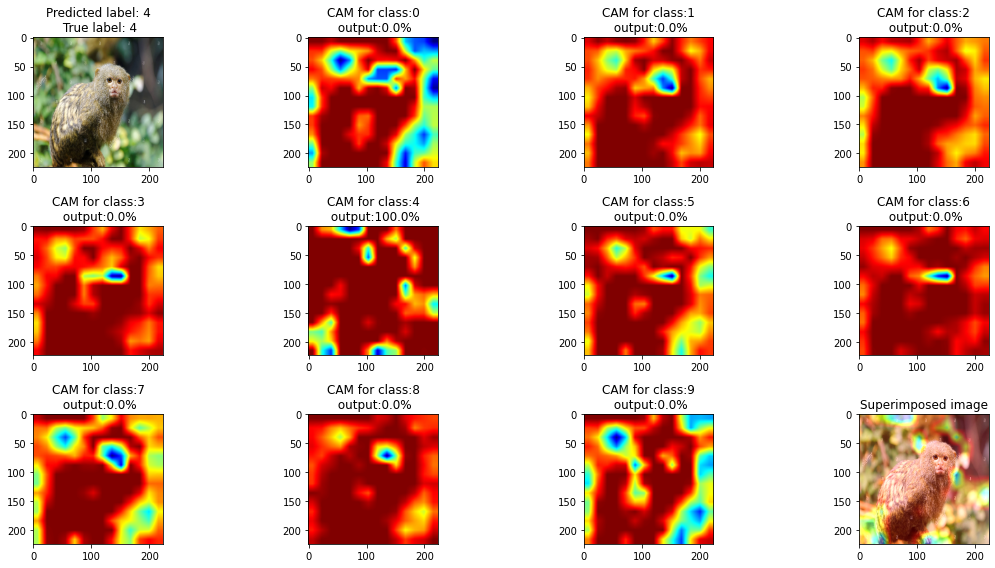

[5]


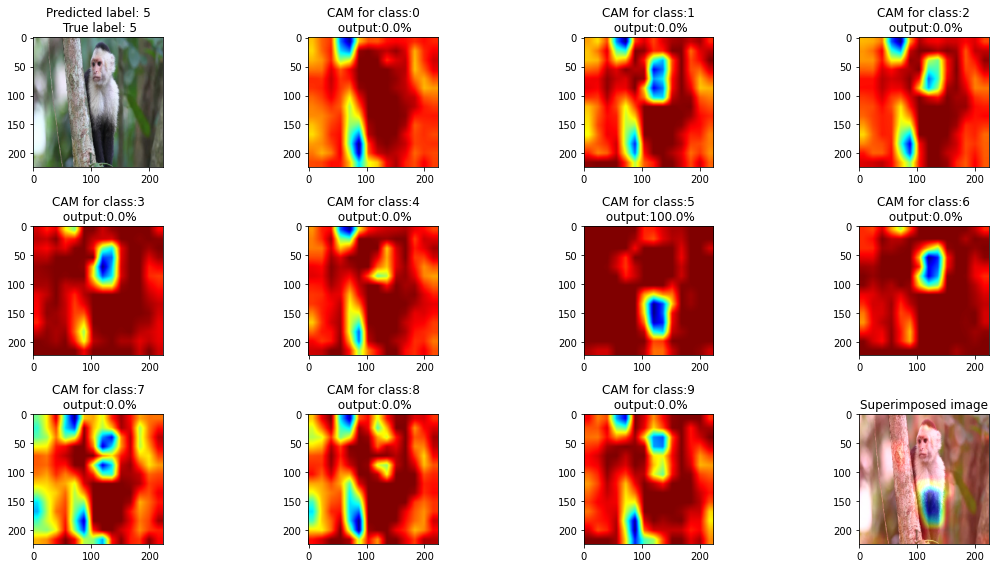

[6]


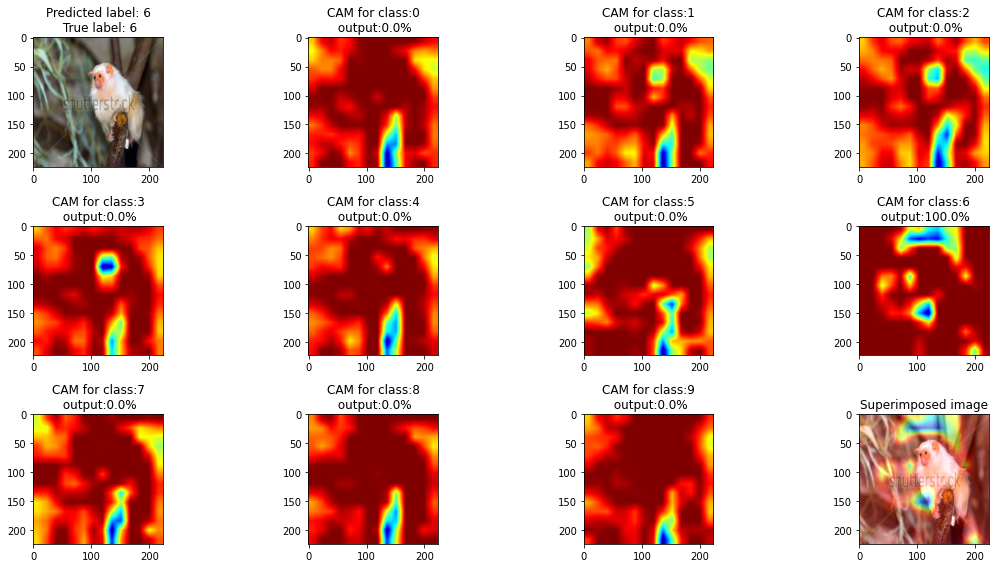

[7]


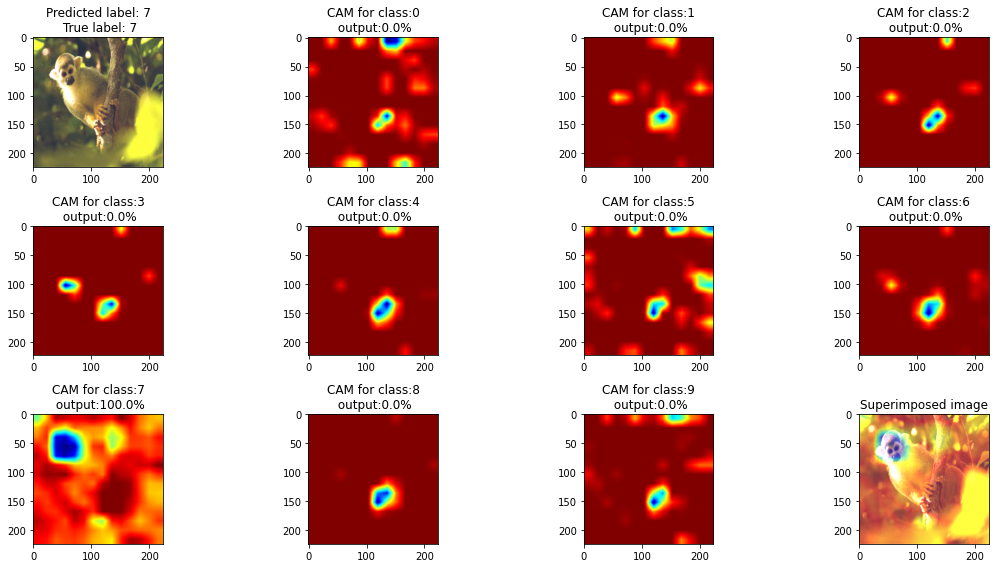

[8]


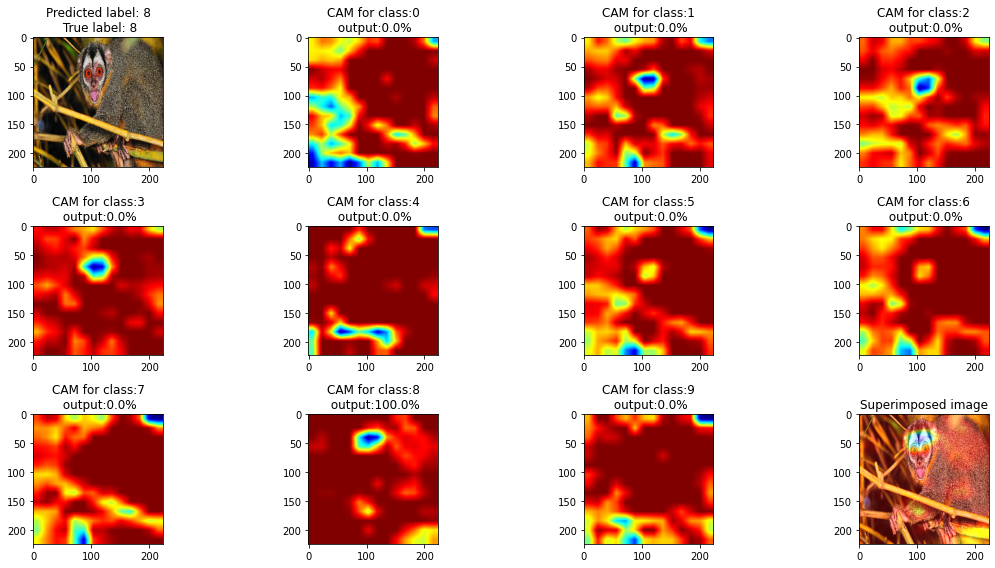

[9]


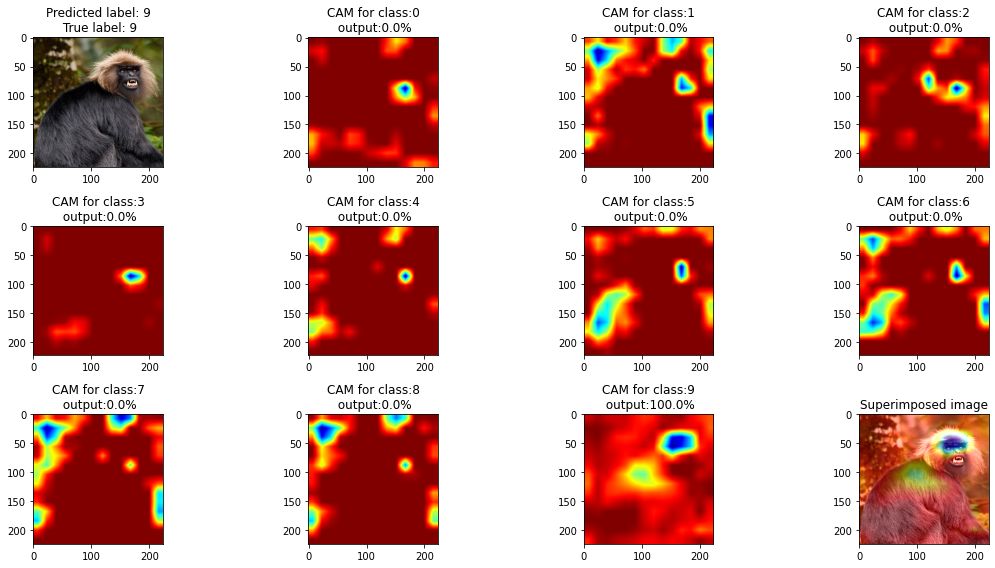

In [ ]:
plt.rcParams["figure.figsize"]=[20,8]
from keras import backend as K


plt.rcParams["figure.figsize"]=[16,8]
for i in range(10):
  # get random image, true label, and predicted label
  idx= np.random.randint(100) # <- random number
  #true_label=valid_df.iloc[idx]['label']
  true_label = valid_df.iloc[monkey_examples[i]]["label"]


  ####### VISUALIZACIÓN INPUT
  sample_image = cv2.imread(valid_df.iloc[monkey_examples[i]]['image']) #read image from validation set
  # sample_image = cv2.imread(valid_df.iloc[idx]['image'])
  sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)
  sample_image = cv2.resize(sample_image, (img_rows, img_cols))
  sample_label = valid_df.iloc[monkey_examples[i]]["label"]
  #sample_label = valid_df.iloc[idx]["label"]
  sample_image_processed = np.expand_dims(sample_image, axis=0)
  sample_image_processed = preprocess_input(sample_image_processed)
  predicted_label=np.argmax(model.predict(sample_image_processed), axis=-1)[0]
  plt.subplot(3,4,1)
  plt.title("Predicted label: "+str(predicted_label)+"\n True label: "+str(true_label))
  plt.imshow(sample_image)# <- Image is ready to plot

  ##### Visualización CAM
  heatmaps=[]
  kk=0
  predicted_label=np.argmax(model.predict(sample_image_processed), axis=-1)[0] #repeated for clearness
  print(np.argmax(model.predict(sample_image_processed), axis=-1))
  #for k in [0,predicted_label]:
  for k in range(10):
    predicted_output = model.output[:, k]
    # choose the last conv layer in your model
    last_conv_layer = model.get_layer('block5_conv3') #<....... you'll need to look what's the name of the last conv model.summary())
    grads = K.gradients(predicted_output, last_conv_layer.output)[0] #predicted output=loss, last_conv_layer=input al gradiente, ¿qué calculará el gradiente entonces?
    # take mean gradient per feature map
    grads = K.mean(grads, axis=(0,1,2))
    # Define a function that generates the values for the output and gradients
    evaluation_function = K.function([model.input], [grads, last_conv_layer.output[0]]) #en eager executions disabled estamos trabajando con tensores continuamente, 
                                                                                        # si siguen el código se darán cuenta que evaluation function mantiene 
                                                                                        # las definiciones de variables
    # get the values
    grads_values, conv_ouput_values = evaluation_function([sample_image_processed]) #run evaluation function
    # iterate over each feature map in yout conv output and multiply
    # the gradient values with the conv output values. This gives an 
    # indication of "how important a feature is"
    for i in range(conv_ouput_values.shape[-1]): # we have 512 features in our last conv layer
        conv_ouput_values[:,:,i] *= grads_values[i]
    # create a heatmap
    heatmap = np.mean(conv_ouput_values, axis=-1)
    # remove negative values
    heatmap = np.maximum(heatmap, 0)
    # re-scale
    heatmap /= heatmap.max()
    # get the heatmap for class activation map(CAM)
    heatmap = cv2.resize(heatmap, (sample_image.shape[0], sample_image.shape[1]))
    heatmap = heatmap *255
    heatmap = np.clip(heatmap, 0, 255).astype(np.uint8)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    plt.subplot(3,4,2+kk)
    plt.title("CAM for class:"+ str(k)+"\n output:"+str(np.round(model.predict(sample_image_processed)[0,k],2)*100)+"%")
    plt.imshow(heatmap)# <- Image is ready to plot
    kk+=1
    heatmaps.append(heatmap) # <- correct it
  # get the superimposed image
  super_imposed_image = heatmaps[predicted_label] * 0.5 + sample_image #<- correct it  
  super_imposed_image = np.clip(super_imposed_image, 0,255).astype(np.uint8)
  plt.subplot(3,4,12)
  plt.title("Superimposed image")
  plt.imshow(super_imposed_image)# <- Image is ready to plot
  plt.tight_layout()
  plt.show()

##### IV) Visualice los feature maps de **todas** las capas convolucionales del modelo para una entrada de su elección (mantenga el id de esta imágen para cuando tenga que visualizar nuevamente en 3.c y 3.d). Apóyese en el siguiente código que las genera para la primera capa. 

**Pregunta:** ¿Cómo se relaciona esta información respecto a lo que nos entrega CAM? ¿Qué feature map ocupa CAM para construirse?

In [ ]:
idx= 84 # <- random number
true_label=valid_df.iloc[idx]['label']
####### VISUALIZACIÓN INPUT
sample_image = cv2.imread(valid_df.iloc[idx]['image'])
sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)
sample_image = cv2.resize(sample_image, (img_rows, img_cols))
sample_label = valid_df.iloc[idx]["label"]
sample_image_processed = np.expand_dims(sample_image, axis=0)
sample_image_processed = preprocess_input(sample_image_processed)

from keras.models import Sequential
model.summary()
def get_n_layers(max_layer, original_model):
  truncated_model = Sequential()
  for layer in range(max_layer): #first is the input
    truncated_model.add(original_model.get_layer(index=layer))
  truncated_model.summary()
  return truncated_model

Model: "functional_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)      

In [ ]:
conv_layers = [2, 3, 5, 6,  8 , 9, 10, 11, 13, 14, 15, 16, 18, 19, 20, 21]
layer_size = 224
all_f_maps = []

for n in conv_layers:
  print(layer_size)
  vis_model = get_n_layers(n, model)
  fet_maps_stacked=vis_model.predict(sample_image_processed)[0,:,:,:]
  feature_maps=np.zeros((layer_size*8,layer_size*8))
  k=0
  for i in range(8):
    for j in range(8):
        feature_map = fet_maps_stacked[:,:,k]
        feature_map -= feature_map.mean()
        feature_map /= feature_map.std()
        feature_map *=255
        feature_map = np.clip(feature_map, 0, 255).astype(np.uint8)
        feature_maps[layer_size*i:layer_size*(i+1),layer_size*j:layer_size*(j+1)]=feature_map
        k+=1
  all_f_maps.append(feature_maps)
  if n == 3 or n == 6 or n == 11 or n == 16:
    layer_size //= 2

224
Model: "sequential_11"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
Total params: 1,792
Trainable params: 0
Non-trainable params: 1,792
_________________________________________________________________
224
Model: "sequential_12"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
Total params: 38,720
Trainable params: 0
Non-trainable params: 38,720
_________________________________________________________________
112
Model: "sequential_13"
_________________________________________________________________
Layer (type)                 Output Shape              

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in true_divide
  from ipykernel import kernelapp as app


14
Model: "sequential_24"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0         
_________________________________________________________________
block3_conv1 (Conv2D)        (None, 56, 56, 256)  

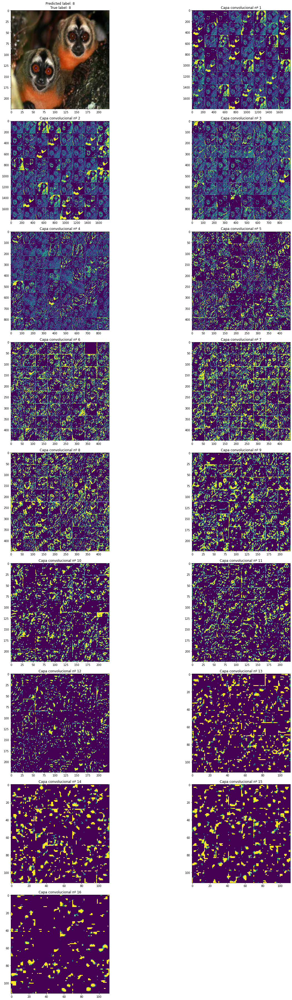

In [ ]:

plt.rcParams["figure.figsize"]=[20,50]
plt.subplot(9,2,1)
plt.title("Predicted label: "+str(np.argmax(model.predict(sample_image_processed), axis=-1)[0])+"\n True label: "+str(true_label))
plt.imshow(sample_image)# <- Image is ready to plot
for i in range(len(all_f_maps)):

  plt.subplot(9,2,2+i)
  plt.imshow(all_f_maps[i])
  plt.title("Capa convolucional nº " + str(i+1))
plt.tight_layout()
plt.show()

* ¿Cómo se relaciona esta información respecto a lo que nos entrega CAM?

Esta información corresponde al proceso de extracción de características por la CNN en cada capa, hasta llegar a la última, que es la que ocupará CAM para realizar los mapas de calor.

* ¿Qué feature map ocupa CAM para construirse?

Ocupa los feature map de la última capa, "block5_conv4". Estos se multiplican por el peso asociado a este y se suman, obteniendo así una grilla  de números que seria nuestro mapa de calor.


## 3.d CNN con skip connections

Otra manera de mejorar los resultados de las redes, sobretodo de las redes profundas donde se observa el problema de _vanishing gradient_ son las relativamente nuevas _skip connections_ o redes residuales. En vez de preocuparse de cómo manejar los pesos de la red para permitir que el gradiente no explote o no desaparezca, se permite al gradiente "pasar" sin ser modificado, agregando conecciones con pesos fijos entre capas de distintas profundidades, en la práctica permitiendo a la señar "saltarse" las capas intermedias. Esta idea ha permitido desarrollos como los de ResNet, llegando a profundidades de cientos de capas y aún logrando aprendizaje. 

Basandose en el código mostrado abajo, implemente una ResNet de su gusto. _Tip: Utilice BatchNormalization después de cada capa convolucional._

**Obtenga un error de validación superior al 50%**. _No tenga miedo de subir la profundidad, pero sí de la cantidad de hiperparámetros a entrenar, checkear model.summary()_

**Repita los pasos II) a IV) de las secciones anteriores. Comente**

In [ ]:
from keras.models import Sequential
from keras.layers import Dense, Flatten
from keras.layers import Conv2D, MaxPooling2D, Input, concatenate
from keras.optimizers import RMSprop
from keras.callbacks import History, EarlyStopping
from keras.layers.normalization import BatchNormalization
import tensorflow as tf
tf.keras.backend.clear_session()
tf.compat.v1.disable_eager_execution()

x = Input(shape=(img_rows, img_cols, img_channels))
y = Conv2D(64, (3,3),padding='same',activation='relu')(x)
y = BatchNormalization()(y)
y = Conv2D(64, (3,3),padding='same',activation='relu')(y)
y = BatchNormalization()(y)
z = concatenate([x, y])

z = MaxPooling2D(pool_size=(2, 2))(z)

y = Conv2D(64, (3,3),padding='same',activation='relu')(z)
y = BatchNormalization()(y)
y = Conv2D(64, (3,3),padding='same',activation='relu')(y)
y = BatchNormalization()(y)
z = concatenate([z, y])

# . . .
z = MaxPooling2D(pool_size=(2, 2))(z)

y = Conv2D(64, (3,3),padding='same',activation='relu')(z)
y = BatchNormalization()(y)
y = Conv2D(64, (3,3),padding='same',activation='relu')(y)
y = BatchNormalization()(y)
z = concatenate([z, y])

z = MaxPooling2D(pool_size=(2, 2))(z)

y = Conv2D(64, (3,3),padding='same',activation='relu')(z)
y = BatchNormalization()(y)
y = Conv2D(64, (3,3),padding='same',activation='relu')(y)
y = BatchNormalization()(y)
z = concatenate([z, y])

z = MaxPooling2D(pool_size=(2, 2))(z)

y = Conv2D(64, (3,3),padding='same',activation='relu')(z)
y = BatchNormalization()(y)
y = Conv2D(64, (3,3),padding='same',activation='relu')(y)
y = BatchNormalization()(y)
z = concatenate([z, y])


z = MaxPooling2D(pool_size=(2, 2))(z)

y = Conv2D(64, (3,3),padding='same',activation='relu')(z)
y = BatchNormalization()(y)
y = Conv2D(64, (3,3),padding='same',activation='relu')(y)
y = BatchNormalization()(y)
z = concatenate([z, y])

z = MaxPooling2D(pool_size=(2, 2))(z)

y = Conv2D(64, (3,3),padding='same',activation='relu')(z)
y = BatchNormalization()(y)
y = Conv2D(64, (3,3),padding='same',activation='relu')(y)
y = BatchNormalization()(y)
z = concatenate([z, y])

# . . . 

z = Flatten()(z)
z = Dense(256 + 64, activation='relu')(z)
z = BatchNormalization()(z)
out = Dense(10, activation='softmax')(z)

res_mod = tf.keras.models.Model(x,out)

my_callbacks = [History(), # Returns validation and training loss
    EarlyStopping(patience=2,monitor="val_accuracy", #Stops training when the validation loss doesnt get better in n°patience consecutive epochs,keep it at 100 it's only to show u
                                     restore_best_weights=True)]


optimizer = RMSprop(0.001)
res_mod.compile(loss='categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])
# summary
res_mod.summary()

Model: "functional_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 224, 224, 64) 1792        input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 224, 224, 64) 256         conv2d[0][0]                     
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 224, 224, 64) 36928       batch_normalization[0][0]        
_______________________________________________________________________________________

In [ ]:
# number of training and validation steps for training and validation
nb_train_steps = int(np.ceil(len(train_df)/batch_size))
nb_valid_steps = int(np.ceil(len(valid_df)/batch_size))
# number of epochs 
nb_epochs=10 # si no obtuvo el resultado deseado en 10 epochs 

hist = res_mod.fit(train_data_gen,      # ¿Demasiado lento?, revisar estar usando entorno de ejecución en modo GPU. Debiese demorarse aprox. 40 secs por epoch. Dejar verbose
                                          # para seguir el entrenamiento, esto tomará su tiempo en comparación con las demás secciones.
                              epochs=nb_epochs, 
                              steps_per_epoch=nb_train_steps, 
                              validation_data=valid_data_gen, 
                              validation_steps=nb_valid_steps,
                              callbacks=my_callbacks)

Epoch 1/10
137/137 [==============================] - ETA: 0s - batch: 68.0000 - size: 8.0000 - loss: 1.8250 - accuracy: 0.4051WARNING:tensorflow:From /usr/local/lib/python3.6/dist-packages/tensorflow/python/keras/engine/training_v1.py:2048: Model.state_updates (from tensorflow.python.keras.engine.training) is deprecated and will be removed in a future version.
Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.
137/137 [==============================] - 39s 288ms/step - batch: 68.0000 - size: 8.0000 - loss: 1.8250 - accuracy: 0.4051 - val_loss: 3.7932 - val_accuracy: 0.3676
Epoch 2/10
137/137 [==============================] - 40s 288ms/step - batch: 68.0000 - size: 8.0000 - loss: 1.3705 - accuracy: 0.5666 - val_loss: 1.6640 - val_accuracy: 0.5074
Epoch 3/10
137/137 [==============================] - 39s 283ms/step - batch: 68.0000 - size: 8.0000 - loss: 1.1293 - accuracy: 0.6451 - val_loss: 1.3748 - val_accuracy: 0.5699

##### II) Grafique los errores y accuracy de entrenamiento y validación a lo largo de los epochs. **Comente**

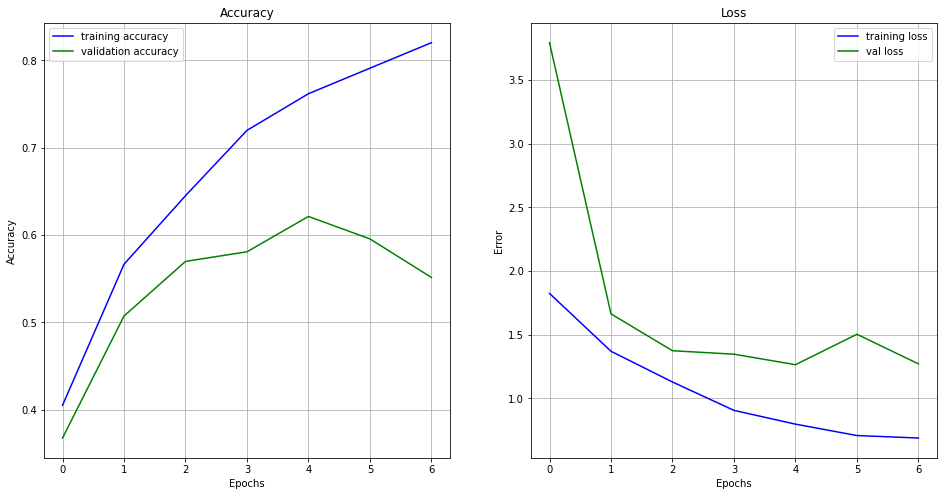

In [ ]:
import matplotlib.ticker as mticker

plt.rcParams["figure.figsize"]=[16,8]

plt.subplot(1,2,1)
plt.title("Accuracy")
plt.plot(hist.history["accuracy"],"b-", label="training accuracy")
plt.plot(hist.history['val_accuracy'], "g-", label="validation accuracy")
plt.xlabel("Epochs"),plt.ylabel("Accuracy")
plt.legend(),plt.grid()
plt.gca().xaxis.set_major_locator(mticker.MultipleLocator(1))
#...
plt.subplot(1,2,2)
plt.title("Loss")
plt.plot(hist.history["loss"],"b-", label="training loss")
plt.plot(hist.history["val_loss"],"g-",label="val loss")
plt.xlabel("Epochs"),plt.ylabel("Error")
plt.legend(),plt.grid()
plt.gca().xaxis.set_major_locator(mticker.MultipleLocator(1))

Se destaca el hecho de haber podido llegar a un 62% de accuracy en el conjunto de validación en la epoch 5. Esto es un buen resultado considerando que no se 
realizó transfer learning ya que estamos creando una CNN desde cero.

En comparación con las arquitecturas anteriores se necesitaron más epochs y se obtuvieron resultados claramente peores. Además, en estos casos, los desempeños en el conjunto de entrenamiento son mejores que los del de validación.

Se podría aspirar a tener mejores errores probando con distintas configuraciones de la red (probar con menos o más capas convolucionales, por ejemplo).

##### III) Realice la visualización del input (con título predicted label y true label), Class Activation Map (con título del label y salida de la red correspondiente), y superposición de input y CAM correspondiente al predicted label. **Deberá** modificar el código para obtener lo solicitado para 10 entradas distintas (1 para cada clase de mono) y su CAM para cada una de las 10 clases de monos. En total para cada clase de mono deberá obtener: 1 imágen de entrada de la clase de mono en cuestión, 10 CAM una para cada neurona del output de la red, y 1 superposición de la imágen de entrada y el CAM correspondiente a la predicción (por lo tanto, 120 imágenes en total). **Las imágenes tienen que ser claras, cada una de tamaño semejante a las que entrega el siguiente código.** Ocupe su herramienta gráfica preferida.

Apoyándose de las visualizaciones responda todas las preguntas siguientes:

**2) ¿Dónde se enfoca la red para verificar a qué clase de mono pertenece la imágen? ¿Qué estrategia asume la red para reconocer cada clase de mono?** 

A grandes rasgos no se puede visualizar en que se enfoca para identificar que clase de mono se le está dando de Input. A pesar de lo anterior, se tuvo una predicción correcta de las clases, exceptuando el ejemplo 4, 8 y 9.

Se debe destacar además, que en ciertas clases el CAM no aporta información al respecto y el output escogido presenta un color sólido. Lo anterior corresponde a los ejemplos 1, 4, 5 y 8.

Para los ejemplos 0 y 2, la red parece centrarse en todo el mono para determinar si corresponde o no.

Por último, el resto de ejemplos (3, 6, 7, 9) no parecen enforcarse en el mono para determinar el resultado, aunque se podría decir que en el ejemplo 9 se está enfocando en su pierna.

[0]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: invalid value encountered in true_divide


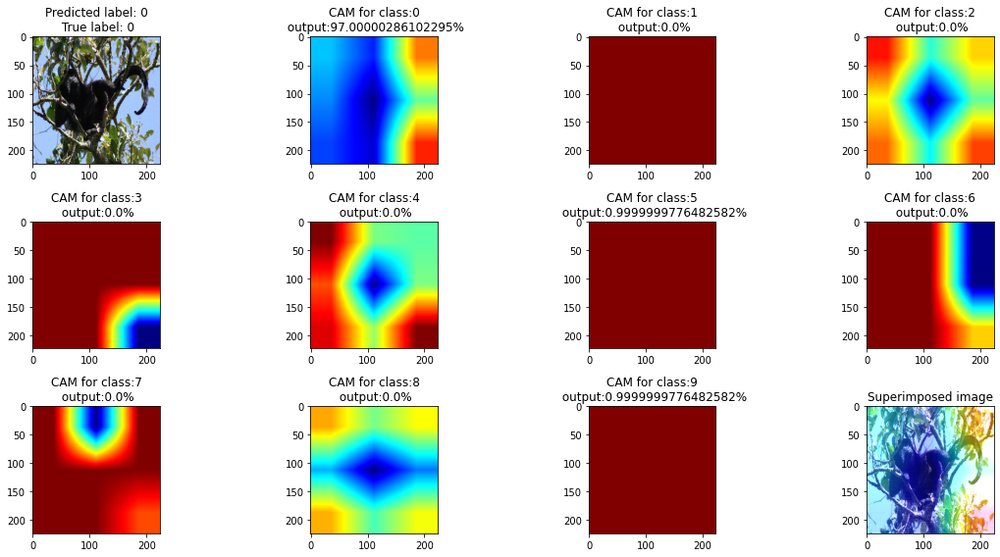

[1]


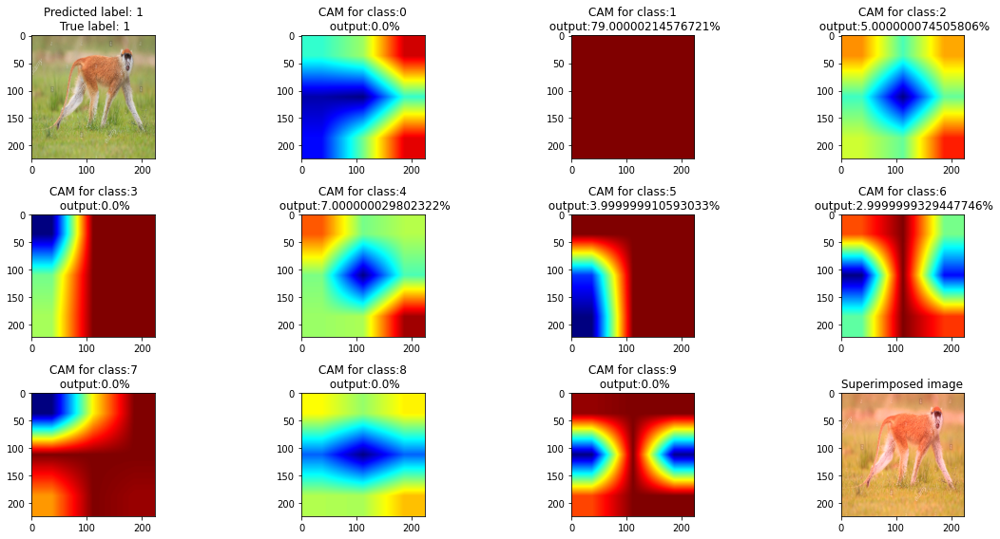

[2]


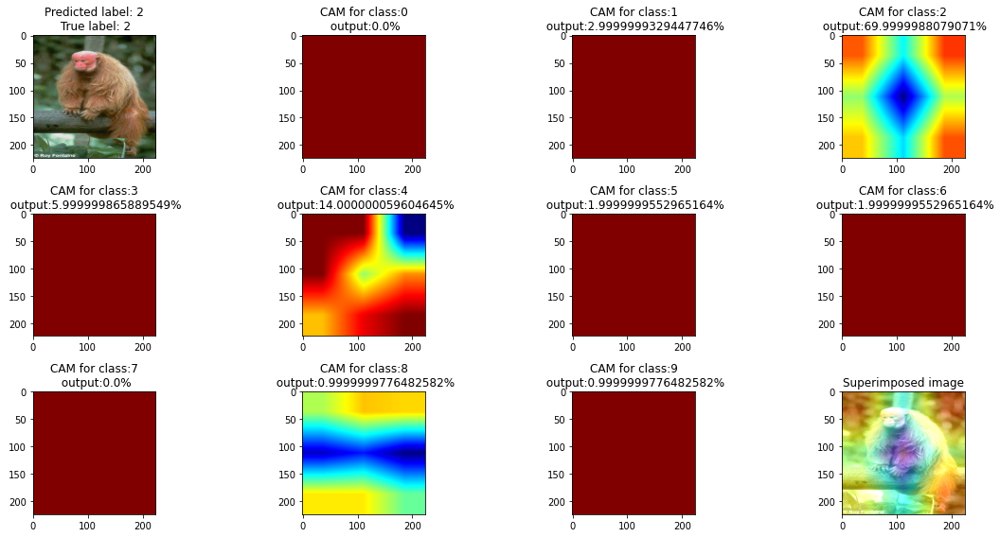

[3]


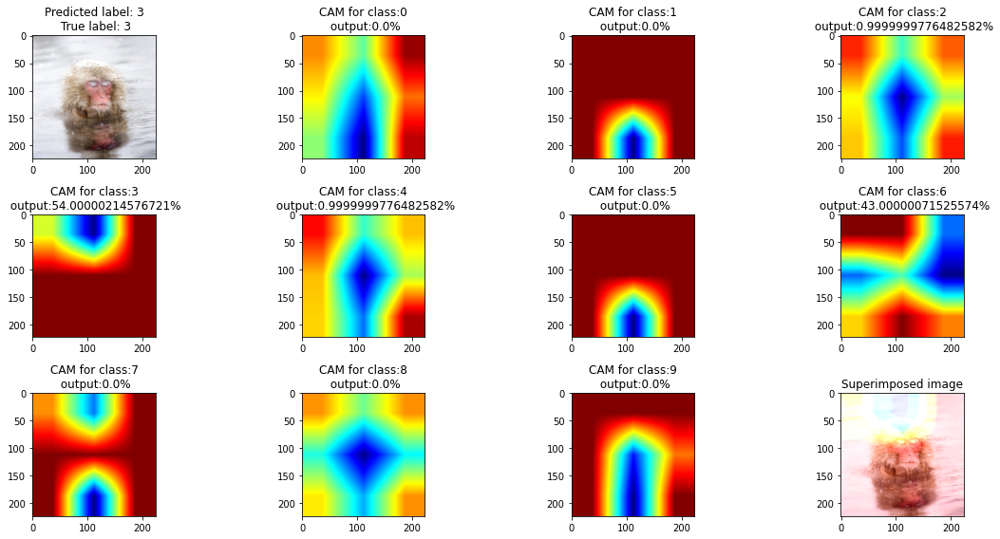

[5]


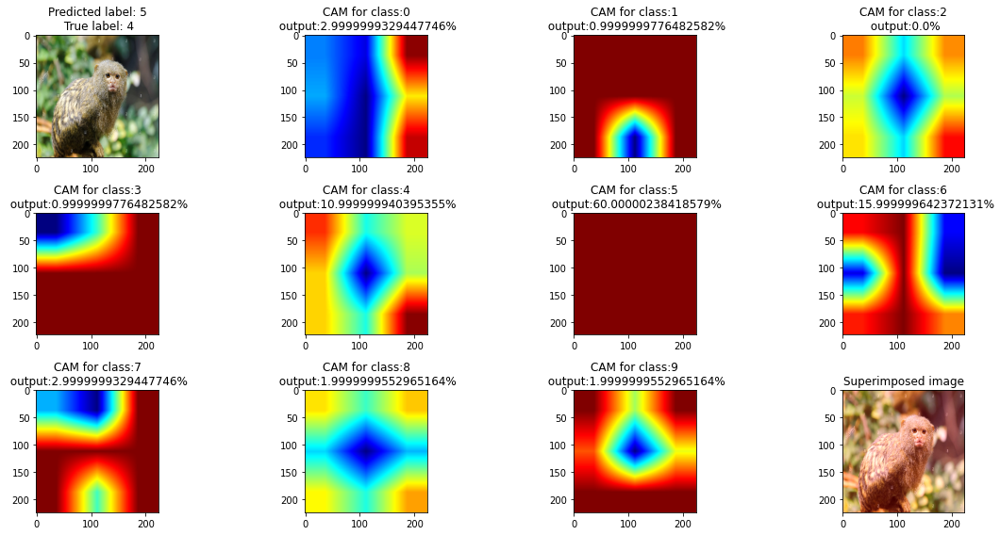

[5]


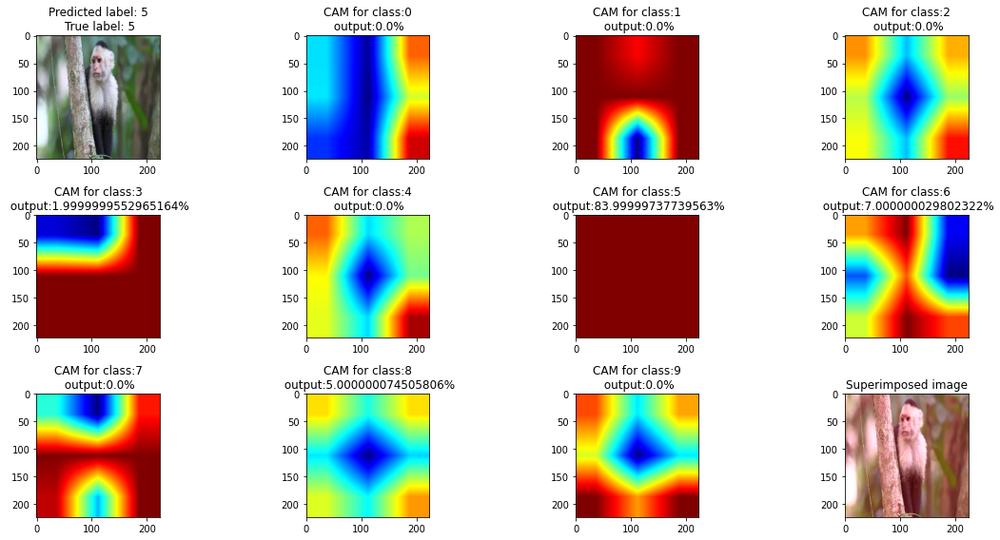

[6]


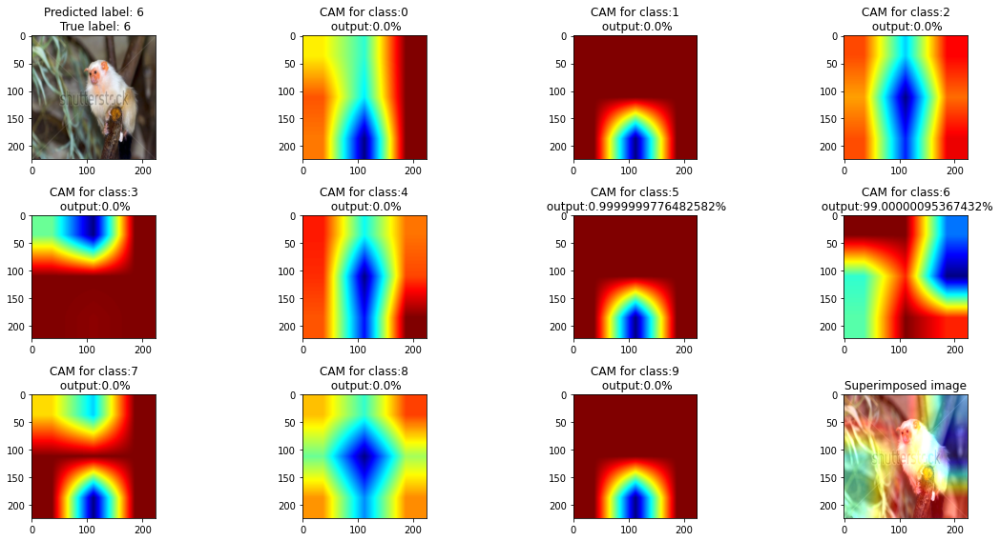

[7]


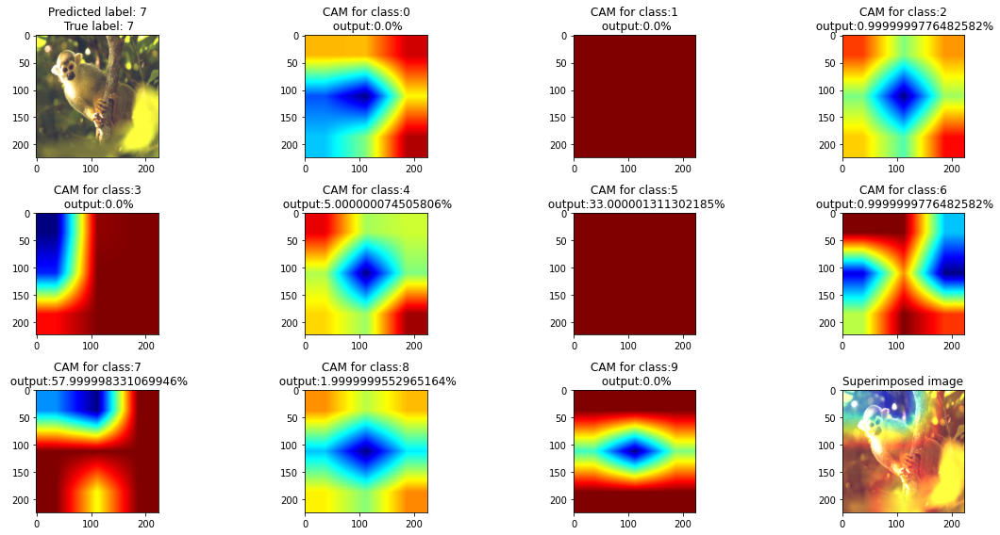

[0]


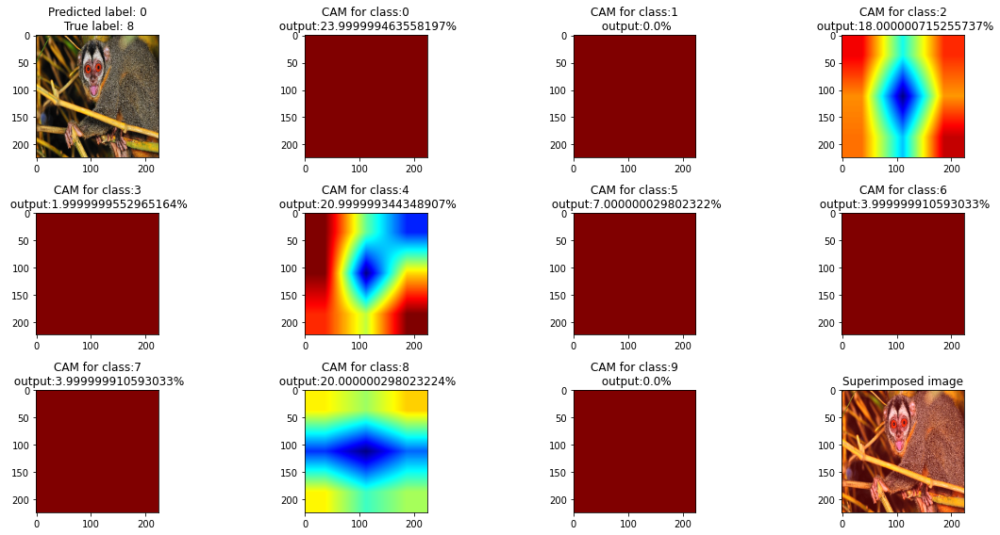

[1]


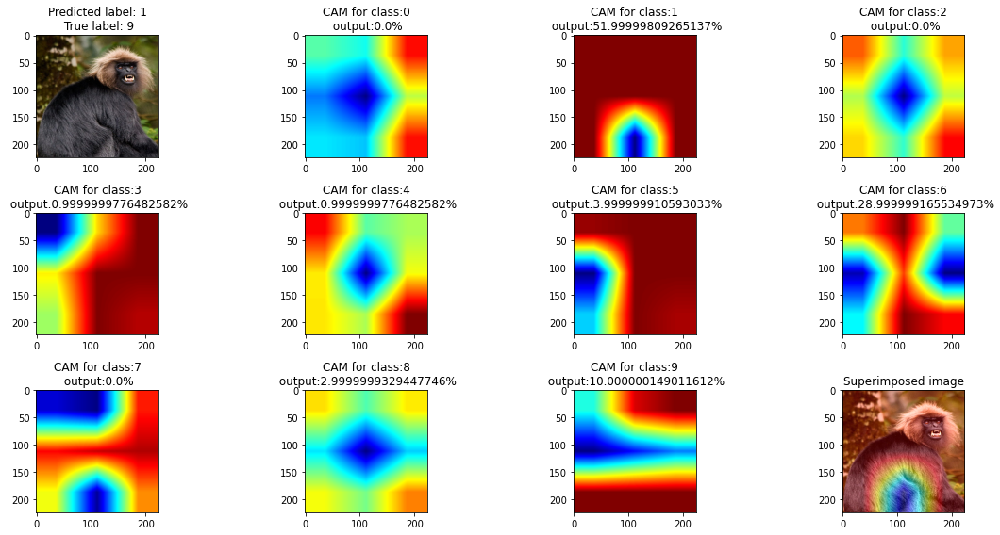

In [ ]:
plt.rcParams["figure.figsize"]=[20,8]
from keras import backend as K


plt.rcParams["figure.figsize"]=[16,8]
for i in range(10):
  # get random image, true label, and predicted label
  idx= np.random.randint(100) # <- random number
  #true_label=valid_df.iloc[idx]['label']
  true_label = valid_df.iloc[monkey_examples[i]]["label"]


  ####### VISUALIZACIÓN INPUT
  sample_image = cv2.imread(valid_df.iloc[monkey_examples[i]]['image']) #read image from validation set
  # sample_image = cv2.imread(valid_df.iloc[idx]['image'])
  sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)
  sample_image = cv2.resize(sample_image, (img_rows, img_cols))
  sample_label = valid_df.iloc[monkey_examples[i]]["label"]
  #sample_label = valid_df.iloc[idx]["label"]
  sample_image_processed = np.expand_dims(sample_image, axis=0)
  sample_image_processed = preprocess_input(sample_image_processed)
  predicted_label=np.argmax(res_mod.predict(sample_image_processed), axis=-1)[0]
  plt.subplot(3,4,1)
  plt.title("Predicted label: "+str(predicted_label)+"\n True label: "+str(true_label))
  plt.imshow(sample_image)# <- Image is ready to plot

  ##### Visualización CAM
  heatmaps=[]
  kk=0
  predicted_label=np.argmax(res_mod.predict(sample_image_processed), axis=-1)[0] #repeated for clearness
  print(np.argmax(res_mod.predict(sample_image_processed), axis=-1))
  #for k in [0,predicted_label]:
  for k in range(10):
    predicted_output = res_mod.output[:, k]
    # choose the last conv layer in your model
    last_conv_layer = res_mod.get_layer('conv2d_13') #<....... you'll need to look what's the name of the last conv model.summary())
    grads = K.gradients(predicted_output, last_conv_layer.output)[0] #predicted output=loss, last_conv_layer=input al gradiente, ¿qué calculará el gradiente entonces?
    # take mean gradient per feature map
    grads = K.mean(grads, axis=(0,1,2))
    # Define a function that generates the values for the output and gradients
    evaluation_function = K.function([res_mod.input], [grads, last_conv_layer.output[0]]) #en eager executions disabled estamos trabajando con tensores continuamente, 
                                                                                        # si siguen el código se darán cuenta que evaluation function mantiene 
                                                                                        # las definiciones de variables
    # get the values
    grads_values, conv_ouput_values = evaluation_function([sample_image_processed]) #run evaluation function
    # iterate over each feature map in yout conv output and multiply
    # the gradient values with the conv output values. This gives an 
    # indication of "how important a feature is"
    for i in range(conv_ouput_values.shape[-1]): # we have 512 features in our last conv layer
        conv_ouput_values[:,:,i] *= grads_values[i]
    # create a heatmap
    heatmap = np.mean(conv_ouput_values, axis=-1)
    # remove negative values
    heatmap = np.maximum(heatmap, 0)
    # re-scale
    heatmap /= heatmap.max()
    # get the heatmap for class activation map(CAM)
    heatmap = cv2.resize(heatmap, (sample_image.shape[0], sample_image.shape[1]))
    heatmap = heatmap *255
    heatmap = np.clip(heatmap, 0, 255).astype(np.uint8)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    plt.subplot(3,4,2+kk)
    plt.title("CAM for class:"+ str(k)+"\n output:"+str(np.round(res_mod.predict(sample_image_processed)[0,k],2)*100)+"%")
    plt.imshow(heatmap)# <- Image is ready to plot
    kk+=1
    heatmaps.append(heatmap) # <- correct it
  # get the superimposed image
  super_imposed_image = heatmaps[predicted_label] * 0.5 + sample_image #<- correct it  
  super_imposed_image = np.clip(super_imposed_image, 0,255).astype(np.uint8)
  plt.subplot(3,4,12)
  plt.title("Superimposed image")
  plt.imshow(super_imposed_image)# <- Image is ready to plot
  plt.tight_layout()
  plt.show()

##### IV) Visualice los feature maps de **todas** las capas convolucionales del modelo para una entrada de su elección (mantenga el id de esta imágen para cuando tenga que visualizar nuevamente en 3.c y 3.d). Apóyese en el siguiente código que las genera para la primera capa. 

**Pregunta:** ¿Cómo se relaciona esta información respecto a lo que nos entrega CAM? ¿Qué feature map ocupa CAM para construirse?

In [ ]:
idx= 84 # <- random number
true_label=valid_df.iloc[idx]['label']
####### VISUALIZACIÓN INPUT
sample_image = cv2.imread(valid_df.iloc[idx]['image'])
sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)
sample_image = cv2.resize(sample_image, (img_rows, img_cols))
sample_label = valid_df.iloc[idx]["label"]
sample_image_processed = np.expand_dims(sample_image, axis=0)
sample_image_processed = preprocess_input(sample_image_processed)

from keras.models import Sequential
res_mod.summary()

def get_n_layers2(max_layer, original_model):
  max_layer-=1
  Input = original_model.get_layer(index=0).output
  Output = original_model.get_layer(index=max_layer).output
  new_mod = tf.keras.models.Model(Input,Output)
  new_mod.summary()
  return new_mod


Model: "functional_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 224, 224, 64) 1792        input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 224, 224, 64) 256         conv2d[0][0]                     
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 224, 224, 64) 36928       batch_normalization[0][0]        
_______________________________________________________________________________________

In [ ]:
conv_layers = [2,4,8,10,14,16,20,22,26,28,32,34,38,40]
layer_size = 224
all_f_maps = []

res_mod.get_layer(index = 6)

for n in conv_layers:
  print(layer_size)

  vis_model = get_n_layers2(n, res_mod)
  fet_maps_stacked=vis_model.predict(sample_image_processed)[0,:,:,:]
  feature_maps=np.zeros((layer_size*8,layer_size*8))
  k=0
  for i in range(8):
    for j in range(8):
        feature_map = fet_maps_stacked[:,:,k]
        feature_map -= feature_map.mean()
        feature_map /= feature_map.std()
        feature_map *=255
        feature_map = np.clip(feature_map, 0, 255).astype(np.uint8)
        feature_maps[layer_size*i:layer_size*(i+1),layer_size*j:layer_size*(j+1)]=feature_map
        k+=1
  all_f_maps.append(feature_maps)
  if n == 4 or n == 10 or n == 16 or n == 22 or n == 28 or n == 34:
    layer_size //= 2

224
Model: "functional_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
conv2d (Conv2D)              (None, 224, 224, 64)      1792      
Total params: 1,792
Trainable params: 1,792
Non-trainable params: 0
_________________________________________________________________
224
Model: "functional_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
conv2d (Conv2D)              (None, 224, 224, 64)      1792      
_________________________________________________________________
batch_normalization (BatchNo (None, 224, 224, 64)      256       
______________________

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: invalid value encountered in true_divide


14
Model: "functional_21"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 224, 224, 64) 1792        input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 224, 224, 64) 256         conv2d[0][0]                     
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 224, 224, 64) 36928       batch_normalization[0][0]        
___________________________________________________________________________________

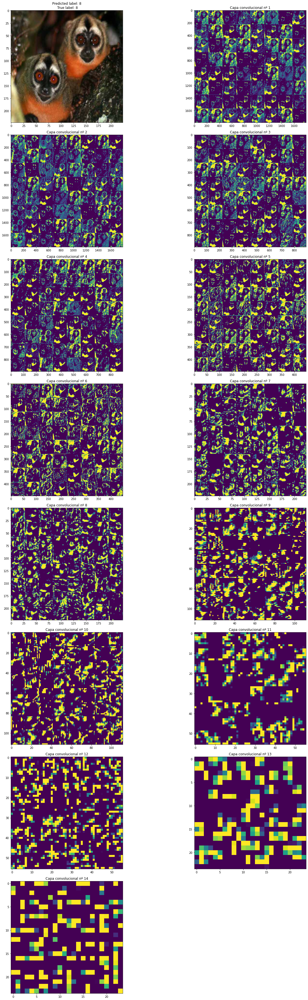

In [ ]:

plt.rcParams["figure.figsize"]=[20,50]
plt.subplot(8,2,1)
plt.title("Predicted label: "+str(np.argmax(res_mod.predict(sample_image_processed), axis=-1)[0])+"\n True label: "+str(true_label))
plt.imshow(sample_image)# <- Image is ready to plot
for i in range(len(all_f_maps)):

  plt.subplot(8,2,2+i)
  plt.imshow(all_f_maps[i])
  plt.title("Capa convolucional nº " + str(i+1))
plt.tight_layout()
plt.show()

* ¿Cómo se relaciona esta información respecto a lo que nos entrega CAM?

Esta información corresponde al proceso de extracción de características por la CNN en cada capa, hasta llegar a la última, que es la que ocupará CAM para realizar los mapas de calor.

* ¿Qué feature map ocupa CAM para construirse?

Ocupa los feature map de la última capa, "conv2d_13". Estos se multiplican por el peso asociado a este y se suman, obteniendo así una grilla  de números que seria nuestro mapa de calor.


* Se destaca el hecho de que existen regiones mucho más grandes por cada feature map. Esto es debido a que se ocuparon más capas de pooling que en las redes anteriores, por lo que son más pequeños. Esto podría llevar a que se perdiese información pero el hecho de tener skip connections y poder llevar a la última capa información de las anteriores debería ayudar a que esto no repercutiese de forma tan negativa.

* Además, en los feature map de la primera capa convolucional se puede ver que extraen muchas más características en general de la imagen en comparación con los modelos anteriores, donde se ve una extracción de características más centradas en el animal que en el ambiente.